In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from astropy.io import fits
import os
import pandas as pd
import matplotlib.pyplot as plt
from astropy.io import fits
import numpy as np # Import numpy for float64

J010619.24+004823.3
4.4402
J012403.77+004432.7
3.8359
J013340.31+040059.7
4.1709
J013724.36-422417.3
3.975
J015741.56-010629.6
3.5645
J020944.61+051713.6
4.1846
J024401.84-013403.7
4.044
J033413.42-161205.4
4.38
J033900.98-013317.7
3.204
J094932.26+033531.7
4.1072
J095852.19+120245.0
3.2746
J102009.99+104002.7
3.1528
J111008.61+024458.0
4.1582
J111113.79-080402.0
3.93
J120917.93+113830.3
3.0836
J123055.57-113909.3
3.557
J124957.23-015928.8
3.6337
J133254.51+005250.6
3.5071
J142438.10+225600.7
3.634
J162116.92-004250.8
3.71
J193957.25-100241.5
3.787
J200324.14-325144.8
3.785
J205344.72-354655.2
3.49
J221527.29-161133.0
4.0
J230301.45-093930.7
3.4774
J231543.56+145606.4
3.3971
J233446.40-090812.2
3.3261
J234913.75-371259.2
4.24


(-0.75, 1.75)

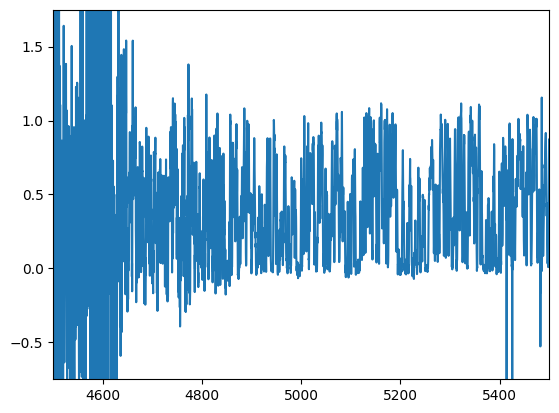

In [3]:
from astropy.io import fits
import os
import pandas as pd
import matplotlib.pyplot as plt
from astropy.io import fits
import numpy as np # Import numpy for float64

# Re-open the FITS file to access the data, as the previous 'with' block would have closed it
file_path = '/content/drive/MyDrive/Hos/Hos4/MAGG_LAEs.fits'
file_path2 = '/content/drive/MyDrive/Hos/Hos4/MAGG_spectra_merged.fits'
#open the file
qsolist=fits.open(file_path2)
num_qso=len(qsolist)-1
for exx in range(num_qso):
#print filed name and quasar redshift
  print(qsolist[exx+1].header['FIELD'])
  print(qsolist[exx+1].header['z_QSO'])
#plot the spectrum 0
plt.figure()
plt.plot(qsolist[1].data['wave'],qsolist[1].data['flux'])
plt.xlim(4500, 5500) # Imposta i limiti dell'asse x tra 3100 e 4750
plt.ylim(-0.75, 1.75) # Imposta i limiti dell'asse y tra -0.75 e 1.75

#The LAEs data are provided in the table MAGG_LAEs.fits that contains the following columns:
# FIELD: The name of the quasar field matched to the spectra extension in the file above.
# z: The measured redshift of the LAE.
# z_corr: The systemic redshift of the LAE once corrected for the Lyα resonant effects.
# RA_deg,DEC_deg: The LAE coordinates in degrees.
# R_kpc: The impact parameter, in kpc.
# Lum,LumErr: The LAE luminosity in erg/s, plus its error.


### Headers for MAGG_LAEs.fits

In [4]:
with fits.open(file_path) as hdul_lae:
    print(f"Headers for {file_path}:")
    for i, hdu in enumerate(hdul_lae):
        print(f"\n--- HDU {i} ---")
        print(hdu.header)

Headers for /content/drive/MyDrive/Hos/Hos4/MAGG_LAEs.fits:

--- HDU 0 ---
SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                    8 / array data type                                NAXIS   =                    0 / number of array dimensions                     EXTEND  =                    T                                                  END                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

### Headers for MAGG_spectra_merged.fits

In [5]:
with fits.open(file_path2) as hdul_spectra:
    print(f"Headers for {file_path2}:")
    for i, hdu in enumerate(hdul_spectra):
        print(f"\n--- HDU {i} ---")
        print(hdu.header)

Headers for /content/drive/MyDrive/Hos/Hos4/MAGG_spectra_merged.fits:

--- HDU 0 ---
SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                    8 / array data type                                NAXIS   =                    0 / number of array dimensions                     EXTEND  =                    T                                                  END                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                

(array([194., 294., 171.,  95.,  57.,  37.,  24.,  10.,   7.,   4.,   5.,
          2.,   4.,   3.,   1.,   2.,   0.,   0.,   1.,   1.]),
 array([9.22100157e+40, 8.09569819e+41, 1.52692962e+42, 2.24428943e+42,
        2.96164923e+42, 3.67900903e+42, 4.39636883e+42, 5.11372864e+42,
        5.83108844e+42, 6.54844824e+42, 7.26580805e+42, 7.98316785e+42,
        8.70052765e+42, 9.41788746e+42, 1.01352473e+43, 1.08526071e+43,
        1.15699669e+43, 1.22873267e+43, 1.30046865e+43, 1.37220463e+43,
        1.44394061e+43]),
 <BarContainer object of 20 artists>)

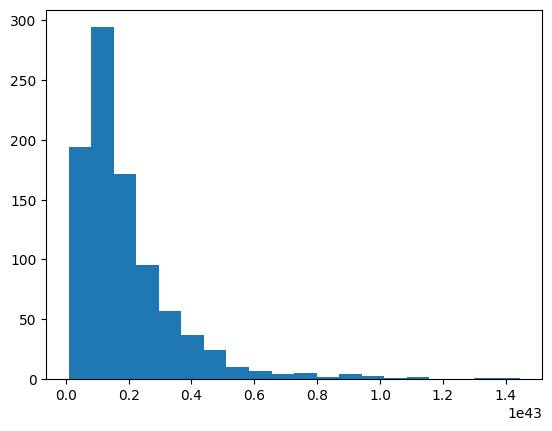

In [6]:
from astropy.table import Table
lae = Table.read(file_path)
plt.figure()
plt.hist(lae['Lum'],bins=20)

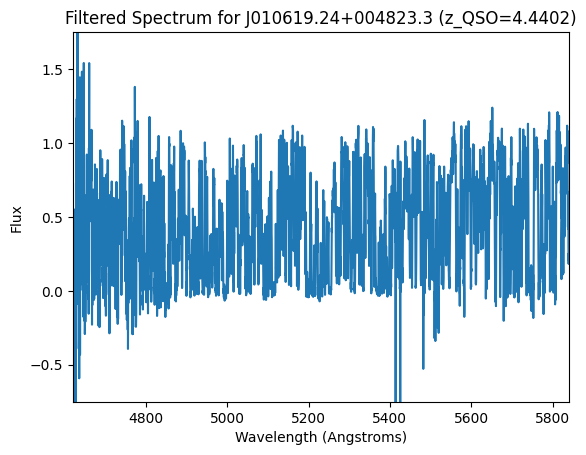

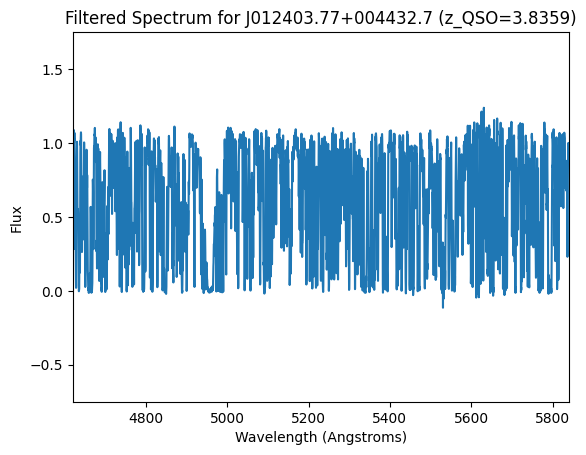

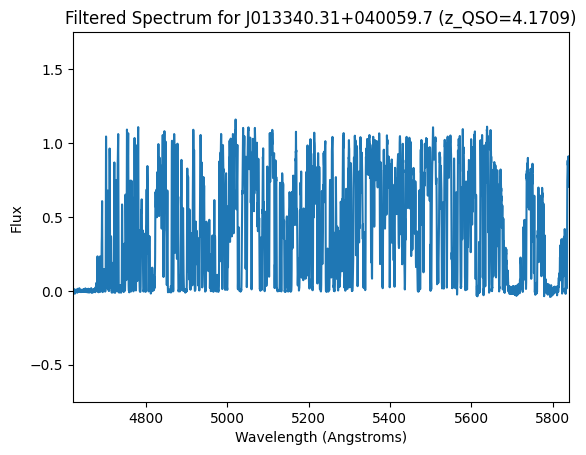

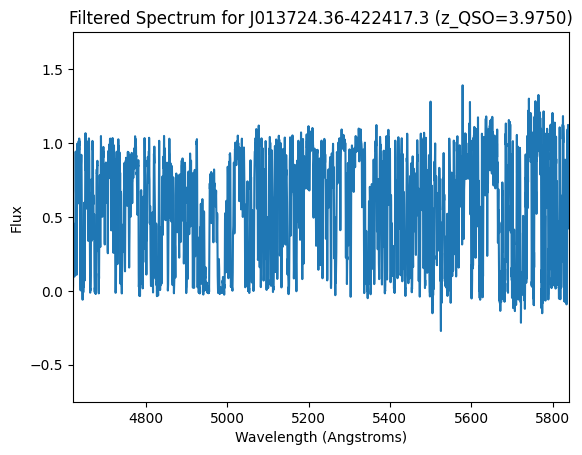

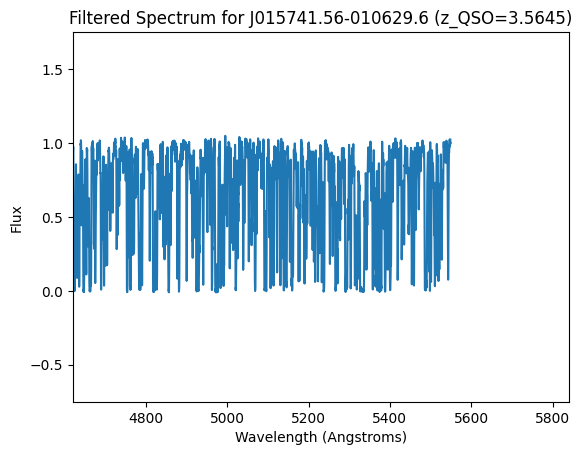

...

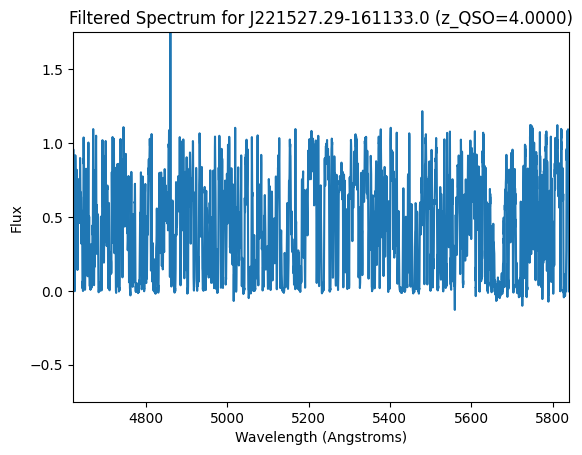

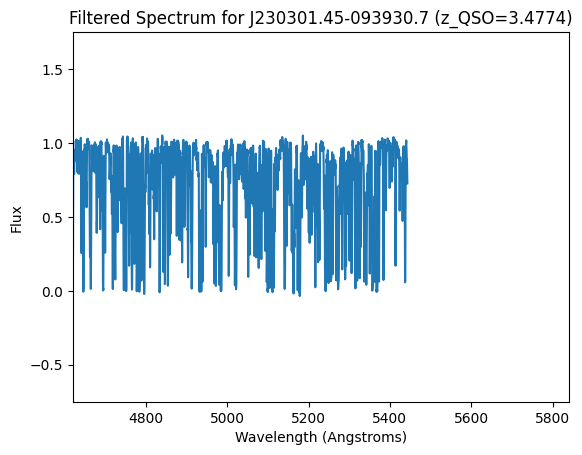

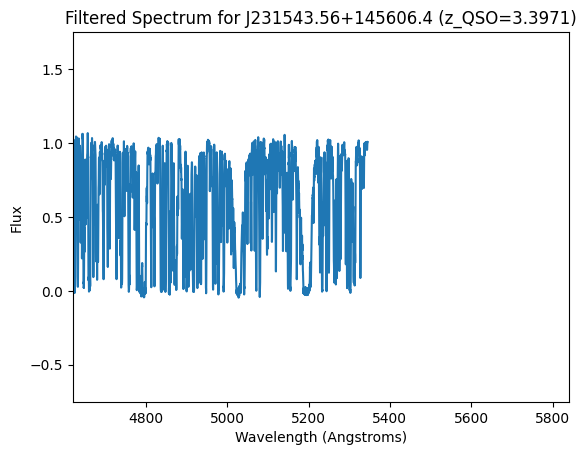

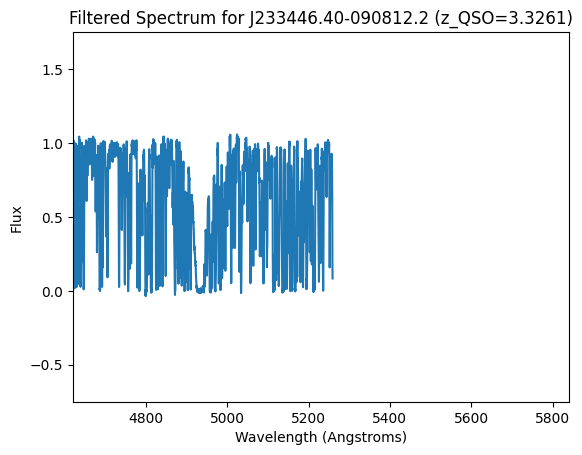

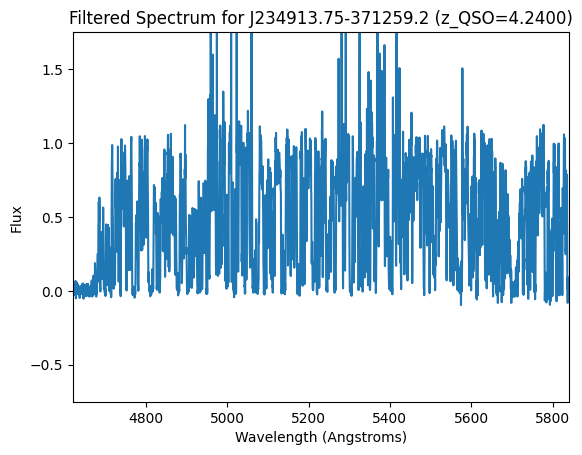

In [8]:
for exx in range(1, num_qso + 1):
    # Retrieve redshift (z_QSO) for the current quasar
    z_qso = qsolist[exx].header['z_QSO']

    # Calculate the Ly̑ cutoff wavelength
    lya_cutoff = 1215.67 * (1 + z_qso)

    # Access 'wave' and 'flux' data
    wave_data = qsolist[exx].data['wave']
    flux_data = qsolist[exx].data['flux']

    # Create a boolean mask for wavelengths bluer than the cutoff
    mask_bluer = wave_data < lya_cutoff

    # Apply the mask to filter wave and flux data
    filtered_wave = wave_data[mask_bluer]
    filtered_flux = flux_data[mask_bluer]

    # Create a new plot for the filtered spectrum
    plt.figure()
    plt.plot(filtered_wave, filtered_flux)
    plt.xlim(4620, 5840) # Set x-axis limits
    plt.ylim(-0.75, 1.75) # Set y-axis limits
    plt.xlabel('Wavelength (Angstroms)')
    plt.ylabel('Flux')
    plt.title(f"Filtered Spectrum for {qsolist[exx].header['FIELD']} (z_QSO={z_qso:.4f})")
    plt.show()

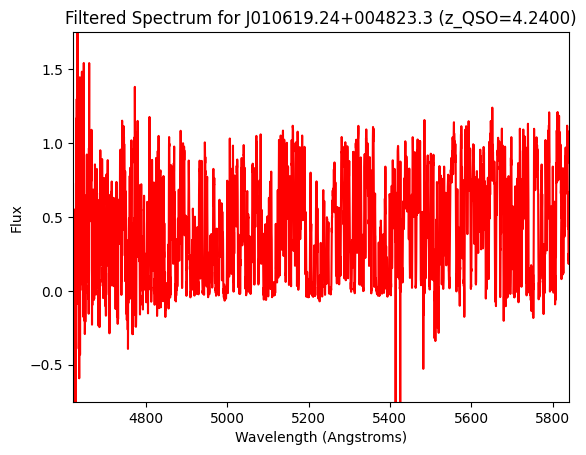

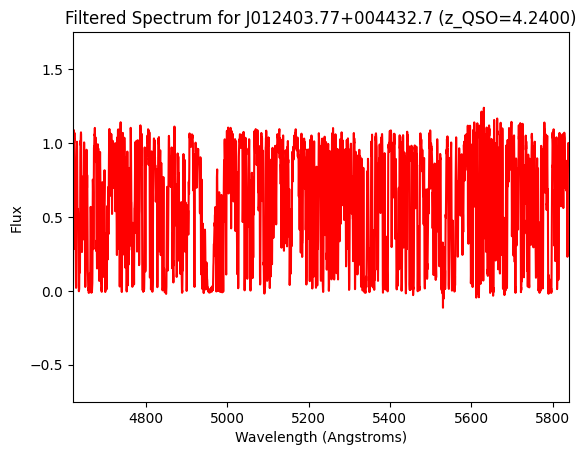

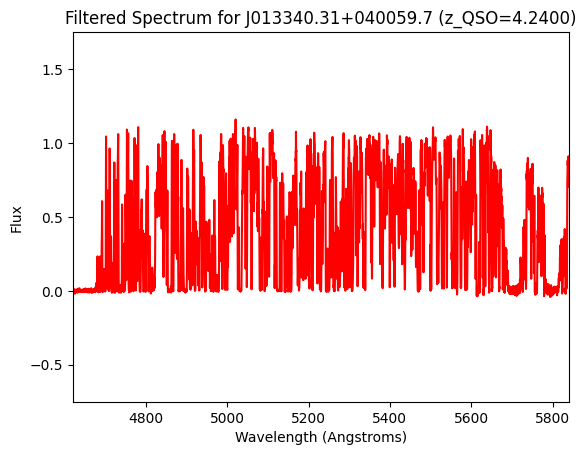

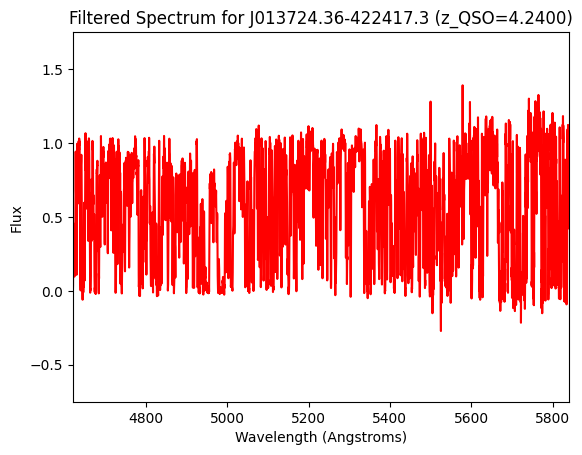

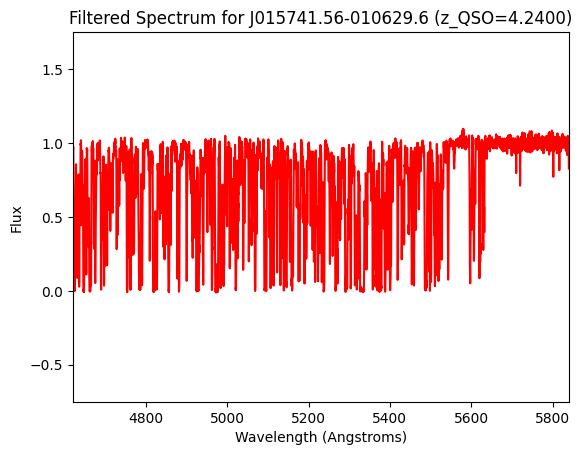

...

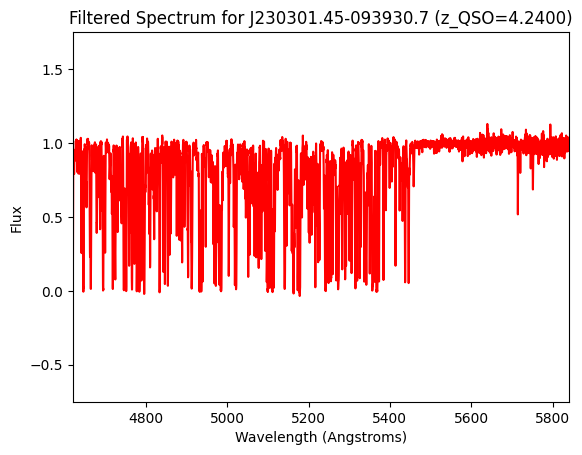

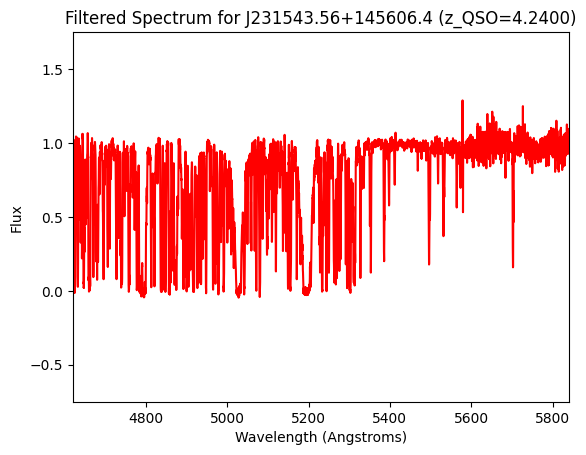

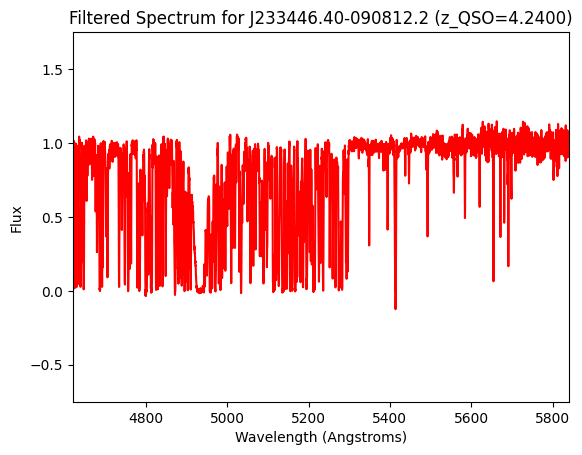

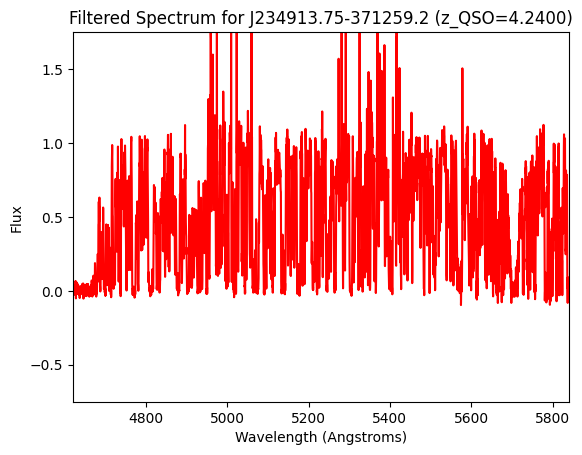

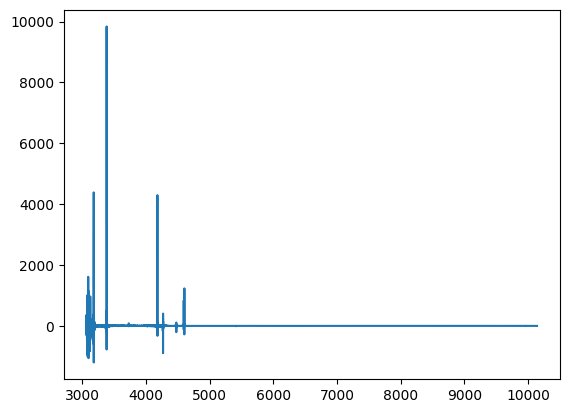

In [9]:
for exx in range(1, num_qso + 1):

    plt.figure()
    plt.plot(qsolist[exx].data['wave'],qsolist[exx].data['flux'], color ='red')
    plt.xlim(4620, 5840) # Set x-axis limits
    plt.ylim(-0.75, 1.75) # Set y-axis limits
    plt.xlabel('Wavelength (Angstroms)')
    plt.ylabel('Flux')
    plt.title(f"Filtered Spectrum for {qsolist[exx].header['FIELD']} (z_QSO={z_qso:.4f})")
    plt.show()

plt.plot(qsolist[1].data['wave'],qsolist[1].data['flux'])

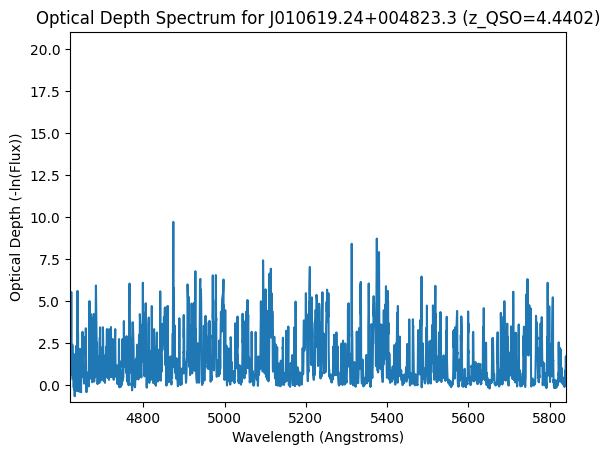

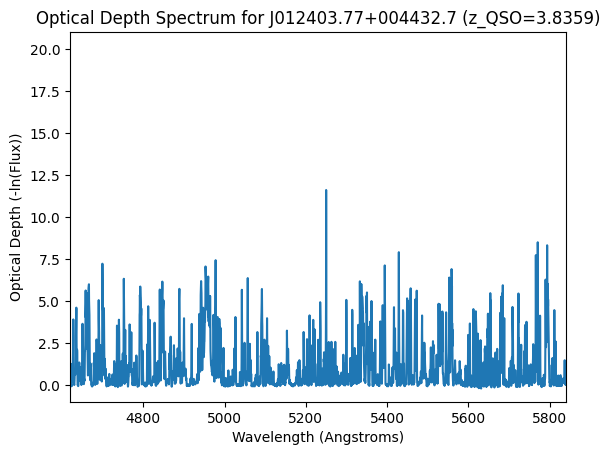

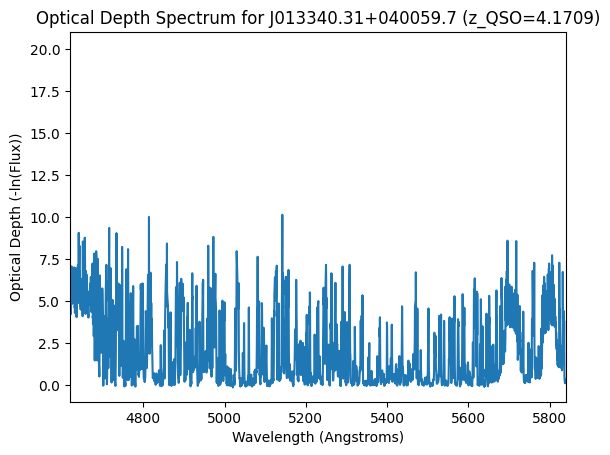

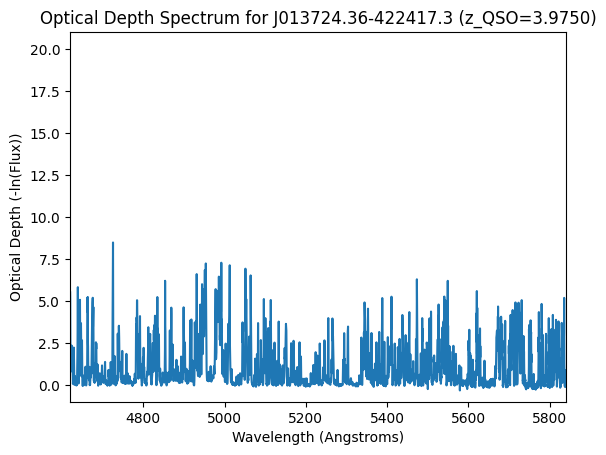

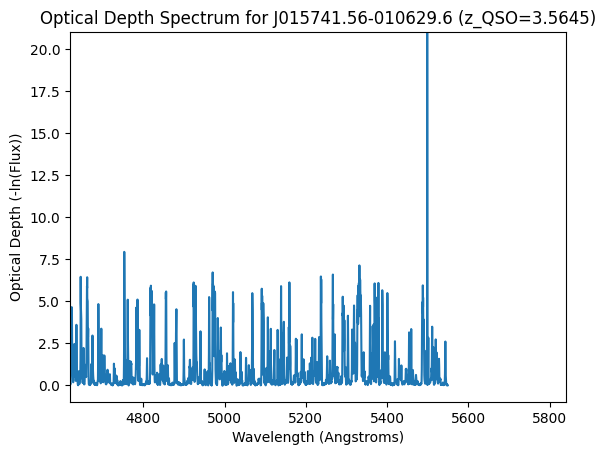

...

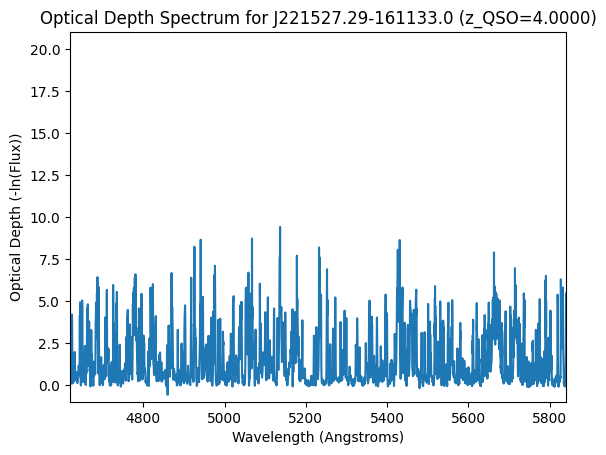

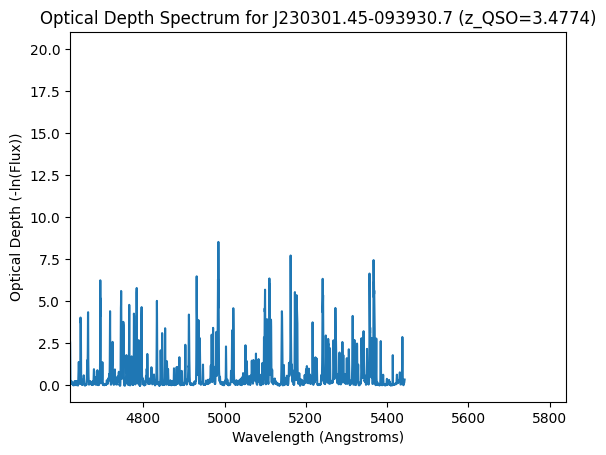

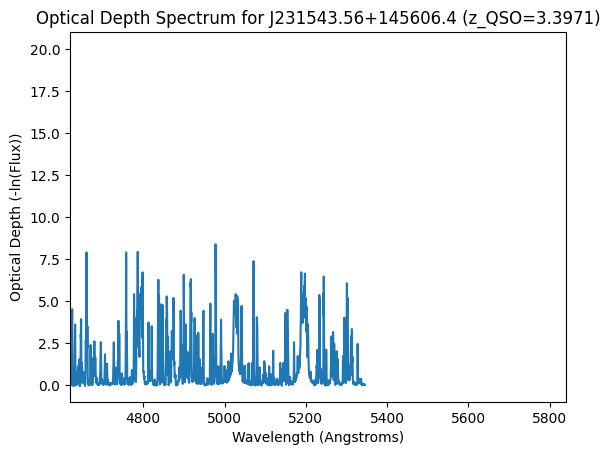

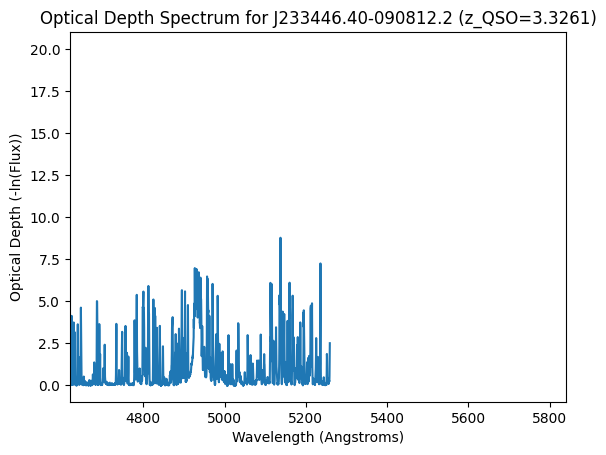

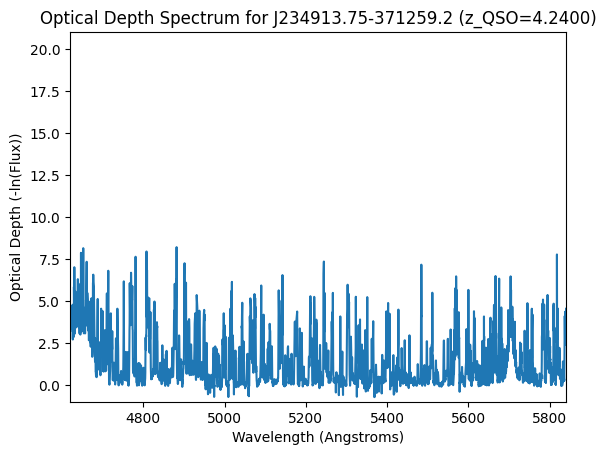

In [10]:
for exx in range(1, num_qso + 1):
    # Retrieve redshift (z_QSO) for the current quasar
    z_qso = qsolist[exx].header['z_QSO']

    # Calculate the Lyα cutoff wavelength
    lya_cutoff = 1215.67 * (1 + z_qso)

    # Access 'wave' and 'flux' data
    wave_data = qsolist[exx].data['wave']
    flux_data = qsolist[exx].data['flux']

    # Create a boolean mask for wavelengths bluer than the cutoff
    mask_bluer = wave_data < lya_cutoff

    # Apply the mask to filter wave and flux data initially
    filtered_wave_pre = wave_data[mask_bluer]
    filtered_flux_pre = flux_data[mask_bluer]

    # Create a new mask for flux values > 0 to calculate optical depth
    mask_positive_flux = filtered_flux_pre > 0

    # Apply the positive flux mask
    final_wave = filtered_wave_pre[mask_positive_flux]
    final_flux = filtered_flux_pre[mask_positive_flux]

    # Calculate optical depth (-ln(flux))
    # Ensure final_flux is not empty before attempting calculation
    if len(final_flux) > 0:
        optical_depth = -np.log(final_flux)

        # Create a new plot for the optical depth spectrum
        plt.figure()
        plt.plot(final_wave, optical_depth)
        plt.xlim(4620, 5840) # Set x-axis limits
        plt.ylim(-1, 21) # Set y-axis limits for optical depth
        plt.xlabel('Wavelength (Angstroms)')
        plt.ylabel('Optical Depth (-ln(Flux))')
        plt.title(f"Optical Depth Spectrum for {qsolist[exx].header['FIELD']} (z_QSO={z_qso:.4f})")
        plt.show()
    else:
        print(f"No positive flux values found for {qsolist[exx].header['FIELD']} after filtering. Skipping plot.")


In [15]:
lae_df = lae.to_pandas()
print("LAE data successfully converted to pandas DataFrame.")
print(lae_df.head())

LAE data successfully converted to pandas DataFrame.
                    FIELD         z    z_corr     RA_deg   DEC_deg  \
0  b'J010619.24+004823.3'  2.926344  2.923070  16.578812  0.811817   
1  b'J010619.24+004823.3'  3.108238  3.104812  16.583417  0.804189   
2  b'J010619.24+004823.3'  3.121350  3.117913  16.586004  0.800117   
3  b'J010619.24+004823.3'  3.208086  3.204576  16.583433  0.807494   
4  b'J010619.24+004823.3'  3.211177  3.207665  16.578192  0.801106   

        R_kpc           Lum        LumErr  
0  157.050184  4.172145e+41  7.945312e+40  
1  112.409150  1.944295e+42  1.009701e+41  
2  242.952498  4.236641e+41  9.639747e+40  
3   95.605659  1.078338e+42  8.957600e+40  
4  159.308517  1.474144e+42  1.508709e+41  



--- Quasar: J010619.24+004823.3 (z_QSO=4.4402) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9231   | 7.3050 | 157.05 | 876920.93
3.1048   | 6.2552 | 112.41 | 931443.67
3.1179   | 5.7997 | 242.95 | 935373.94
3.2046   | 4.1021 | 95.61 | 961372.93
3.2077   | 3.9886 | 159.31 | 962299.52
3.2212   | 3.5047 | 198.48 | 966353.09
3.2718   | 5.4639 | 209.95 | 981541.42
3.3231   | 6.1554 | 198.49 | 996927.58
3.3236   | 6.0434 | 214.62 | 997092.44
3.3240   | 6.0459 | 107.97 | 997197.35
3.4276   | 5.4786 | 189.51 | 1028265.80
3.4378   | 5.4981 | 82.85 | 1031351.07
3.4368   | 5.4960 | 161.43 | 1031043.42
3.4399   | 5.3395 | 121.12 | 1031976.47
3.5220   | 2.5932 | 215.78 | 1056609.13
3.5267   | 2.7114 | 139.33 | 1058016.87
3.6795   | 4.3460 | 209.52 | 1103854.33
3.6987   | 5.4247 | 195.63 | 1109602.04
3.7276   | 5.5732 | 9.13 | 1118266.31
3.7648   | 4.4243 | 76.16 | 1129451.86
3.7752   | 4.8258 | 227.

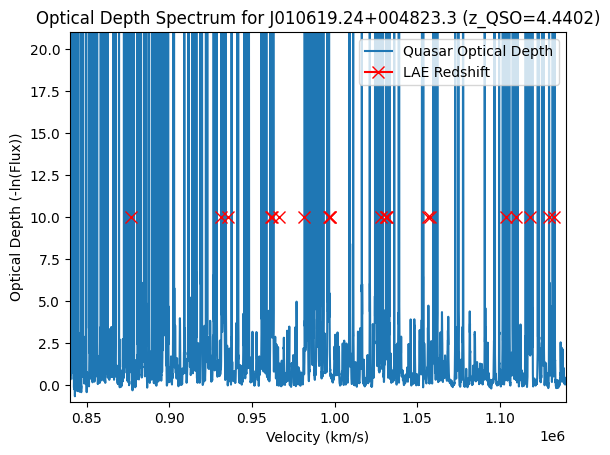


--- Quasar: J012403.77+004432.7 (z_QSO=3.8359) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8339   | 2.5095 | 241.55 | 850173.14
3.0783   | 4.3296 | 208.42 | 923497.86
3.1045   | 4.2657 | 30.22 | 931335.72
3.1869   | 0.9664 | 137.50 | 956075.55
3.3940   | 2.3308 | 199.53 | 1018204.80
3.3925   | 2.3364 | 74.97 | 1017753.04
3.4649   | 1.7942 | 67.93 | 1039464.36
3.4911   | 1.3398 | 102.54 | 1047343.22
3.5471   | 1.8795 | 227.13 | 1064136.76
3.5482   | 1.8600 | 152.03 | 1064445.80


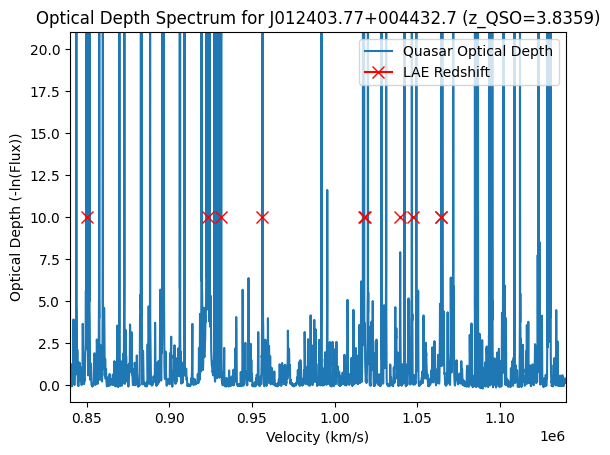


--- Quasar: J013340.31+040059.7 (z_QSO=4.1709) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9918   | 6.5478 | 97.04 | 897547.46
3.0771   | 4.6302 | 154.50 | 923121.77
3.1388   | 3.4434 | 214.89 | 941627.11
3.1888   | 3.6280 | 254.89 | 956652.93
3.2837   | 3.3431 | 208.48 | 985105.74
3.3001   | 2.7671 | 228.09 | 990037.52
3.3288   | 3.1128 | 50.55 | 998647.91
3.5383   | 1.6523 | 166.40 | 1061478.36
3.5954   | 2.6569 | 40.44 | 1078618.40
3.6923   | 8.1656 | 141.12 | 1107688.13


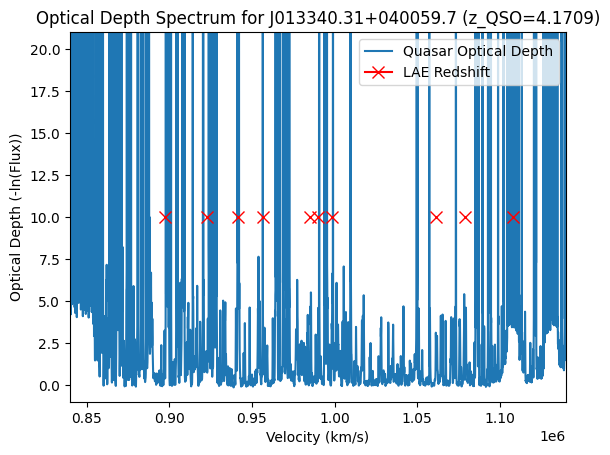


--- Quasar: J013724.36-422417.3 (z_QSO=3.9750) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8865   | 2.2225 | 268.15 | 865938.11
3.0000   | 2.1815 | 195.06 | 900014.38
3.0609   | 4.6758 | 217.72 | 918260.63
3.0726   | 4.7721 | 148.45 | 921781.24
3.0748   | 4.8474 | 249.05 | 922451.73
3.0876   | 4.6050 | 229.99 | 926270.55
3.1217   | 4.1889 | 129.19 | 936524.67
3.1278   | 3.5260 | 202.91 | 938342.70
3.1524   | 2.0785 | 149.08 | 945734.20
3.1556   | 2.1293 | 44.85 | 946672.58
3.1549   | 2.0135 | 120.96 | 946472.90
3.1670   | 1.5911 | 137.78 | 950096.89
3.1659   | 1.5971 | 91.10 | 949760.47
3.1660   | 1.5971 | 103.80 | 949785.95
3.3216   | 0.7202 | 171.20 | 996483.67
3.4411   | 2.6350 | 214.82 | 1032332.98
3.5203   | 3.3535 | 42.01 | 1056081.71
3.5448   | 2.7201 | 293.61 | 1063445.06
3.5477   | 2.6824 | 265.55 | 1064316.38
3.5544   | 2.3836 | 218.19 | 1066312.80
3.5615   | 2.6012 | 116.91 

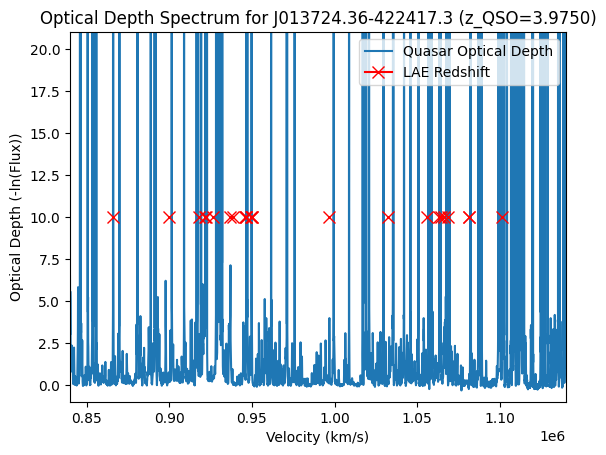


--- Quasar: J015741.56-010629.6 (z_QSO=3.5645) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8365   | 1.6755 | 136.90 | 850964.40
2.9632   | 1.2428 | 45.05 | 888945.70
2.9646   | 1.2445 | 132.04 | 889383.33
3.0894   | 1.7555 | 109.23 | 926832.84
3.1684   | 0.8911 | 139.82 | 950514.46
3.2588   | 0.8405 | 203.13 | 977648.82
3.3586   | 2.4527 | 128.37 | 1007568.70
3.3710   | 2.6151 | 183.71 | 1011306.58
3.3738   | 2.7445 | 189.24 | 1012149.45
3.3890   | 2.8332 | 133.45 | 1016711.06
3.3875   | 2.8257 | 206.80 | 1016252.45
3.3886   | 2.8284 | 103.76 | 1016573.18
3.3883   | 2.8292 | 30.86 | 1016492.25
3.3886   | 2.8331 | 79.05 | 1016576.18
3.5230   | 0.7140 | 76.63 | 1056905.42
3.5404   | 0.7722 | 161.19 | 1062126.56


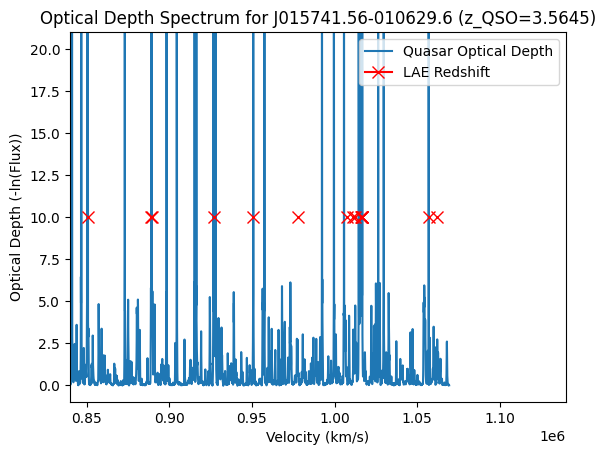


--- Quasar: J020944.61+051713.6 (z_QSO=4.1846) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8329   | 5.7479 | 96.49 | 849885.00
2.9305   | 4.6504 | 211.77 | 879152.51
3.1052   | 1.9543 | 142.17 | 931549.81
3.1698   | 1.8356 | 212.20 | 950943.61
3.2456   | 2.3656 | 185.39 | 973675.97
3.2570   | 2.4615 | 189.82 | 977101.52
3.4396   | 1.0343 | 172.76 | 1031869.11
3.7085   | 7.2670 | 128.81 | 1112544.08


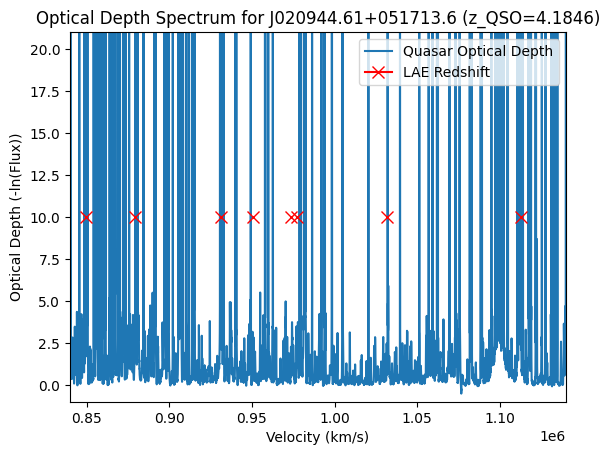


--- Quasar: J024401.84-013403.7 (z_QSO=4.0440) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8557   | 4.0406 | 114.79 | 856722.89
3.1188   | 2.3205 | 203.43 | 935642.93
3.1225   | 2.1866 | 95.08 | 936737.81
3.1353   | 2.1603 | 216.91 | 940582.53
3.1353   | 2.1560 | 195.69 | 940588.75
3.3470   | 1.6347 | 213.58 | 1004090.06
3.3963   | 1.3310 | 94.32 | 1018879.97
3.4076   | 1.3258 | 254.39 | 1022268.42
3.4085   | 1.3252 | 215.77 | 1022556.19
3.4323   | 1.7539 | 181.57 | 1029679.31
3.5937   | 2.9704 | 212.59 | 1078107.02
3.6111   | 3.8465 | 161.80 | 1083327.47
3.6162   | 3.8264 | 105.92 | 1084859.53
3.6388   | 4.3848 | 24.62 | 1091654.36
3.6450   | 4.5475 | 166.96 | 1093491.06
3.7357   | 2.9477 | 200.73 | 1120724.25
3.7333   | 3.0536 | 221.92 | 1120004.69
3.7478   | 2.8011 | 119.58 | 1124331.31


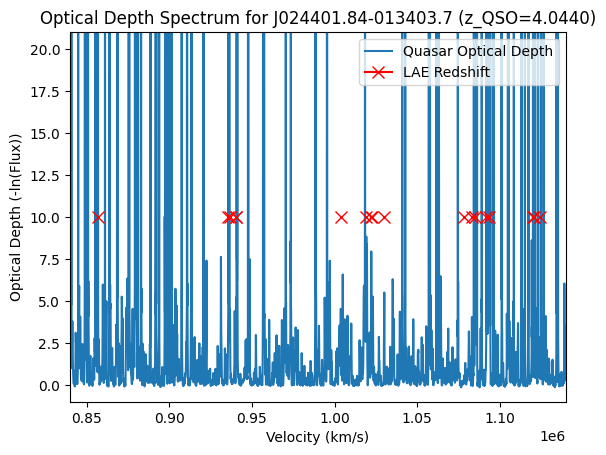


--- Quasar: J033413.42-161205.4 (z_QSO=4.3800) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8599   | 21.5517 | 229.17 | 857963.56
2.8844   | 19.9793 | 197.65 | 865307.43
2.8849   | 20.0831 | 234.12 | 865472.29
2.9273   | 18.2825 | 213.19 | 878178.68
2.9258   | 18.4217 | 122.48 | 877747.04
2.9279   | 18.1553 | 76.77 | 878358.53
3.0533   | 5.9499 | 78.03 | 915986.13
3.0960   | 5.3649 | 210.57 | 928799.57
3.1606   | 7.0646 | 184.58 | 948179.26
3.2356   | 6.8973 | 194.65 | 970694.97
3.2942   | 4.8076 | 101.16 | 988252.82
3.3889   | 4.5155 | 222.51 | 1016658.88
3.5750   | 8.0049 | 167.73 | 1072488.51
3.5698   | 8.2037 | 217.41 | 1070932.81
3.6075   | 4.6310 | 175.56 | 1082249.68
3.7597   | 2.7046 | 194.67 | 1127905.66


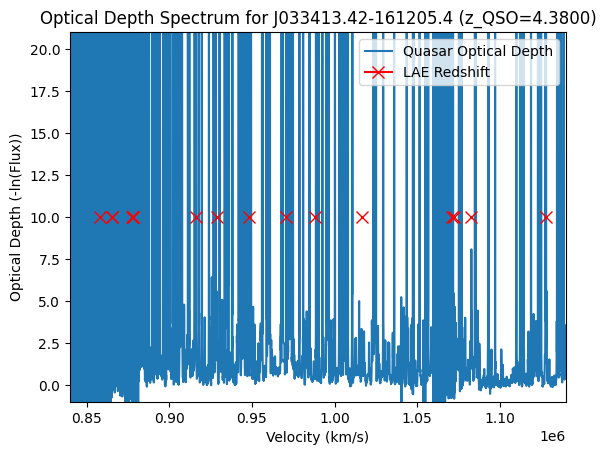


--- Quasar: J033900.98-013317.7 (z_QSO=3.2040) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8095   | 2.6003 | 66.99 | 842859.16
2.8350   | 3.6350 | 182.45 | 850493.65
2.8348   | 3.6335 | 250.04 | 850436.84
3.0413   | 7.1710 | 184.77 | 912385.88
3.0757   | 8.8215 | 224.37 | 922710.23
3.0845   | 8.5467 | 134.41 | 925353.31
3.1914   | 0.4536 | 186.44 | 957423.55
3.2035   | 0.3735 | 185.65 | 961047.52
3.2022   | 0.3646 | 181.68 | 960645.13
3.2008   | 0.3574 | 229.24 | 960225.12
3.1990   | 0.3581 | 205.76 | 959705.15
3.2028   | 0.3691 | 262.17 | 960850.89


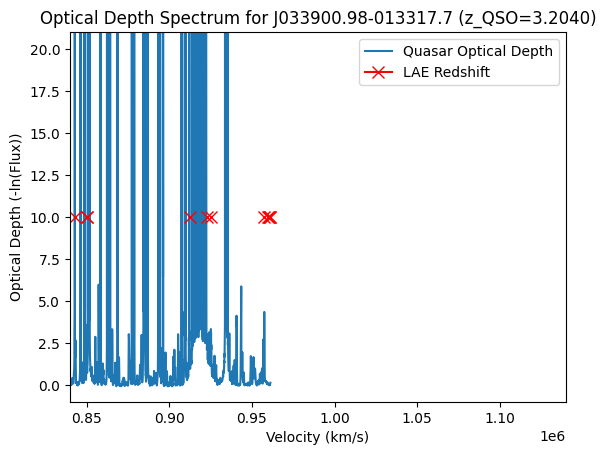


--- Quasar: J094932.26+033531.7 (z_QSO=4.1072) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8024   | 2.6951 | 187.45 | 840709.93
3.4118   | 1.1535 | 247.24 | 1023530.37
3.5476   | 1.3464 | 189.26 | 1064266.37
3.5948   | 2.6261 | 235.46 | 1078434.65
3.6360   | 2.7364 | 35.43 | 1090797.55


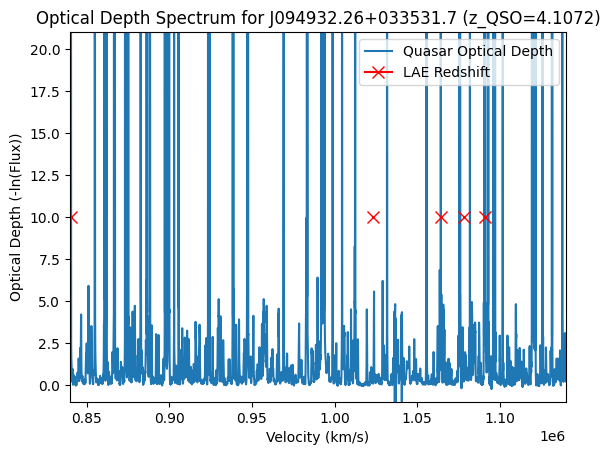


--- Quasar: J095852.19+120245.0 (z_QSO=3.2746) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0116   | 0.8322 | 198.10 | 903468.58
3.0777   | 2.1361 | 190.05 | 923321.01
3.1041   | 2.6496 | 76.41 | 931234.40
3.1083   | 2.9856 | 243.94 | 932484.36
3.1585   | 2.1841 | 124.57 | 947549.79


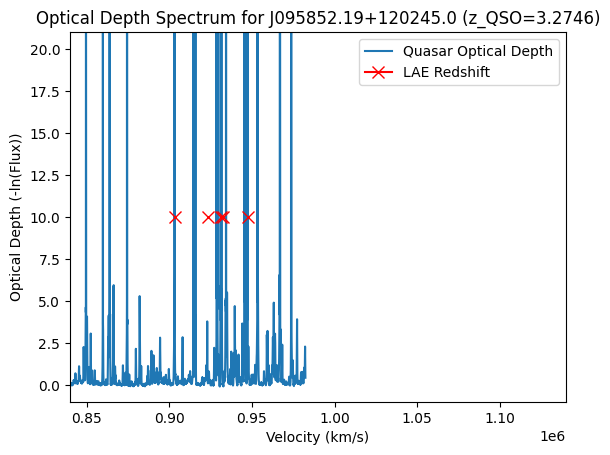


--- Quasar: J102009.99+104002.7 (z_QSO=3.1528) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0133   | 1.6286 | 190.02 | 903990.14
3.0131   | 1.6285 | 107.46 | 903942.18
3.1521   | 1.5781 | 265.31 | 945640.38


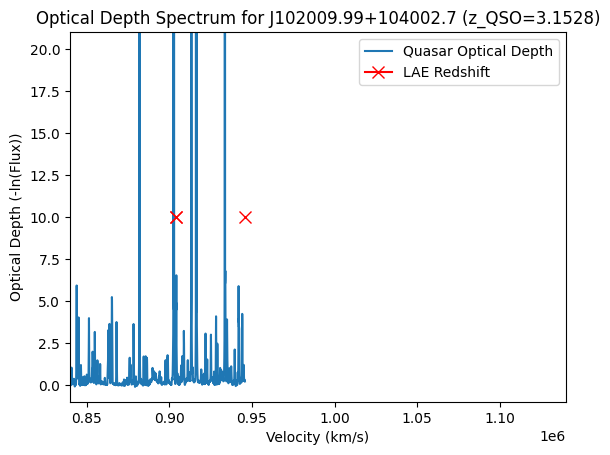


--- Quasar: J111008.61+024458.0 (z_QSO=4.1582) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8114   | 1.6631 | 238.22 | 843411.90
2.9143   | 1.0350 | 299.11 | 874281.58
3.0642   | 3.5903 | 86.39 | 919270.43
3.2081   | 2.0766 | 164.51 | 962425.92
3.2704   | 2.6513 | 200.10 | 981125.66
3.4156   | 1.9044 | 121.75 | 1024691.14
3.4166   | 1.9008 | 223.14 | 1024978.10
3.4687   | 1.7832 | 249.10 | 1040619.11
3.6900   | 3.0593 | 170.01 | 1107000.35


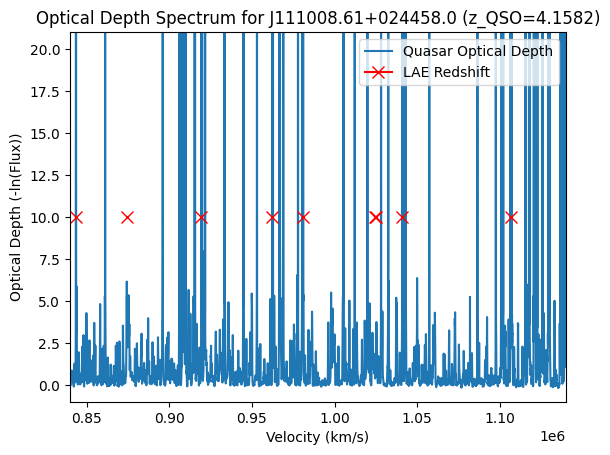


--- Quasar: J111113.79-080402.0 (z_QSO=3.9300) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8362   | 4.1379 | 170.76 | 850873.27
2.9848   | 3.3532 | 226.24 | 895450.27
3.0532   | 3.2761 | 146.74 | 915947.29
3.3172   | 1.7654 | 156.98 | 995165.05
3.3574   | 1.7362 | 149.18 | 1007209.00
3.5752   | 4.3401 | 63.90 | 1072557.79
3.5771   | 4.3284 | 252.55 | 1073141.97
3.5755   | 4.3458 | 171.10 | 1072638.39
3.6047   | 4.4672 | 68.42 | 1081409.07
3.6083   | 4.9266 | 104.65 | 1082488.77
3.6065   | 4.6532 | 198.36 | 1081954.61
3.7159   | 5.3735 | 127.80 | 1114775.13
3.7241   | 5.3815 | 172.67 | 1117236.67


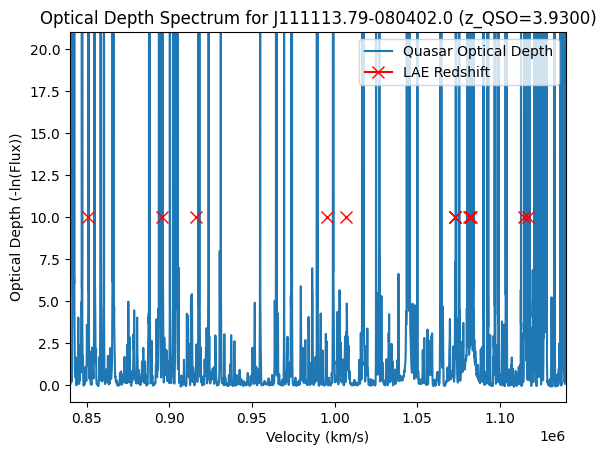


--- Quasar: J120917.93+113830.3 (z_QSO=3.0836) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8341   | 0.5383 | 163.54 | 850242.56
2.9876   | 4.3202 | 108.25 | 896280.58


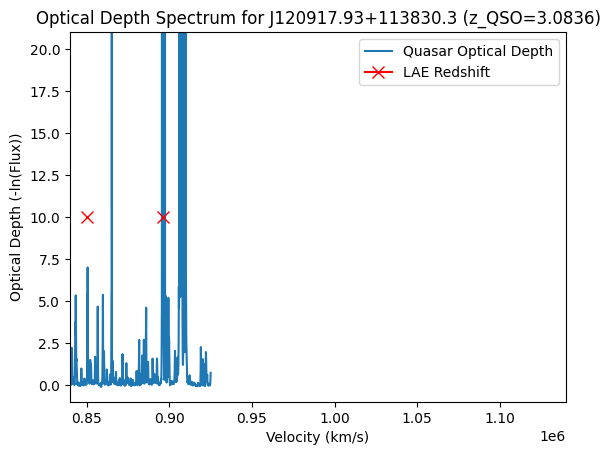


--- Quasar: J123055.57-113909.3 (z_QSO=3.5570) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.1076   | 2.6499 | 99.92 | 932271.54
3.1813   | 1.6617 | 210.26 | 954398.06
3.2358   | 2.9675 | 161.55 | 970729.33
3.2828   | 3.4525 | 239.87 | 984844.66
3.3203   | 3.7786 | 72.82 | 996085.28
3.3206   | 3.7865 | 145.34 | 996180.90
3.3683   | 2.7988 | 185.77 | 1010500.85
3.3783   | 2.3672 | 174.16 | 1013476.76
3.4967   | 0.9612 | 145.84 | 1049021.10
3.5366   | 0.5945 | 74.17 | 1060984.11
3.5414   | 0.6249 | 77.31 | 1062428.91
3.5442   | 0.5797 | 90.45 | 1063262.21


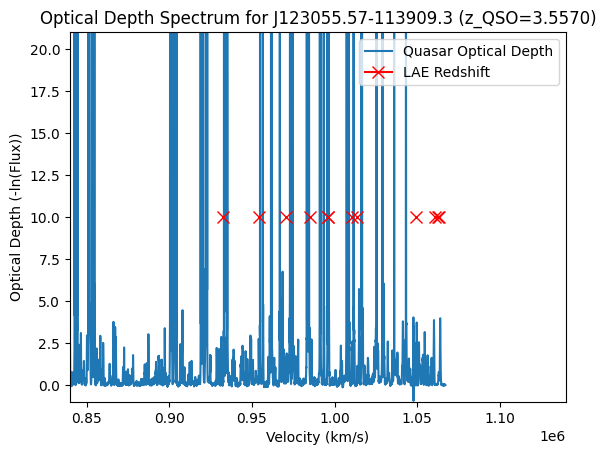


--- Quasar: J124957.23-015928.8 (z_QSO=3.6337) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0251   | 0.7471 | 242.69 | 907531.63
3.4371   | 2.4886 | 251.37 | 1031121.82
3.4693   | 2.7194 | 233.44 | 1040798.96
3.4998   | 2.2530 | 219.51 | 1049931.91
3.5228   | 2.3628 | 219.81 | 1056847.57
3.5212   | 2.3249 | 224.29 | 1056373.96
3.5512   | 1.7382 | 148.57 | 1065359.70
3.5628   | 1.6149 | 222.05 | 1068825.57


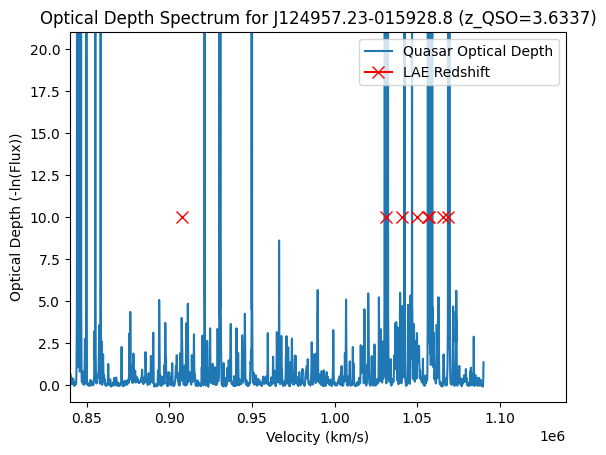


--- Quasar: J133254.51+005250.6 (z_QSO=3.5071) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0170   | 0.8787 | 93.98 | 905090.22
3.0153   | 0.8781 | 208.64 | 904589.64
3.0165   | 0.8800 | 96.13 | 904943.56
3.0861   | 1.7603 | 239.28 | 925841.90
3.1201   | 2.6489 | 214.58 | 936033.40
3.1240   | 2.6810 | 213.66 | 937208.42
3.1314   | 2.7976 | 155.74 | 939428.51
3.1397   | 1.8072 | 121.66 | 941905.05
3.1623   | 1.8368 | 129.29 | 948700.83
3.3442   | 1.0799 | 251.69 | 1003263.97
3.3495   | 1.0788 | 90.73 | 1004840.97
3.4737   | 0.3929 | 202.36 | 1042099.88
3.5028   | 0.4629 | 133.17 | 1050852.57


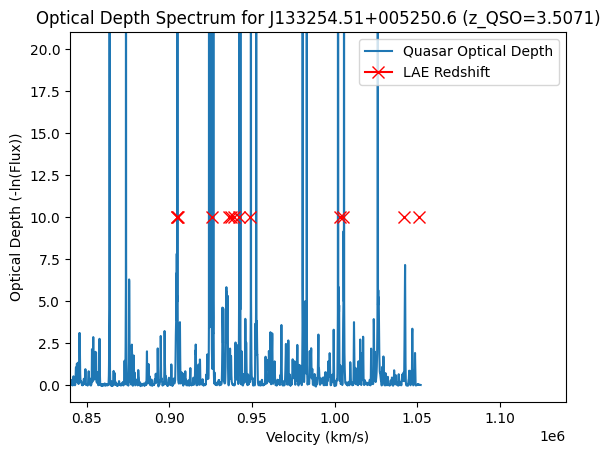


--- Quasar: J142438.10+225600.7 (z_QSO=3.6340) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.3212   | 0.6537 | 188.73 | 996358.05
3.3211   | 0.6537 | 201.65 | 996334.26
3.3779   | 1.3717 | 205.47 | 1013368.85
3.5647   | 1.4547 | 177.97 | 1069413.92


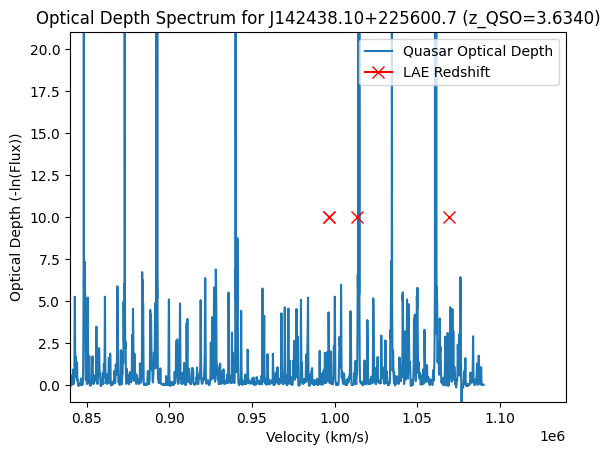


--- Quasar: J162116.92-004250.8 (z_QSO=3.7100) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9315   | 2.2733 | 89.22 | 879449.62
2.9398   | 2.0033 | 261.34 | 881928.05
2.9547   | 1.4236 | 159.02 | 886423.67
2.9500   | 1.4205 | 184.47 | 884996.49
2.9555   | 1.4037 | 133.30 | 886658.35
3.1072   | 3.9392 | 207.05 | 932169.62
3.1080   | 3.9106 | 157.63 | 932406.43
3.1106   | 3.4885 | 200.26 | 933185.78
3.1930   | 1.4827 | 194.20 | 957900.15
3.1991   | 1.2427 | 139.40 | 959716.81
3.2025   | 1.2029 | 190.70 | 960739.06
3.3775   | 0.4329 | 154.28 | 1013242.45
3.4524   | 1.4055 | 223.96 | 1035715.20
3.4860   | 1.7366 | 137.17 | 1045801.79
3.4971   | 1.6858 | 234.73 | 1049141.00


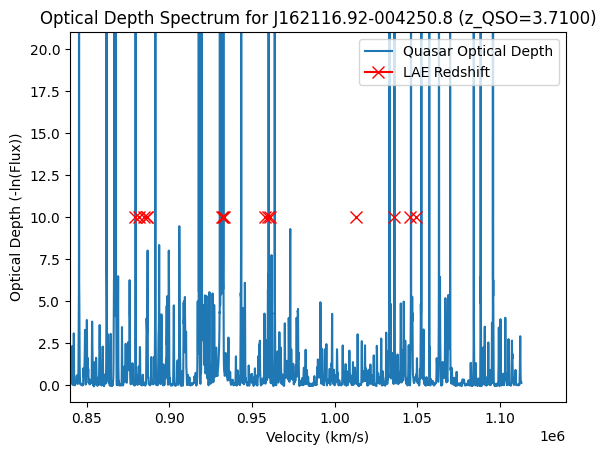


--- Quasar: J193957.25-100241.5 (z_QSO=3.7870) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0056   | 1.4049 | 123.77 | 901682.07
3.1363   | 0.9723 | 160.61 | 940889.35
3.5522   | 1.0396 | 33.15 | 1065668.52


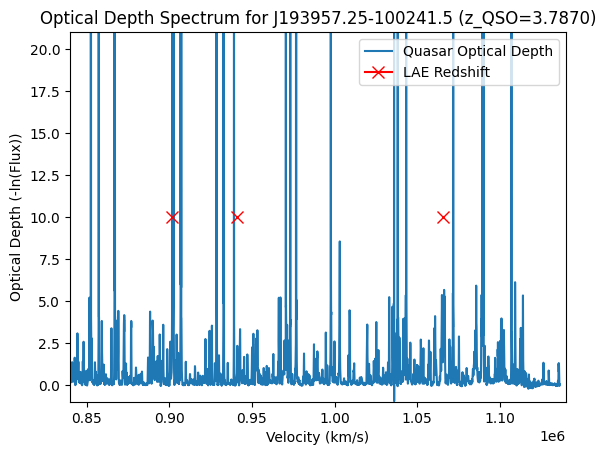


--- Quasar: J200324.14-325144.8 (z_QSO=3.7850) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.1899   | 6.7186 | 206.02 | 956964.93
3.2326   | 4.4555 | 124.68 | 969776.24
3.2496   | 1.4477 | 91.48 | 974880.98
3.3016   | 1.8719 | 193.30 | 990471.27
3.3354   | 1.9959 | 144.01 | 1000610.90
3.3353   | 1.9959 | 159.24 | 1000584.52
3.4451   | 2.6508 | 68.24 | 1033515.64
3.5499   | 2.9089 | 76.27 | 1064970.79
3.5506   | 2.9129 | 242.03 | 1065192.60
3.5542   | 2.9407 | 184.97 | 1066266.91
3.6179   | 1.5510 | 172.29 | 1085355.56
3.6351   | 1.7700 | 147.57 | 1090524.46
3.6417   | 1.7572 | 246.11 | 1092513.90
3.6683   | 1.5671 | 136.62 | 1100504.63
3.7157   | 0.8970 | 127.65 | 1114705.28


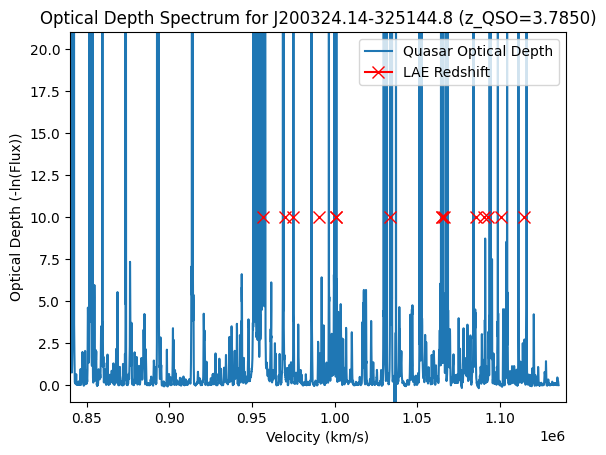


--- Quasar: J205344.72-354655.2 (z_QSO=3.4900) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9210   | 2.3695 | 175.15 | 876311.24
3.0355   | 3.4054 | 104.33 | 910660.77
3.0445   | 1.7809 | 132.84 | 913364.47
3.0856   | 2.4279 | 153.36 | 925670.75
3.0938   | 2.7297 | 23.82 | 928143.98
3.0932   | 2.7375 | 22.62 | 927970.13
3.0935   | 2.7319 | 106.47 | 928042.07
3.1406   | 4.6991 | 225.22 | 942189.95
3.1543   | 3.5815 | 153.53 | 946282.41
3.1579   | 3.5535 | 98.93 | 947384.92
3.1733   | 3.5831 | 28.16 | 951995.08
3.1756   | 3.2364 | 84.56 | 952674.61
3.1737   | 3.5738 | 245.87 | 952108.98
3.3972   | 1.1195 | 219.31 | 1019148.03


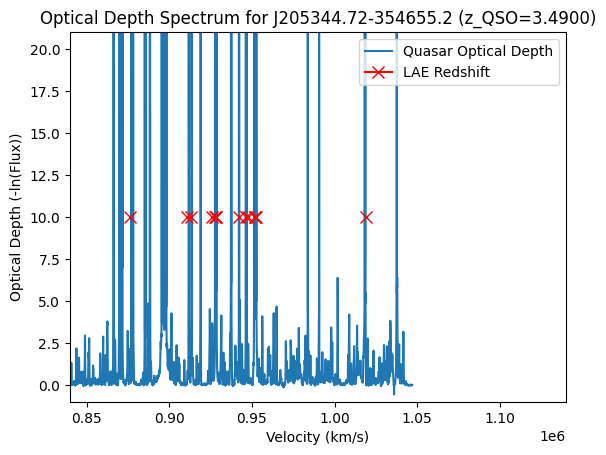


--- Quasar: J221527.29-161133.0 (z_QSO=4.0000) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9296   | 3.9541 | 203.52 | 878877.40
2.9402   | 3.7035 | 206.38 | 882060.44
3.0519   | 2.3902 | 232.32 | 915564.55
3.0625   | 2.0694 | 95.20 | 918737.83
3.1290   | 3.6981 | 190.93 | 938687.72
3.3029   | 2.2233 | 101.61 | 990875.63
3.3016   | 2.2149 | 160.44 | 990494.94
3.4104   | 1.0940 | 172.51 | 1023132.38
3.4599   | 3.9960 | 71.36 | 1037981.31
3.4648   | 3.9596 | 155.98 | 1039447.09
3.4705   | 3.9770 | 82.84 | 1041158.66


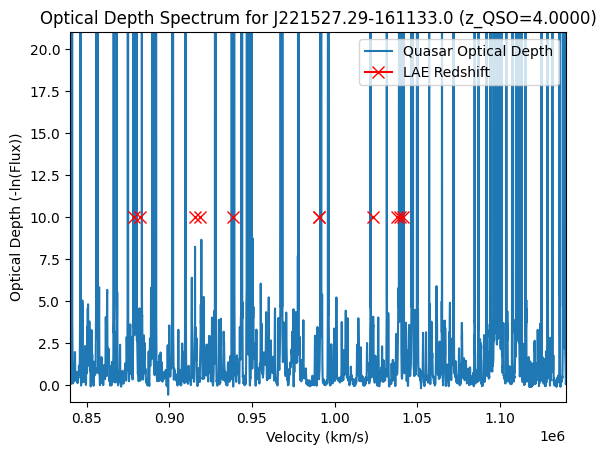


--- Quasar: J230301.45-093930.7 (z_QSO=3.4774) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9942   | 0.7299 | 152.29 | 898274.68
3.1021   | 0.9058 | 116.72 | 930642.03
3.2467   | 1.5282 | 103.01 | 974004.29
3.4094   | 0.9998 | 172.41 | 1022816.27
3.4135   | 0.9925 | 161.94 | 1024058.20
3.4176   | 0.9827 | 184.44 | 1025281.87


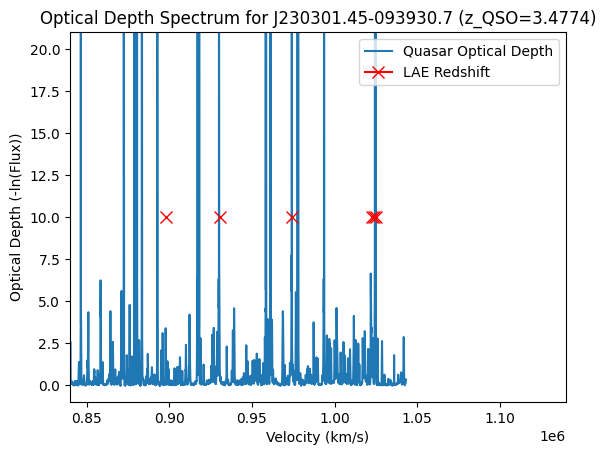


--- Quasar: J231543.56+145606.4 (z_QSO=3.3971) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.8977   | 3.3452 | 74.59 | 869295.25
2.9947   | 2.9212 | 155.57 | 898423.79
2.9951   | 2.8314 | 184.45 | 898540.69
3.1372   | 3.9986 | 110.51 | 941156.09
3.1375   | 4.0060 | 123.25 | 941243.05
3.1763   | 3.6006 | 100.67 | 952882.34
3.1998   | 0.8857 | 249.54 | 959937.85
3.2732   | 4.5617 | 265.71 | 981961.07
3.2737   | 4.5714 | 262.37 | 982122.93
3.3620   | 0.9599 | 104.71 | 1008614.82
3.3951   | 0.8877 | 123.71 | 1018518.56


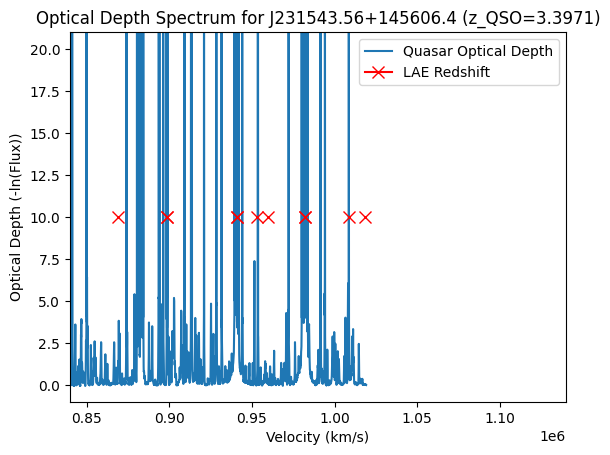


--- Quasar: J233446.40-090812.2 (z_QSO=3.3261) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
3.0054   | 2.8663 | 184.20 | 901634.11
3.0492   | 5.3124 | 216.25 | 914774.35
3.0569   | 5.3746 | 196.12 | 917062.23
3.0560   | 5.3824 | 206.45 | 916798.45
3.0550   | 5.3689 | 222.15 | 916510.69
3.0577   | 4.9902 | 193.69 | 917308.03
3.0567   | 5.3842 | 96.53 | 917015.47
3.0649   | 4.8622 | 226.04 | 919475.22
3.0907   | 4.5660 | 157.94 | 927222.82
3.2892   | 1.3629 | 173.01 | 986753.08


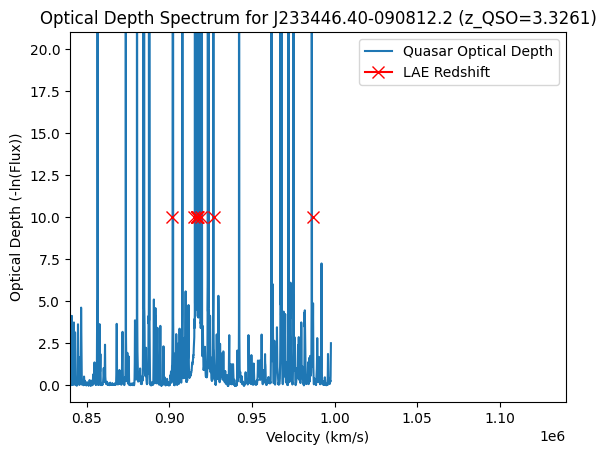


--- Quasar: J234913.75-371259.2 (z_QSO=4.2400) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)
-------------------------------------------------------------------
2.9592   | 3.7708 | 230.58 | 887755.06
3.0312   | 3.8473 | 289.73 | 909358.31
3.0323   | 3.8456 | 232.83 | 909683.76
3.0343   | 3.8384 | 195.17 | 910294.75
3.0344   | 3.8286 | 201.90 | 910318.46
3.0363   | 3.8295 | 148.01 | 910901.38
3.0955   | 3.3662 | 206.97 | 928658.30
3.1150   | 2.4062 | 208.81 | 934504.54
3.1908   | 3.8226 | 89.30 | 957242.80
3.2589   | 2.9346 | 201.44 | 977659.79
3.2594   | 2.9292 | 172.64 | 977817.87
3.2850   | 2.7905 | 118.80 | 985508.01
3.6591   | 5.1612 | 72.19 | 1097721.45
3.6601   | 5.1522 | 19.23 | 1098037.68
3.6929   | 5.2497 | 31.31 | 1107861.99
3.7558   | 5.8658 | 137.93 | 1126726.60
3.7588   | 6.1528 | 46.71 | 1127638.61
3.7596   | 6.3313 | 184.17 | 1127894.27


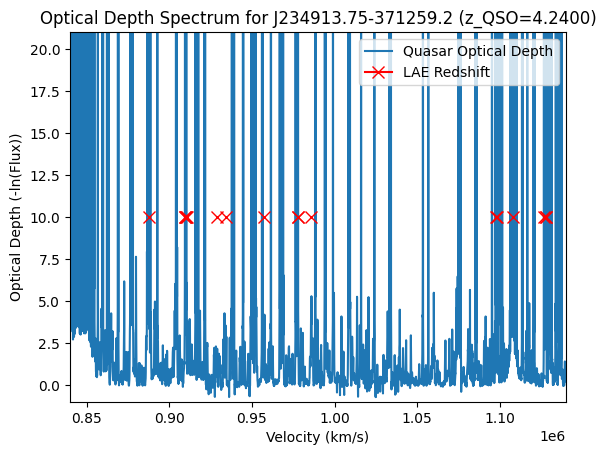

In [19]:
lae_df['FIELD_str'] = lae_df['FIELD'].apply(lambda x: x.decode('utf-8'))

for exx in range(1, num_qso + 1):
    # Retrieve redshift (z_QSO) for the current quasar
    z_qso = qsolist[exx].header['z_QSO']
    quasar_field = qsolist[exx].header['FIELD']

    # Calculate the Lyα cutoff wavelength
    lya_cutoff = 1215.67 * (1 + z_qso)

    # Convert lya_cutoff wavelength to redshift
    lya_cutoff_redshift = (lya_cutoff / 1215.67) - 1

    # Access 'wave' and 'flux' data
    wave_data = qsolist[exx].data['wave']
    flux_data = qsolist[exx].data['flux']

    # Create a boolean mask for wavelengths bluer than the cutoff
    mask_bluer = wave_data < lya_cutoff

    # Apply the mask to filter wave and flux data initially
    filtered_wave_pre = wave_data[mask_bluer]
    filtered_flux_pre = flux_data[mask_bluer]

    # Create a copy of filtered_flux_pre to modify
    modified_flux = np.copy(filtered_flux_pre)

    # Replace flux values <= 0 with 1e-20
    modified_flux[modified_flux <= 0] = 1e-20

    # Use these modified fluxes for calculation
    final_wave = filtered_wave_pre
    final_flux = modified_flux

    # Calculate optical depth (-ln(flux))
    # Ensure final_flux is not empty before attempting calculation
    if len(final_flux) > 0:
        optical_depth = -np.log(final_flux)

        # Convert filtered_wave to redshift
        redshift_x = (final_wave / 1215.67) - 1

        # --- Calculate Velocity for the x-axis (interpreting z_lae=0 as rest frame) ---
        velocity_x = 3 * 10**5 * redshift_x

        # Create a new plot for the optical depth spectrum
        plt.figure()
        plt.plot(velocity_x, optical_depth, label='Quasar Optical Depth')

        # Filter lae_df for galaxies corresponding to the current quasar's FIELD
        galaxies_in_field = lae_df[lae_df['FIELD_str'] == quasar_field]

        # Filter galaxies further to include only those within the redshift plotting range
        # and with z_corr less than lya_cutoff_redshift
        galaxies_in_field_filtered = galaxies_in_field[
            (galaxies_in_field['z_corr'] >= 2.8) &
            (galaxies_in_field['z_corr'] <= 3.8) &
            (galaxies_in_field['z_corr'] < lya_cutoff_redshift)
        ]

        # Print header for LAE optical depth calculations
        print(f"\n--- Quasar: {quasar_field} (z_QSO={z_qso:.4f}) ---")
        print("LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc | Velocity (km/s)")
        print("-------------------------------------------------------------------")

        # Plot red 'x' markers for each filtered galaxy's redshift at y=10
        for i, galaxy in galaxies_in_field_filtered.iterrows():
            lae_z_corr = galaxy['z_corr']
            r_kpc = galaxy['R_kpc']

            # Calculate velocity for LAE marker
            lae_velocity = 3 * 10**5 * lae_z_corr # Using the simplified formula

            plt.plot(lae_velocity, 10, marker='x', color='red', markersize=8, label='LAE Redshift' if i == galaxies_in_field_filtered.index[0] else '') # Add label only once

            # Calculate mean optical depth in a range of +-0.05 redshift around the LAE
            redshift_min_lae = lae_z_corr - 0.05
            redshift_max_lae = lae_z_corr + 0.05

            # Filter optical depth data for this LAE's redshift range
            mask_lae_redshift_range = (redshift_x >= redshift_min_lae) & (redshift_x <= redshift_max_lae)
            lae_optical_depth_segment = optical_depth[mask_lae_redshift_range]

            if len(lae_optical_depth_segment) > 0:
                mean_tau = np.mean(lae_optical_depth_segment)
                print(f"{lae_z_corr:.4f}   | {mean_tau:.4f} | {r_kpc:.2f} | {lae_velocity:.2f}")
            else:
                print(f"{lae_z_corr:.4f}   | No data in range | {r_kpc:.2f} | {lae_velocity:.2f}")

        # Set x-axis limits for velocity
        plt.xlim(3 * 10**5 * 2.8, 3 * 10**5 * 3.8) # Convert original redshift limits to velocity
        plt.ylim(-1, 21) # Set y-axis limits for optical depth
        plt.xlabel('Velocity (km/s)')
        plt.ylabel('Optical Depth (-ln(Flux))')
        plt.title(f"Optical Depth Spectrum for {quasar_field} (z_QSO={z_qso:.4f})")
        plt.legend()
        plt.show()
    else:
        print(f"No bluer wavelengths found for {quasar_field} after filtering. Skipping plot.")

ValueError: x and y must have same first dimension, but have shapes (1,) and (12598,)

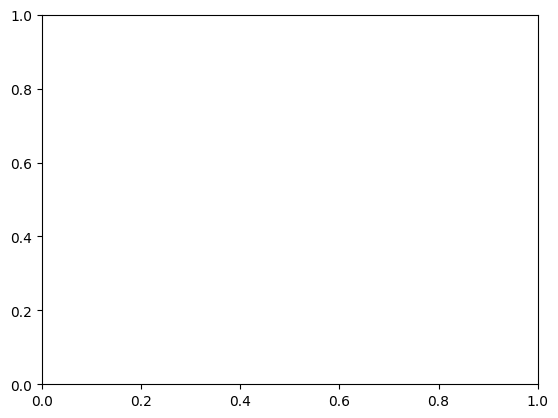

In [20]:
len_redshift=len(redshift_x,)
for i in range (1,len_redshift):
  velocity = 3*10**5*(redshift_x[i]-(3.2/4.2))
#riferita alla quasar
plt.plot(velocity, optical_depth, label='Quasar Optical Depth')


--- Quasar: J010619.24+004823.3 (z_QSO=4.4402) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9231   | 6.3313 | 157.05


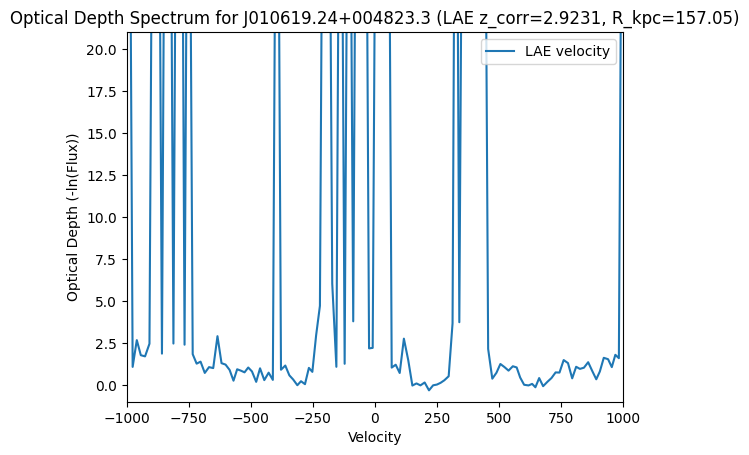

3.1048   | 6.3313 | 112.41


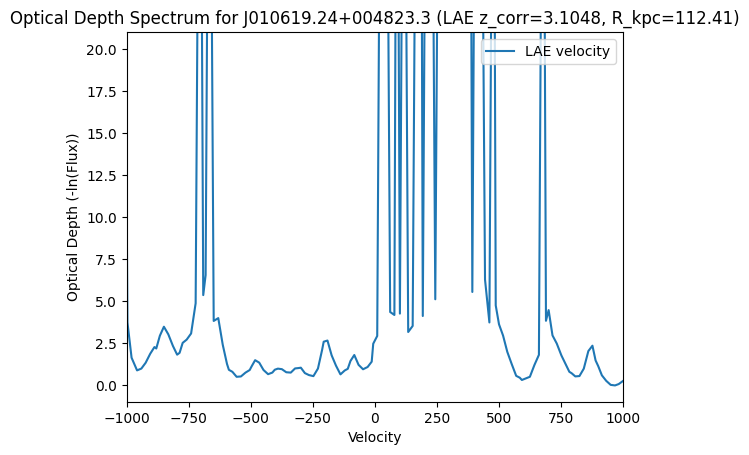

3.1179   | 6.3313 | 242.95


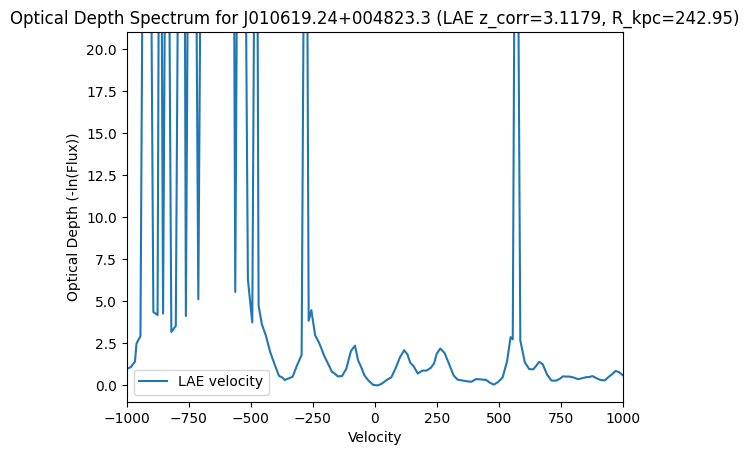

3.2046   | 6.3313 | 95.61


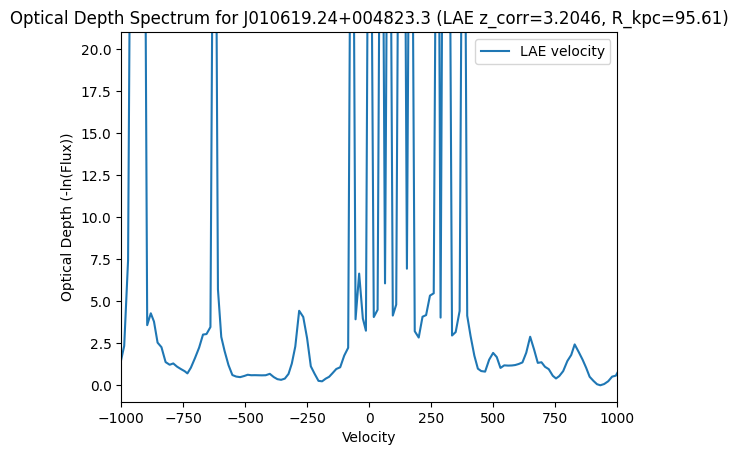

3.2077   | 6.3313 | 159.31


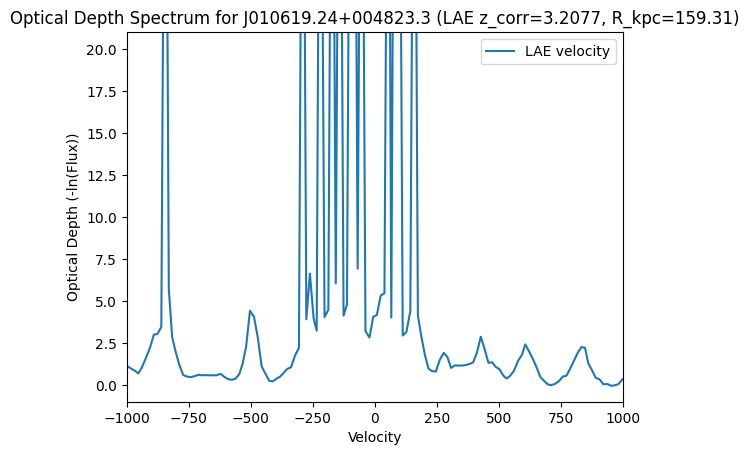

3.2212   | 6.3313 | 198.48


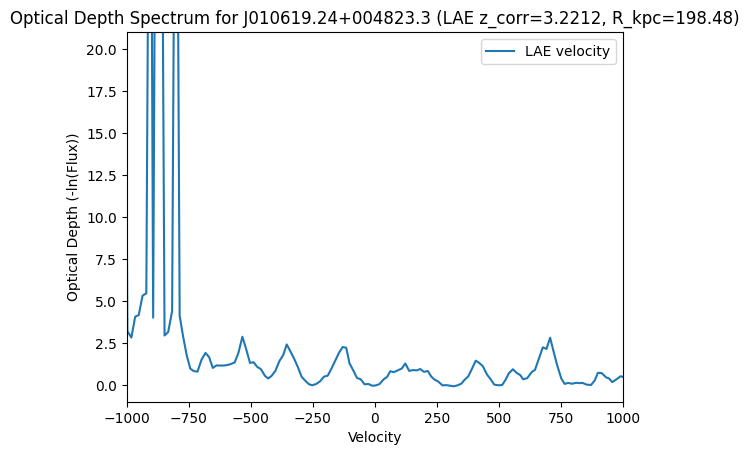

3.2718   | 6.3313 | 209.95


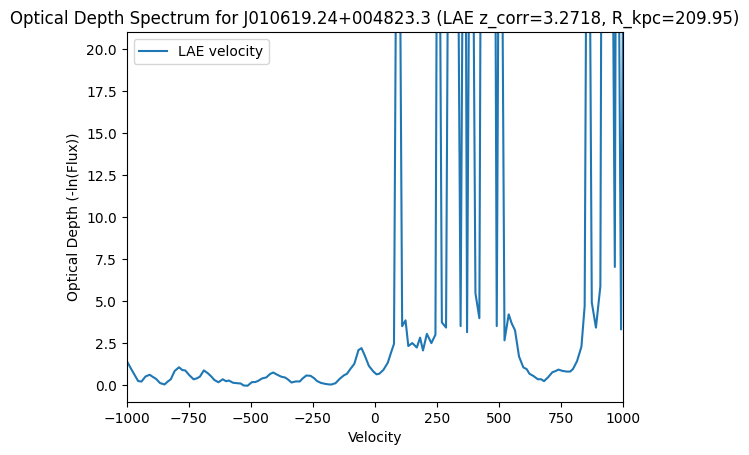

3.3231   | 6.3313 | 198.49


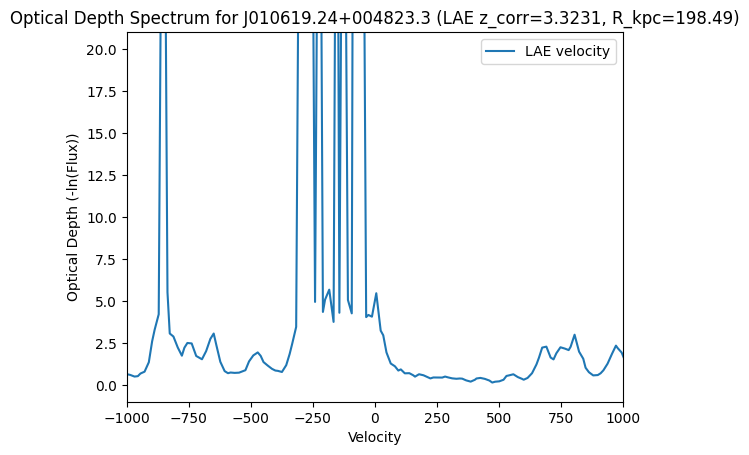

3.3236   | 6.3313 | 214.62


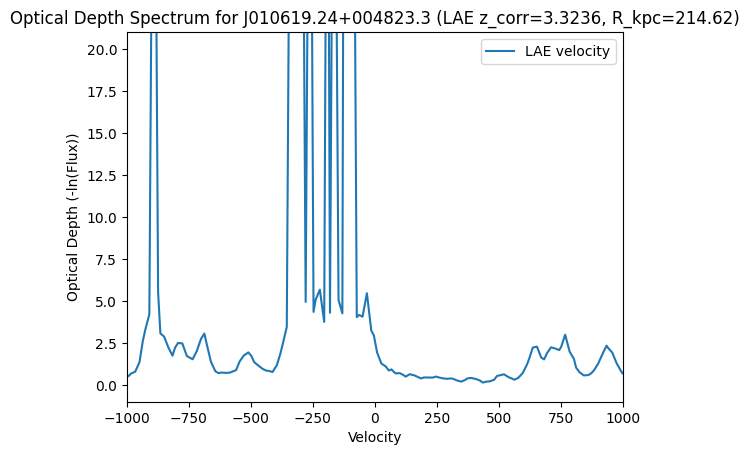

3.3240   | 6.3313 | 107.97


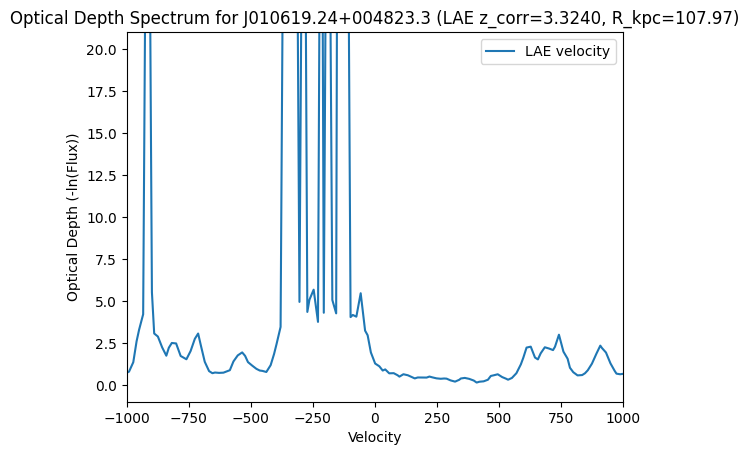

3.4276   | 6.3313 | 189.51


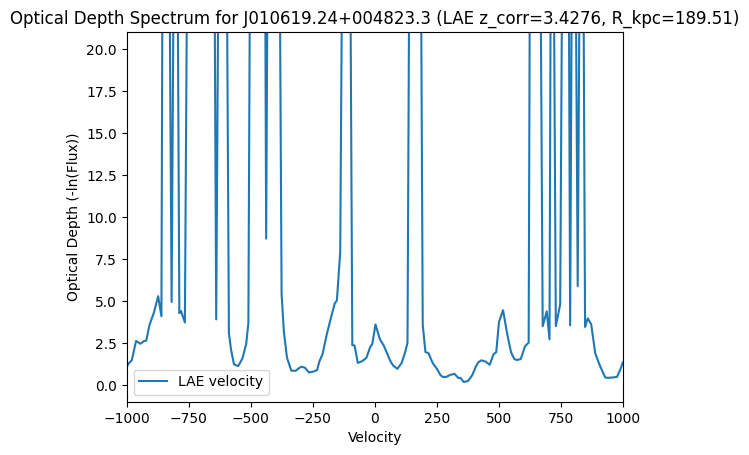

3.4378   | 6.3313 | 82.85


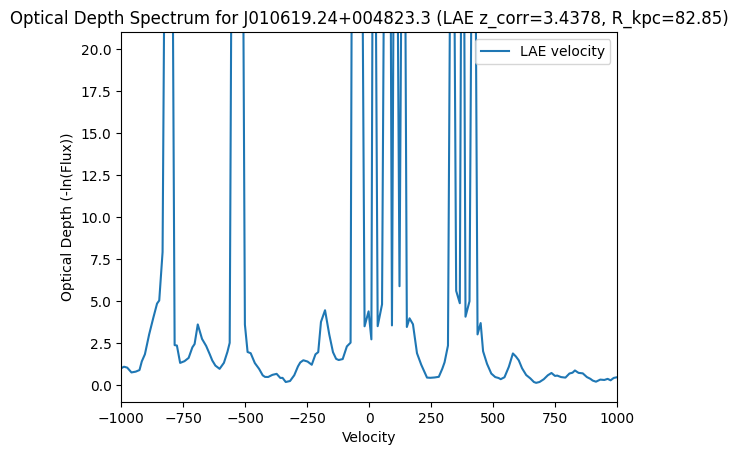

3.4368   | 6.3313 | 161.43


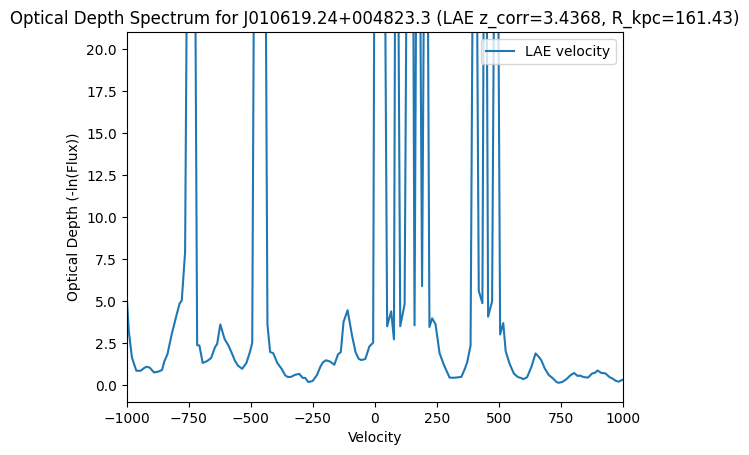

3.4399   | 6.3313 | 121.12


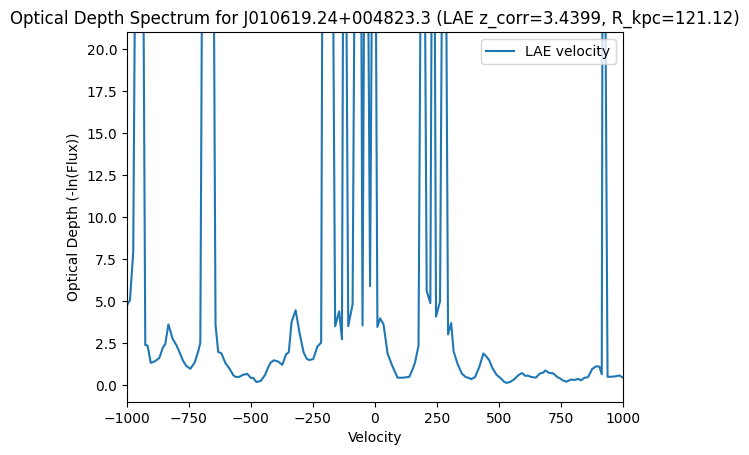

3.5220   | 6.3313 | 215.78


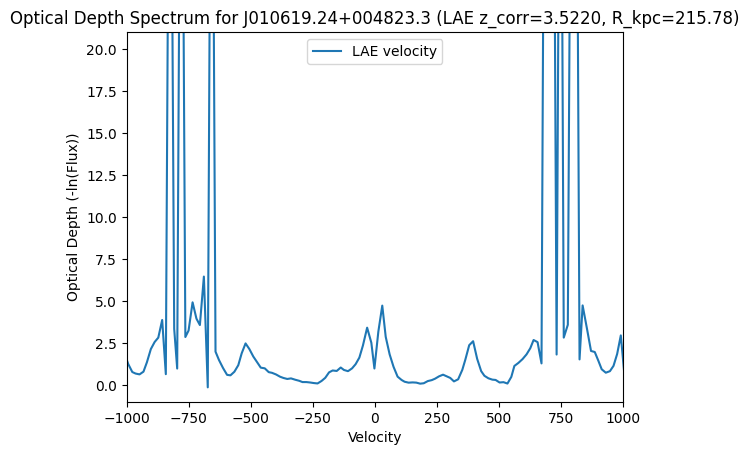

3.5267   | 6.3313 | 139.33


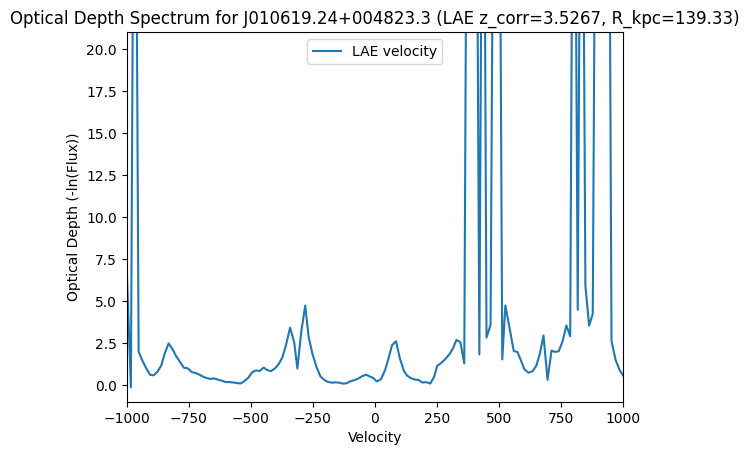

3.6795   | 6.3313 | 209.52


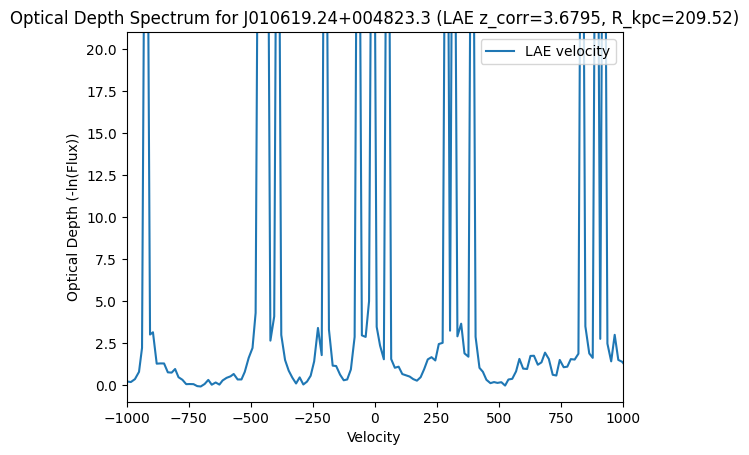

3.6987   | 6.3313 | 195.63


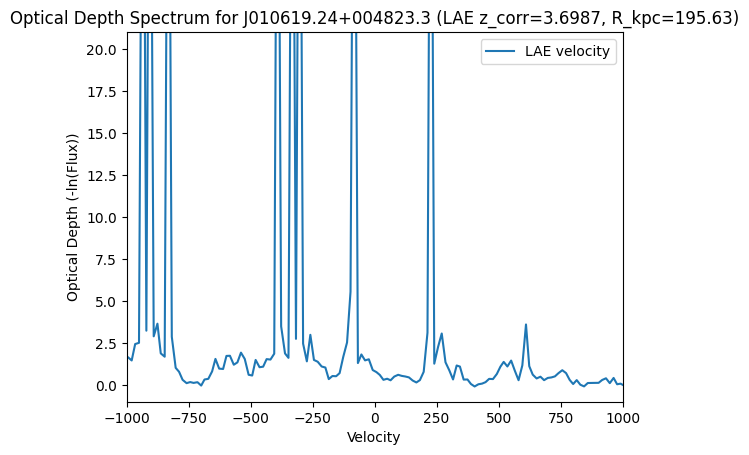

3.7276   | 6.3313 | 9.13


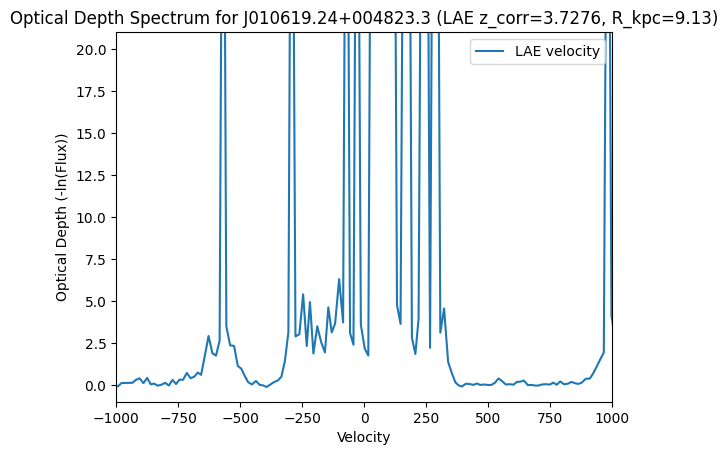

3.7648   | 6.3313 | 76.16


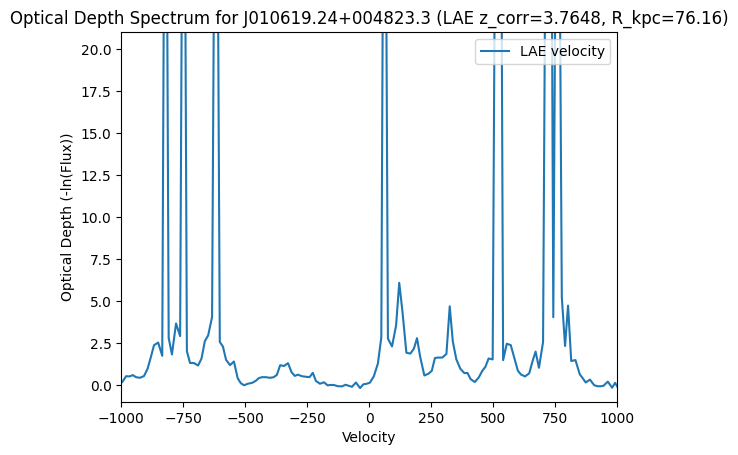

3.7752   | 6.3313 | 227.68


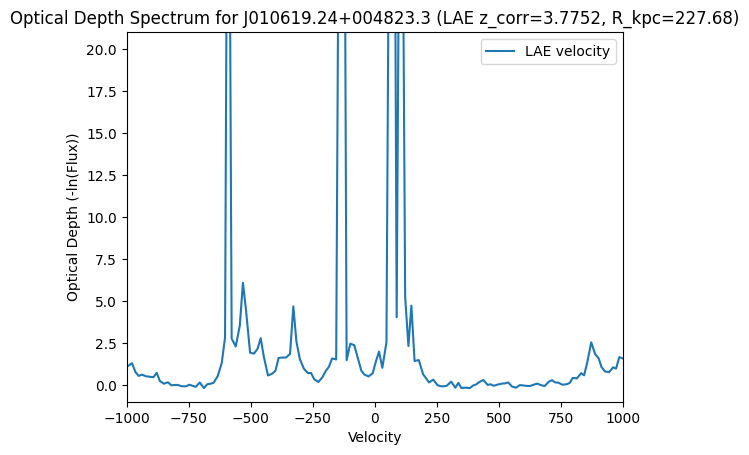


--- Quasar: J012403.77+004432.7 (z_QSO=3.8359) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8339   | 6.3313 | 241.55


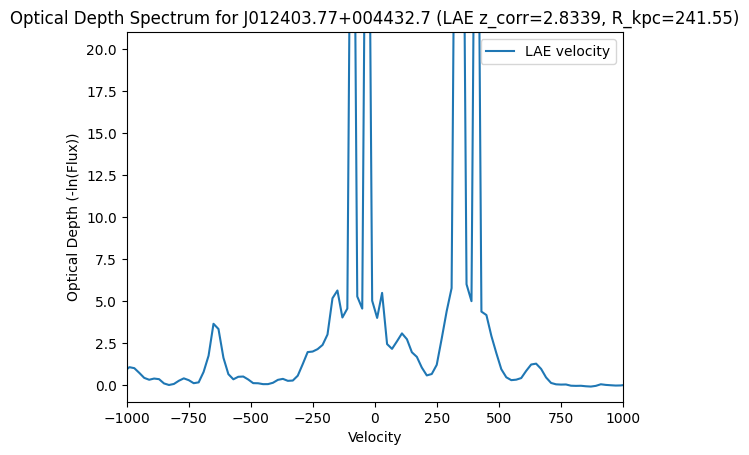

3.0783   | 6.3313 | 208.42


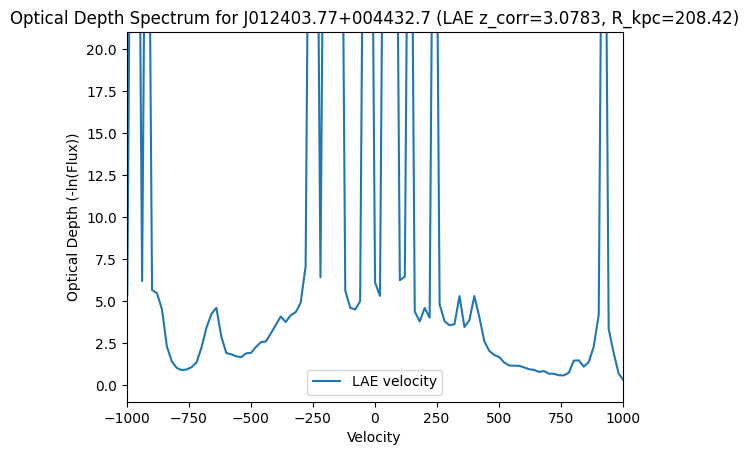

3.1045   | 6.3313 | 30.22


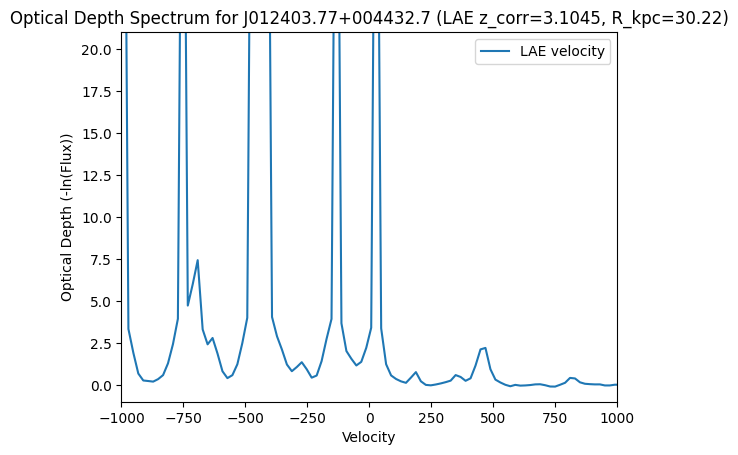

3.1869   | 6.3313 | 137.50


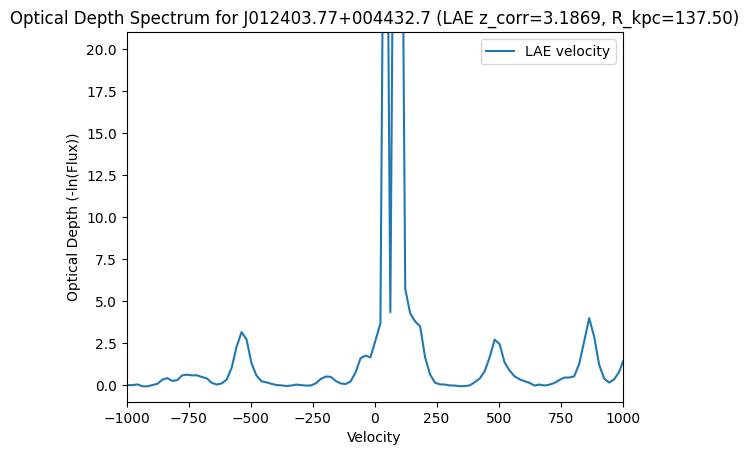

3.3940   | 6.3313 | 199.53


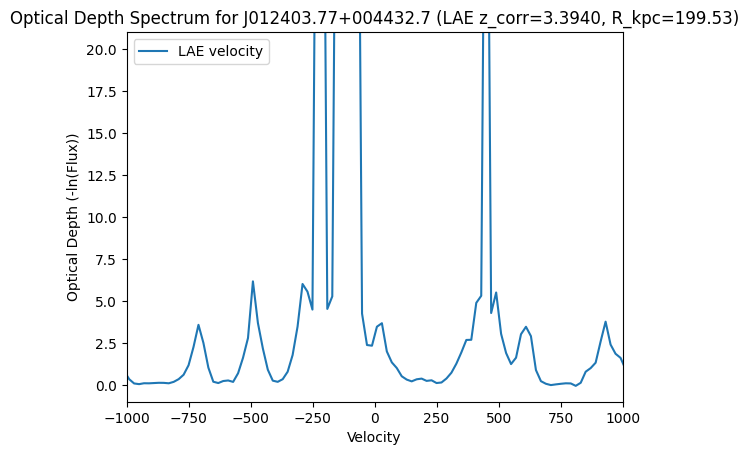

3.3925   | 6.3313 | 74.97


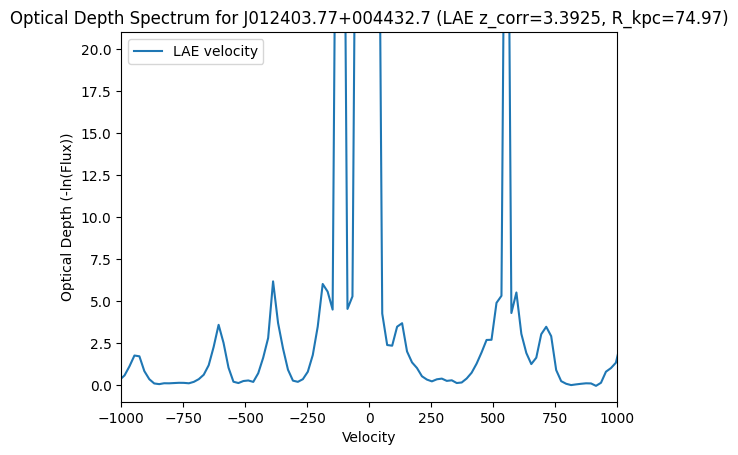

3.4649   | 6.3313 | 67.93


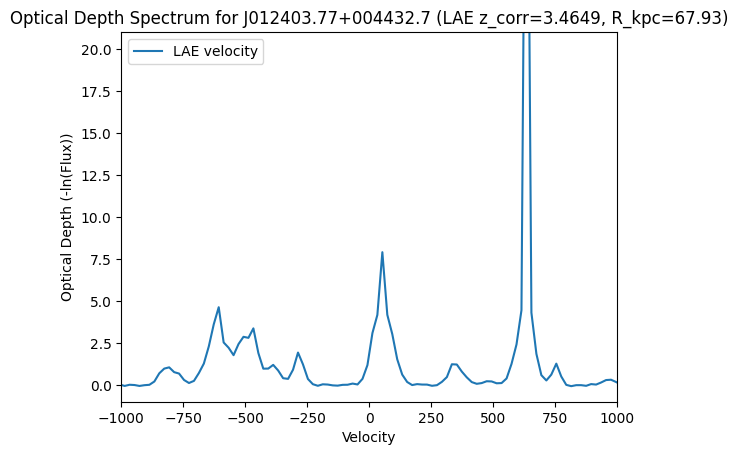

3.4911   | 6.3313 | 102.54


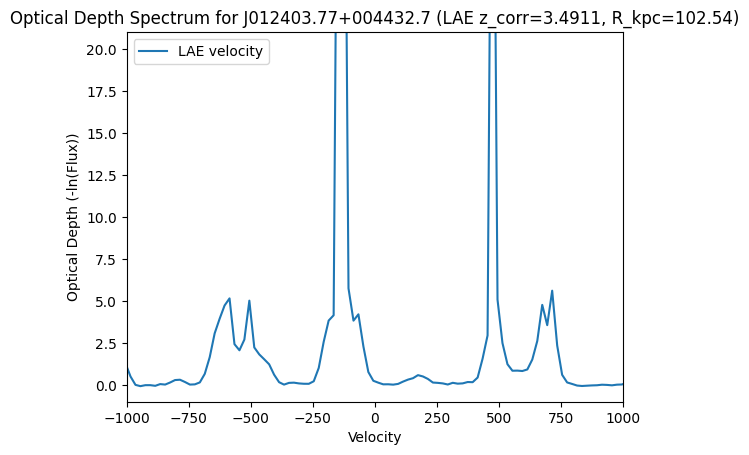

3.5471   | 6.3313 | 227.13


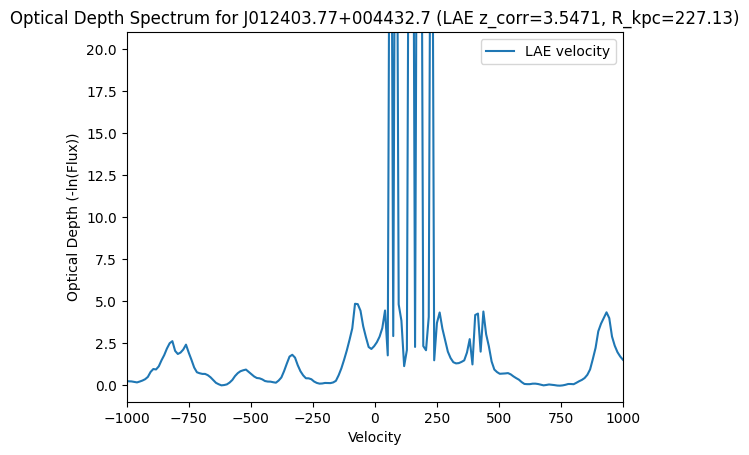

3.5482   | 6.3313 | 152.03


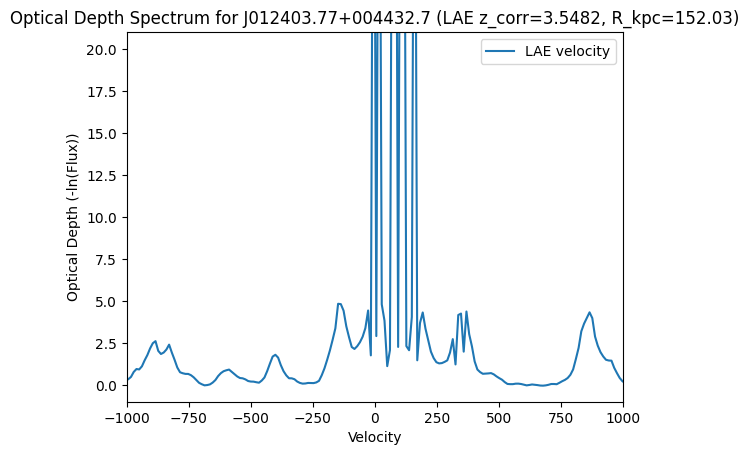


--- Quasar: J013340.31+040059.7 (z_QSO=4.1709) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9918   | 6.3313 | 97.04


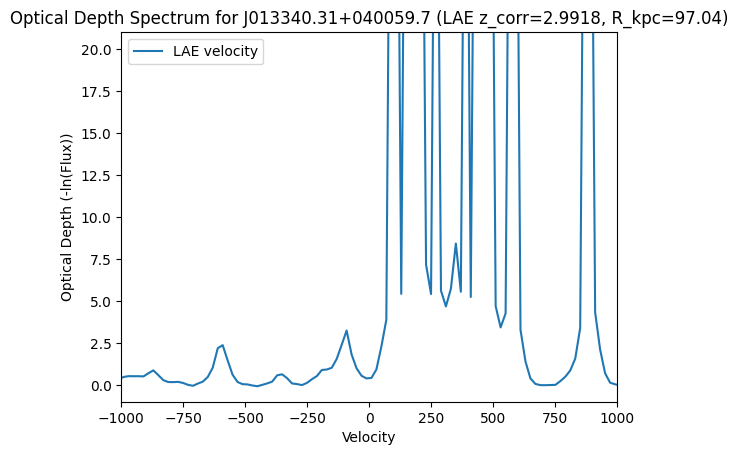

3.0771   | 6.3313 | 154.50


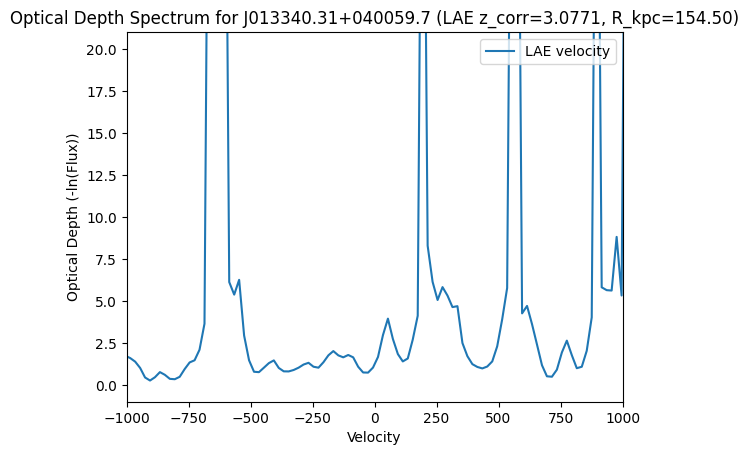

3.1388   | 6.3313 | 214.89


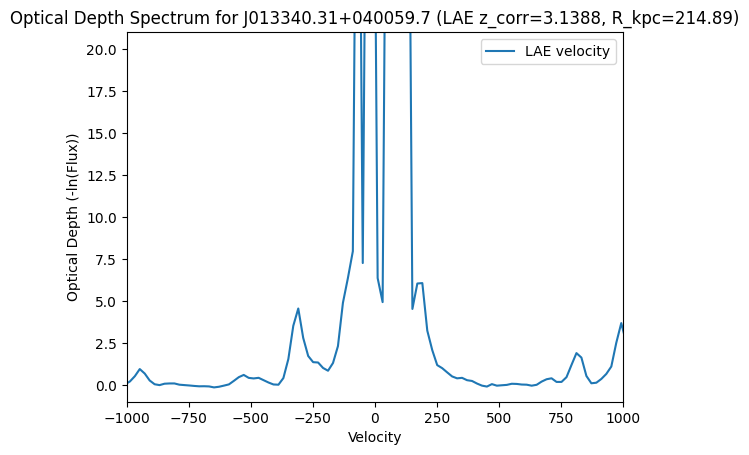

3.1888   | 6.3313 | 254.89


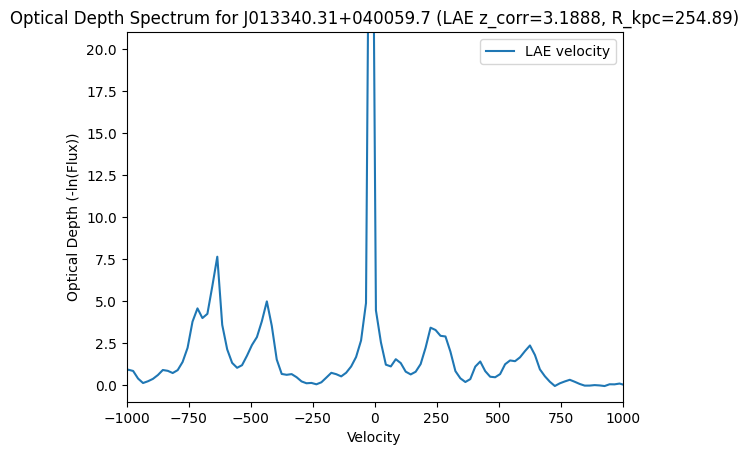

3.2837   | 6.3313 | 208.48


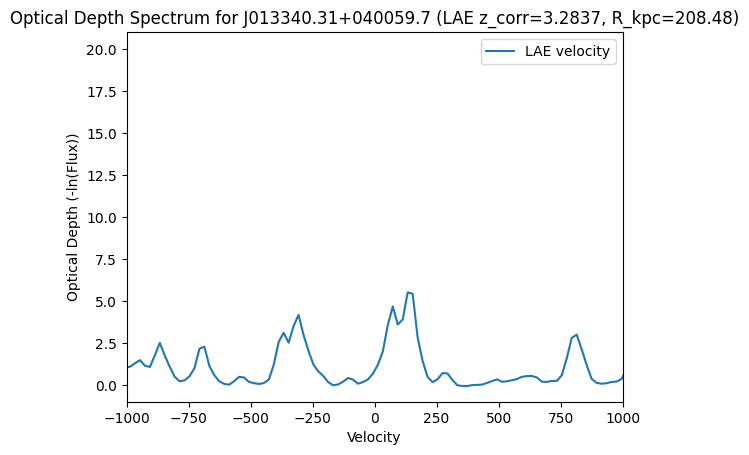

3.3001   | 6.3313 | 228.09


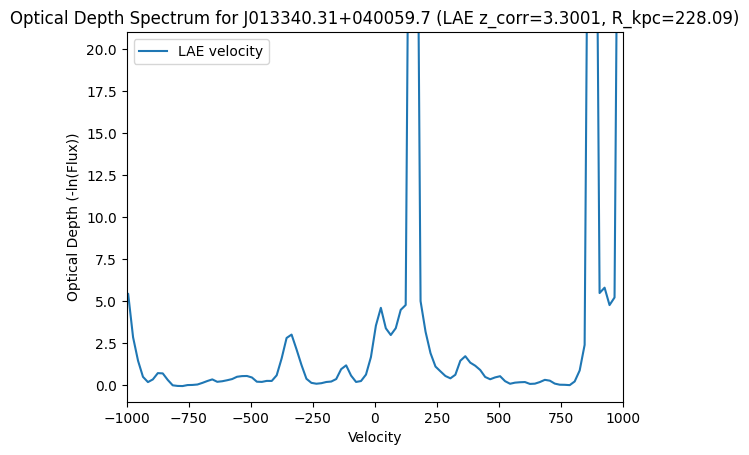

3.3288   | 6.3313 | 50.55


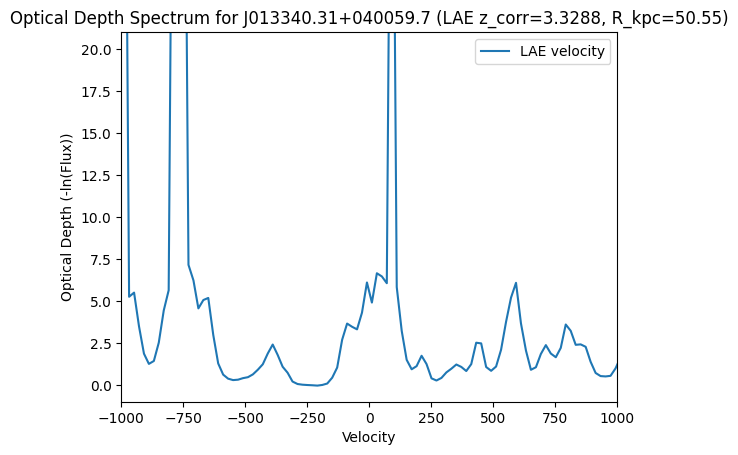

3.5383   | 6.3313 | 166.40


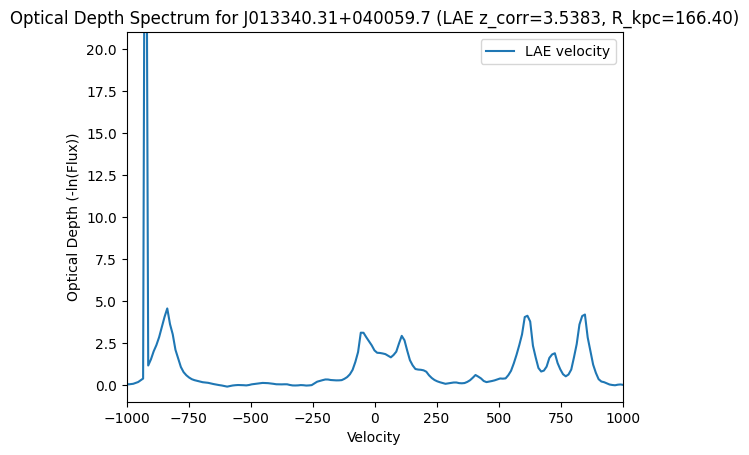

3.5954   | 6.3313 | 40.44


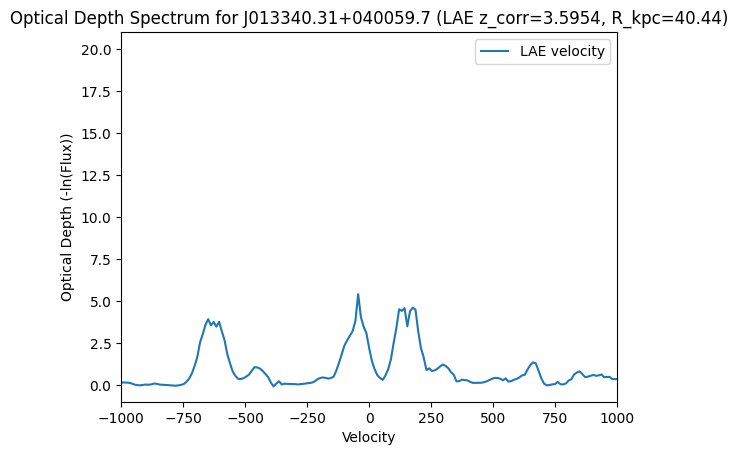

3.6923   | 6.3313 | 141.12


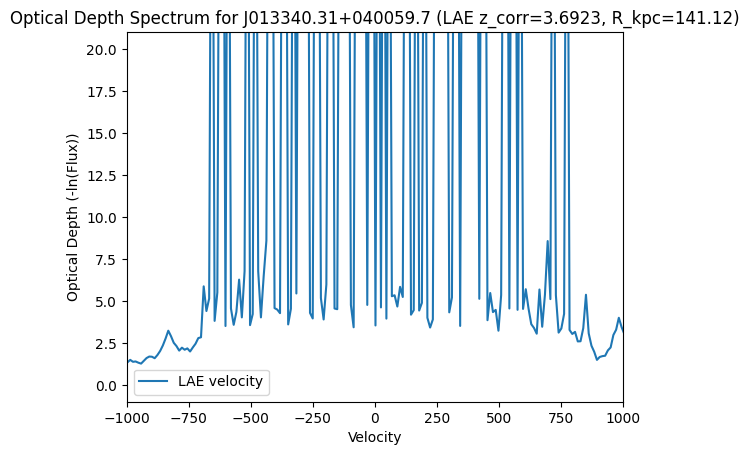


--- Quasar: J013724.36-422417.3 (z_QSO=3.9750) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8865   | 6.3313 | 268.15


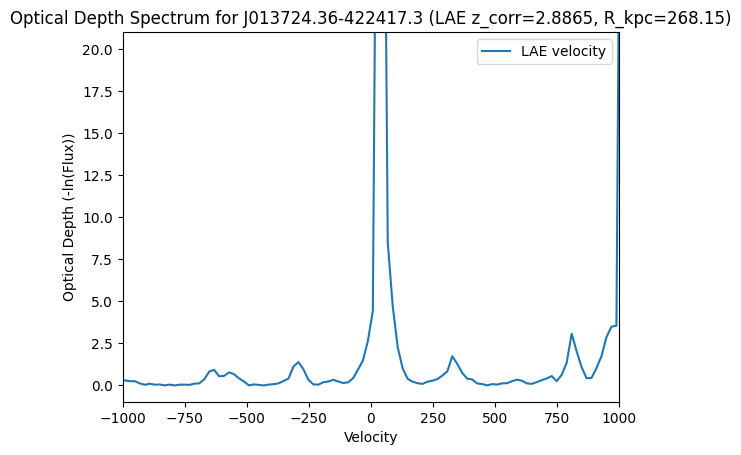

3.0000   | 6.3313 | 195.06


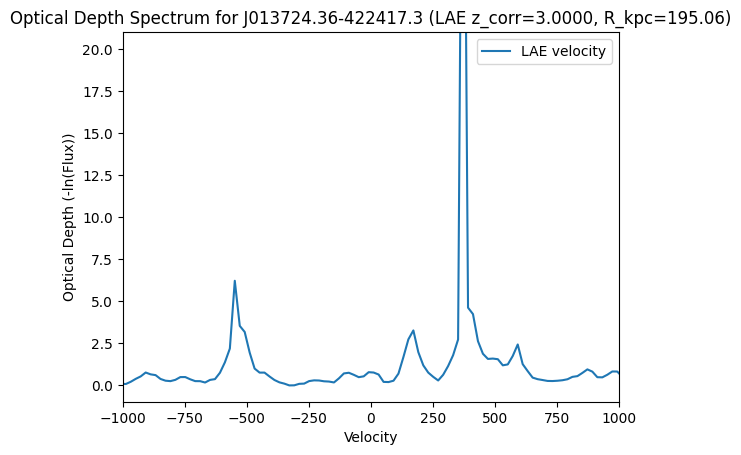

3.0609   | 6.3313 | 217.72


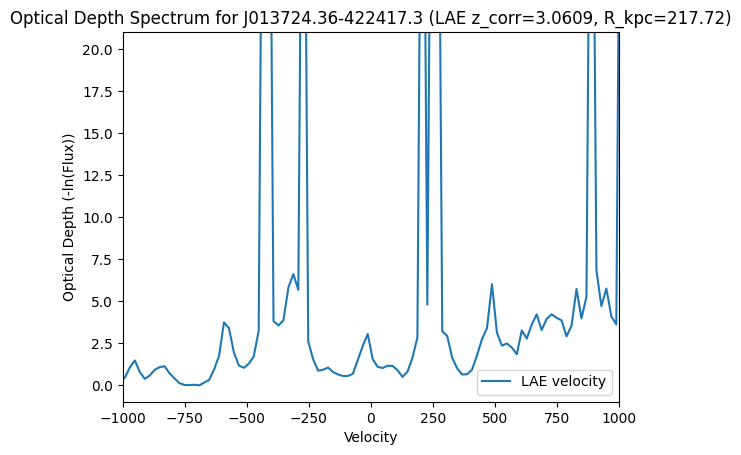

3.0726   | 6.3313 | 148.45


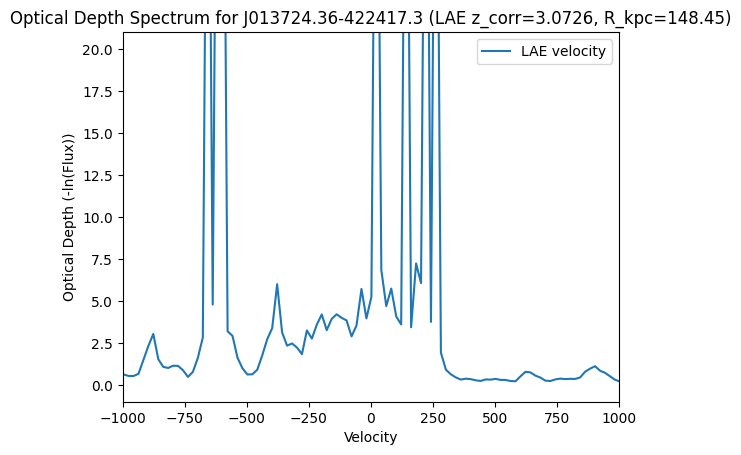

3.0748   | 6.3313 | 249.05


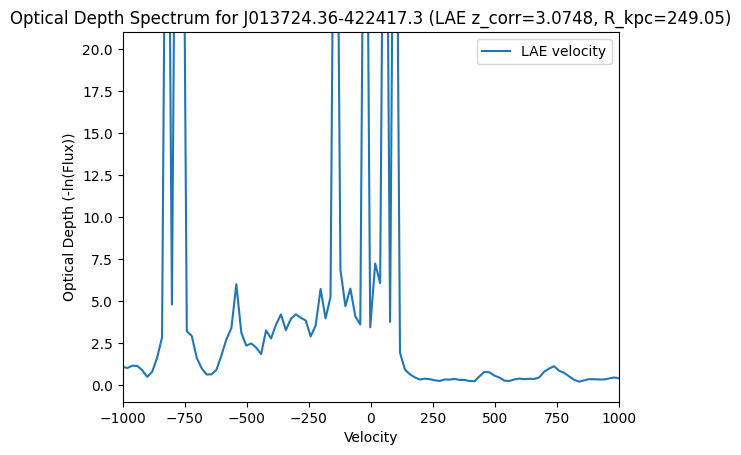

3.0876   | 6.3313 | 229.99


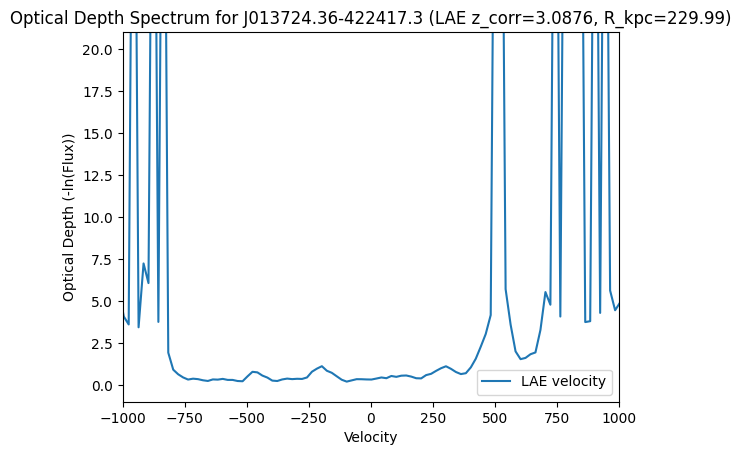

3.1217   | 6.3313 | 129.19


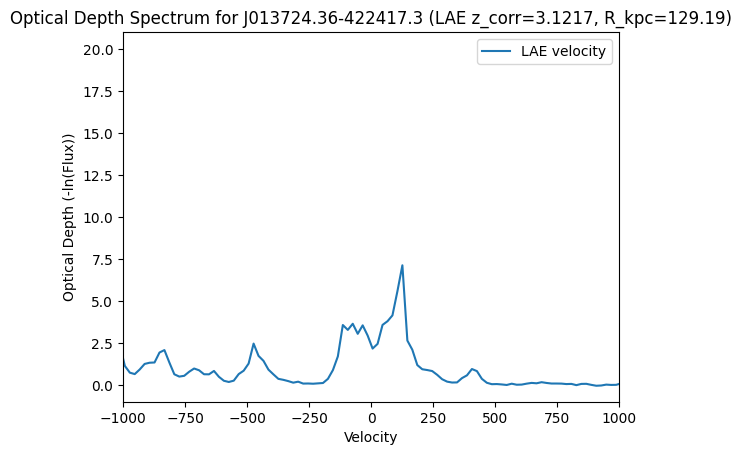

3.1278   | 6.3313 | 202.91


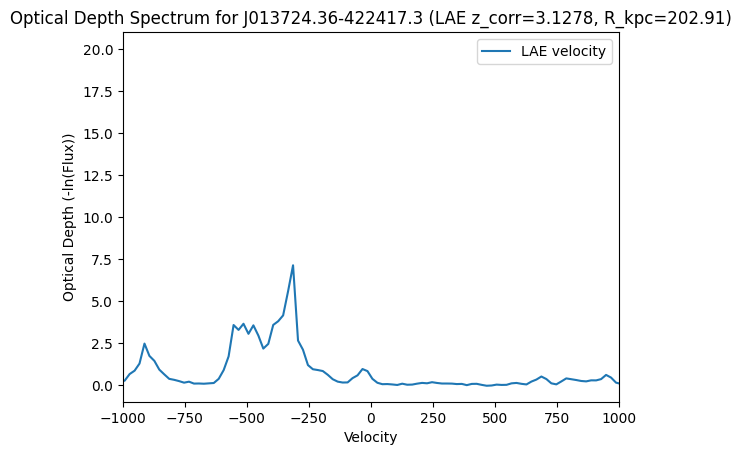

3.1524   | 6.3313 | 149.08


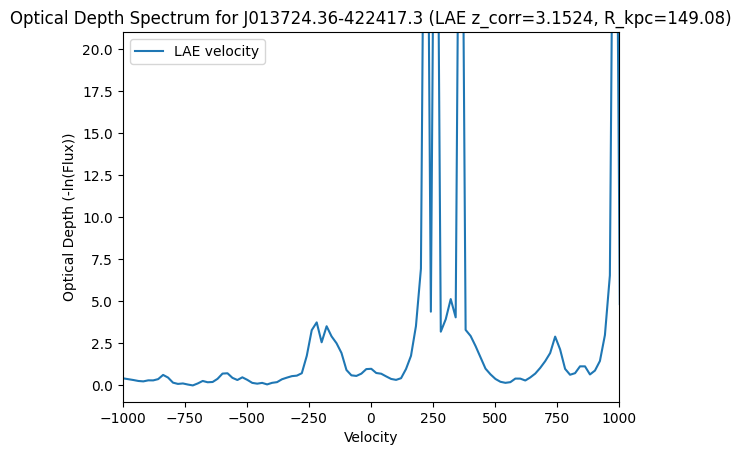

3.1556   | 6.3313 | 44.85


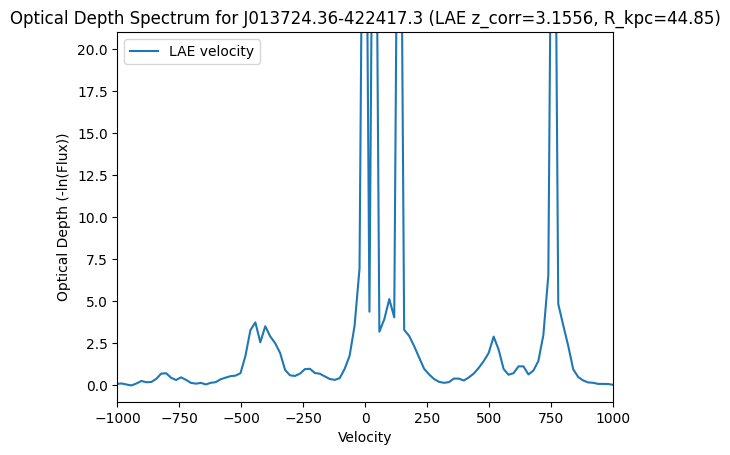

3.1549   | 6.3313 | 120.96


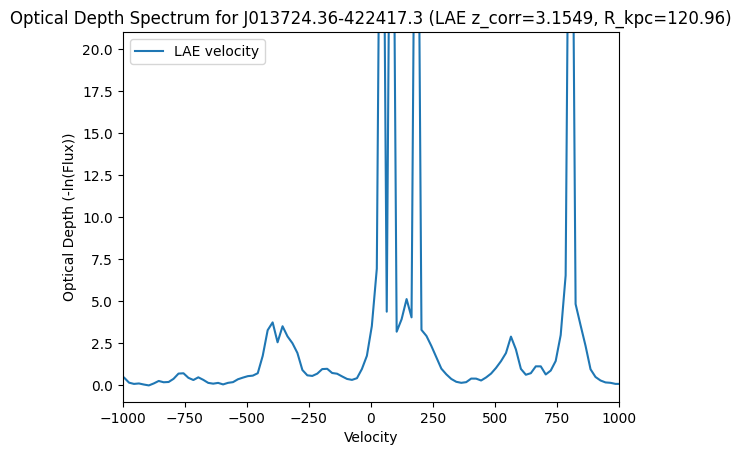

3.1670   | 6.3313 | 137.78


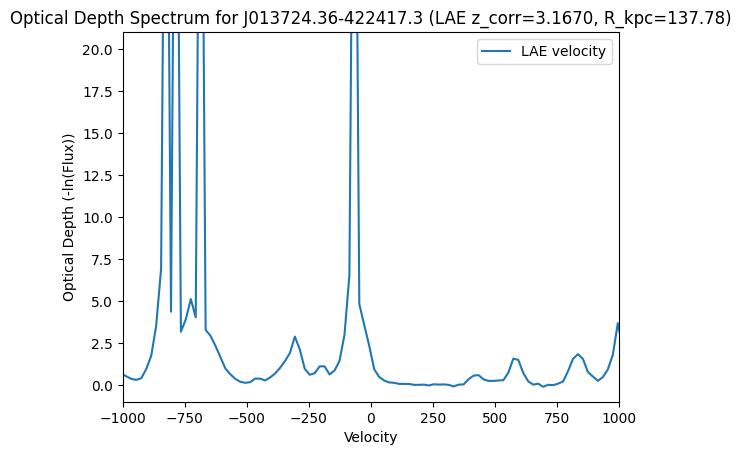

3.1659   | 6.3313 | 91.10


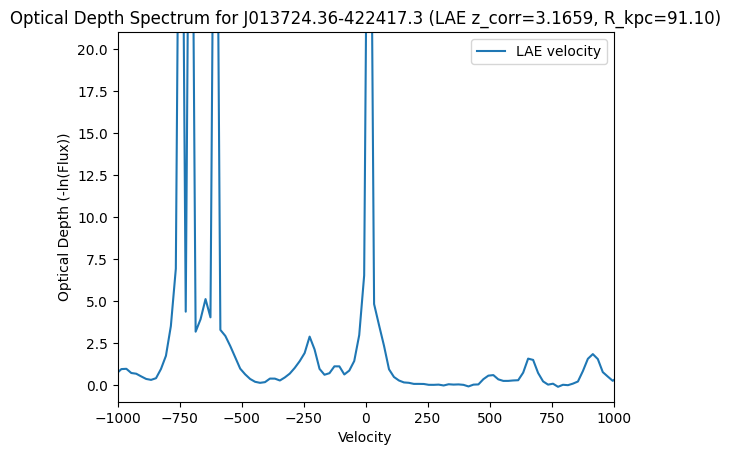

3.1660   | 6.3313 | 103.80


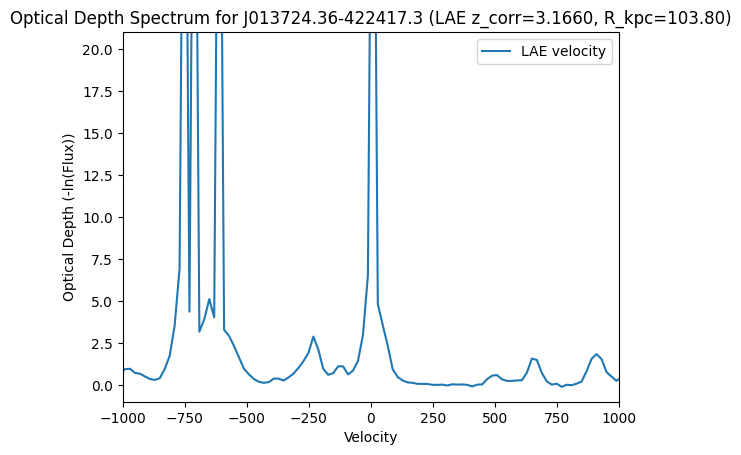

3.3216   | 6.3313 | 171.20


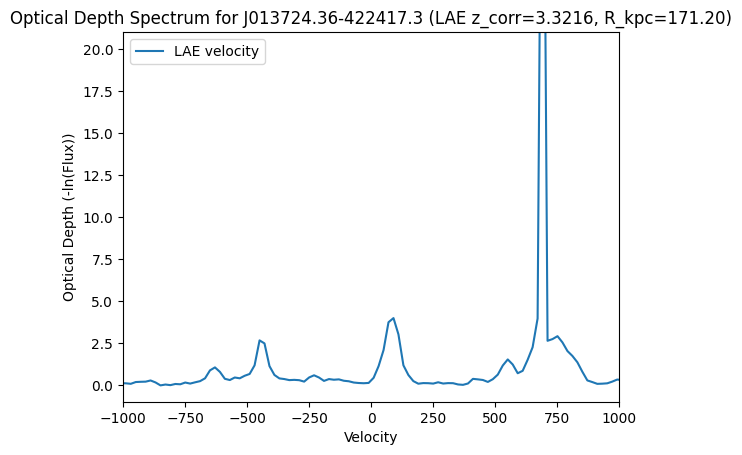

3.4411   | 6.3313 | 214.82


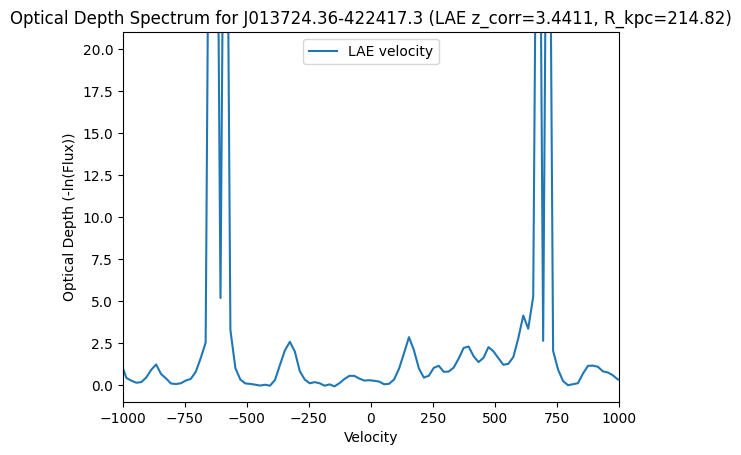

3.5203   | 6.3313 | 42.01


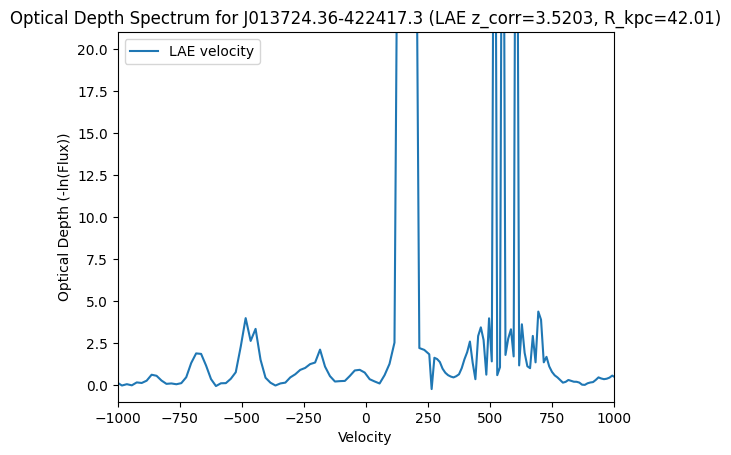

3.5448   | 6.3313 | 293.61


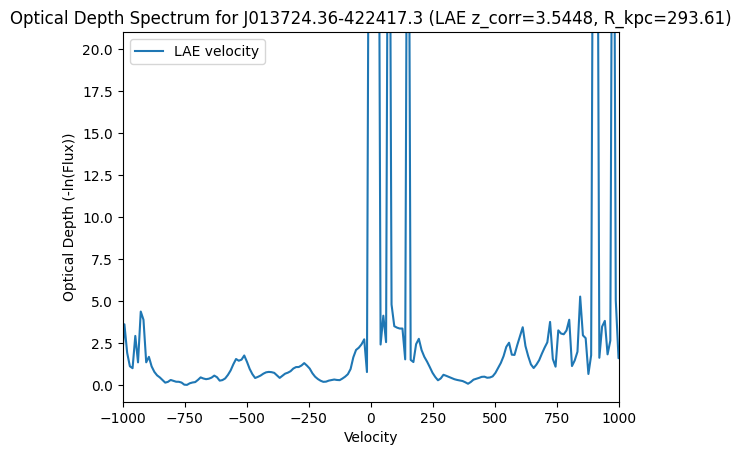

3.5477   | 6.3313 | 265.55


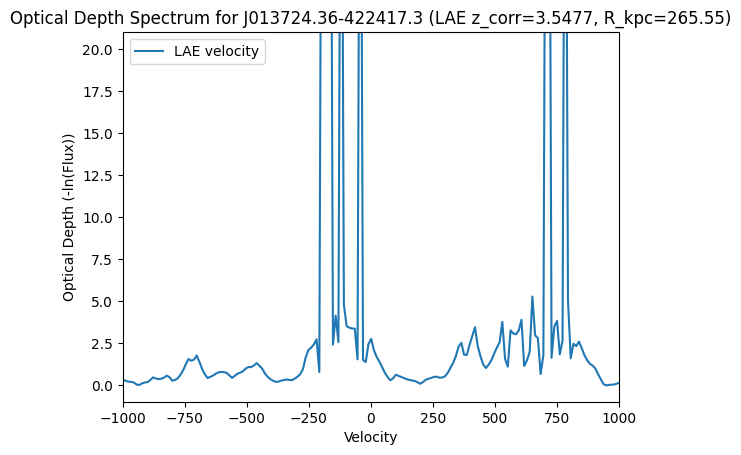

3.5544   | 6.3313 | 218.19


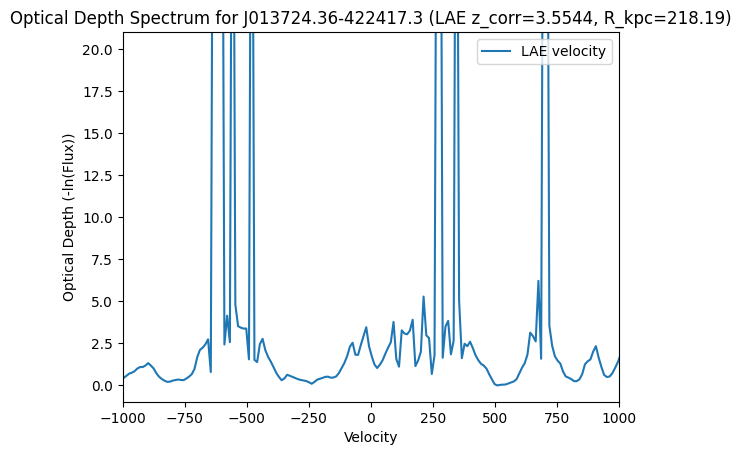

3.5615   | 6.3313 | 116.91


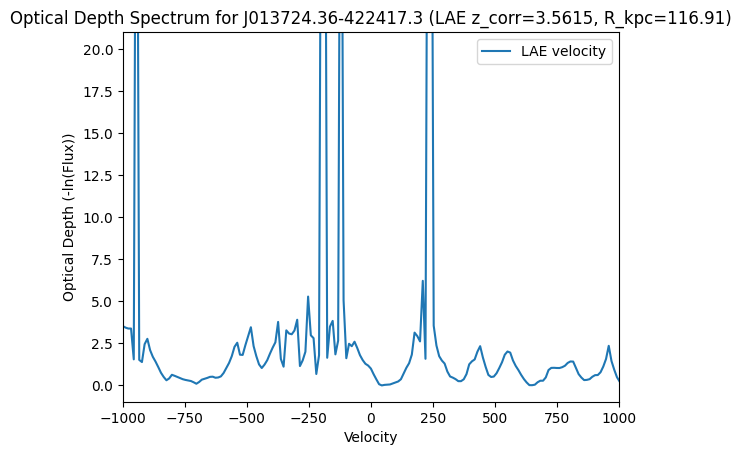

3.6037   | 6.3313 | 103.41


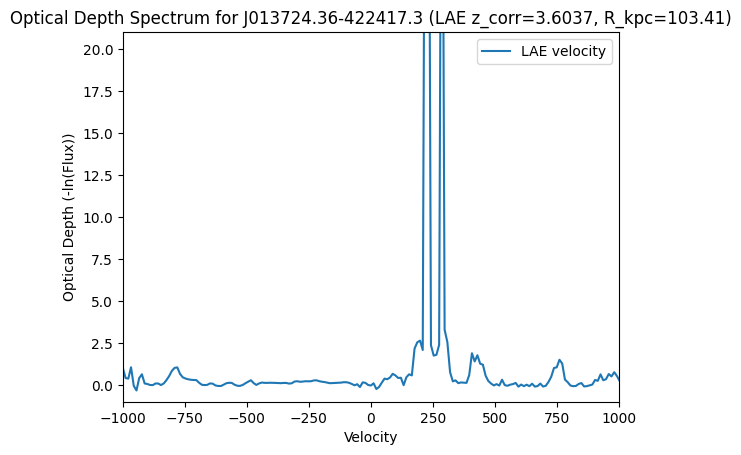

3.6047   | 6.3313 | 84.08


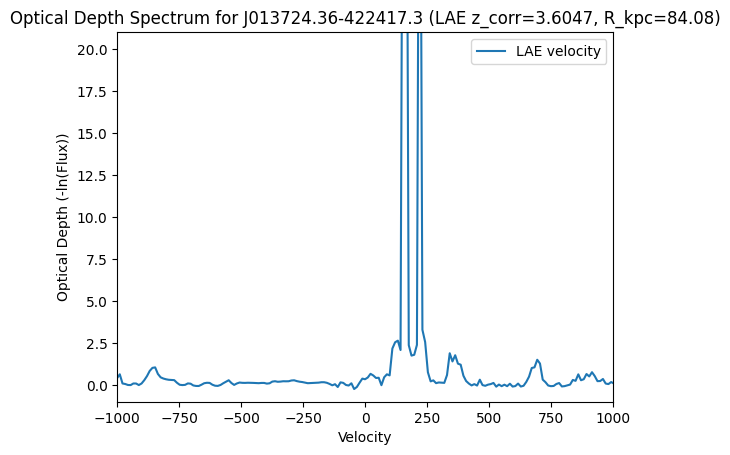

3.6705   | 6.3313 | 80.05


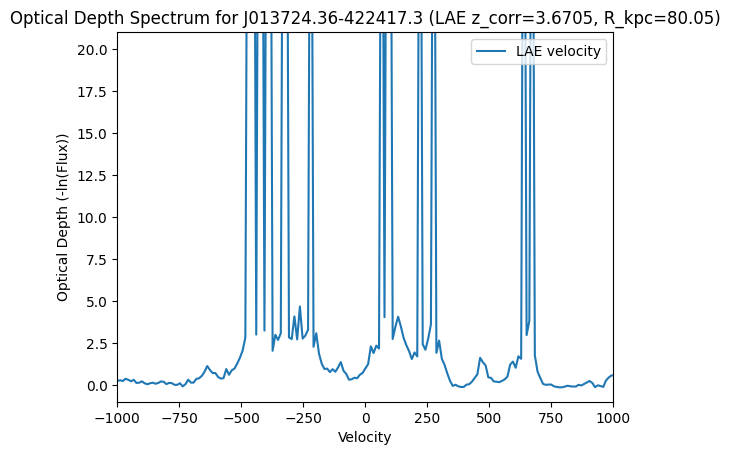


--- Quasar: J015741.56-010629.6 (z_QSO=3.5645) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8365   | No data in range | 136.90


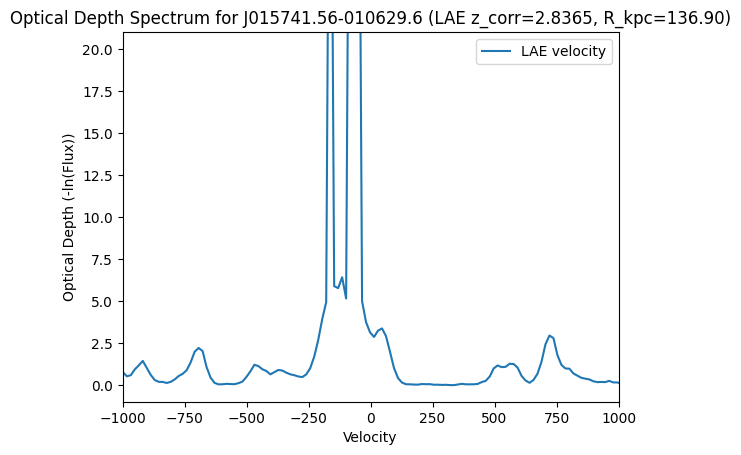

2.9632   | No data in range | 45.05


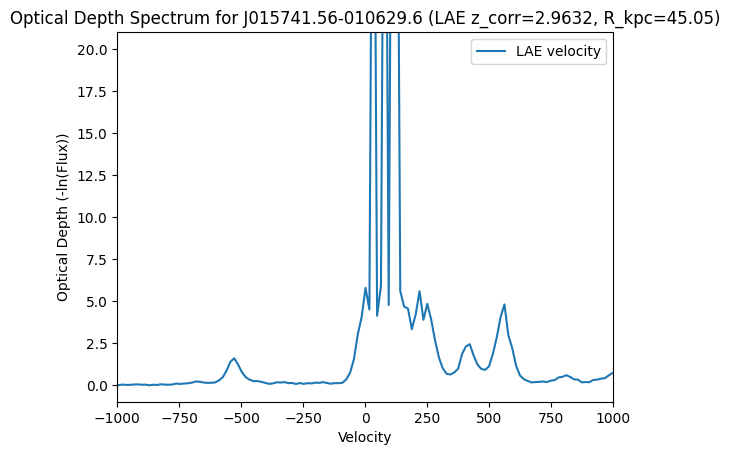

2.9646   | No data in range | 132.04


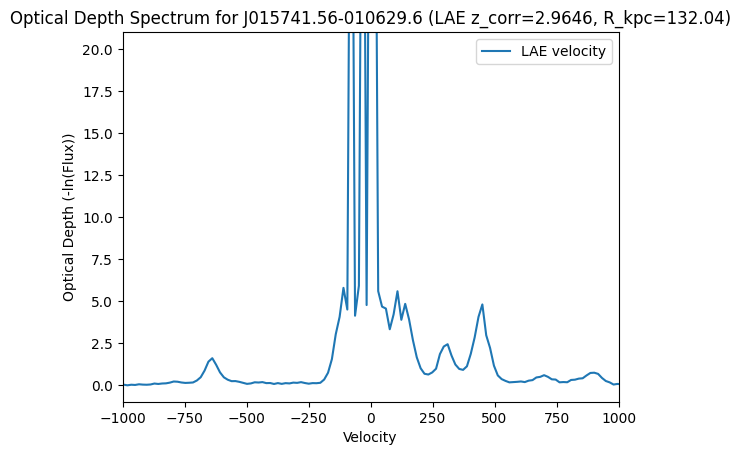

3.0894   | No data in range | 109.23


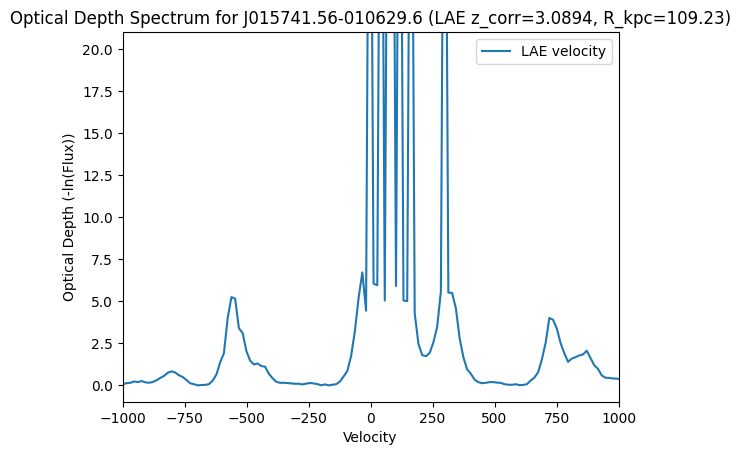

3.1684   | No data in range | 139.82


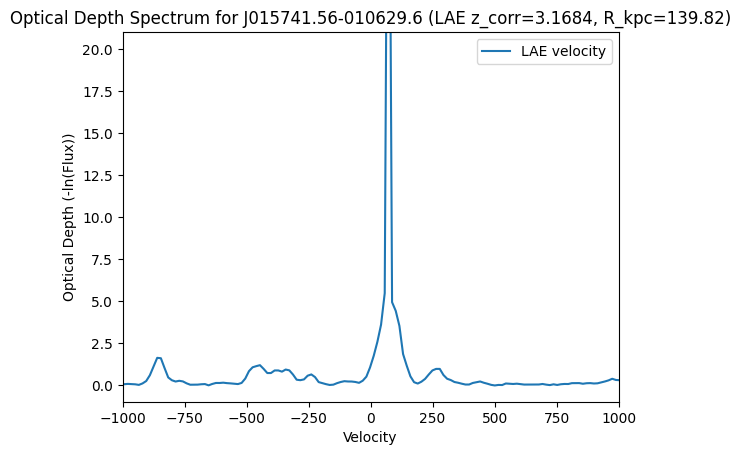

3.2588   | No data in range | 203.13


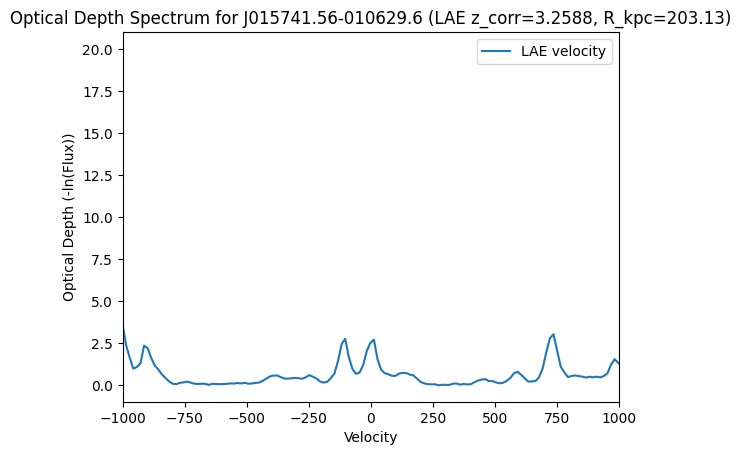

3.3586   | No data in range | 128.37


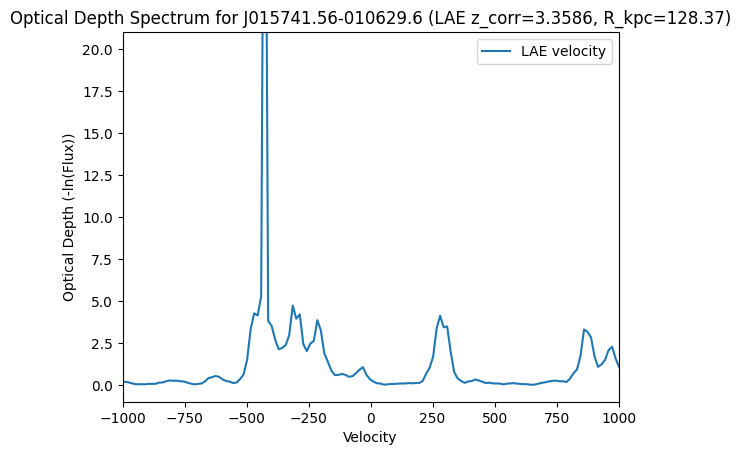

3.3710   | No data in range | 183.71


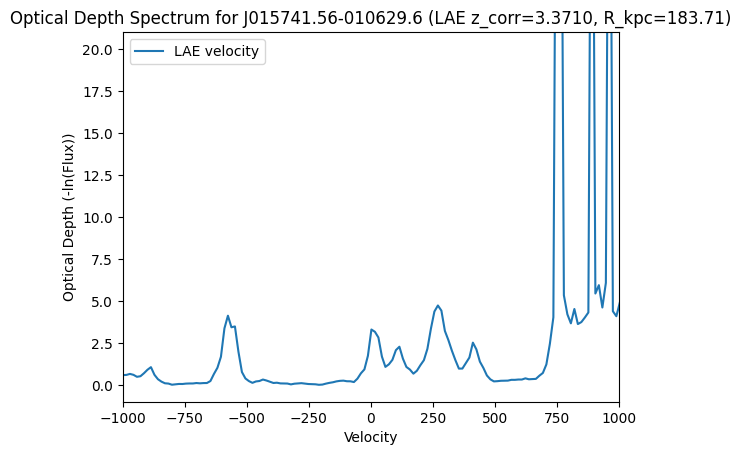

3.3738   | No data in range | 189.24


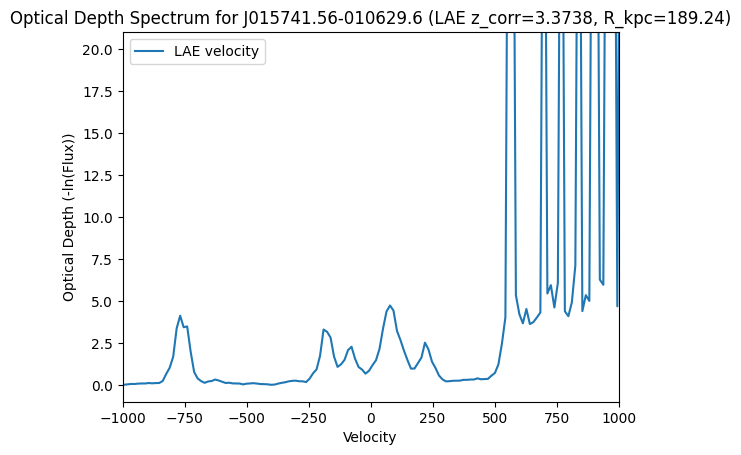

3.3890   | No data in range | 133.45


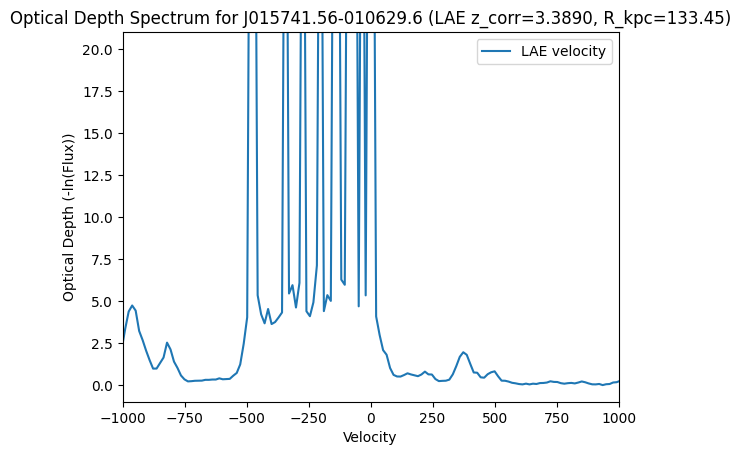

3.3875   | No data in range | 206.80


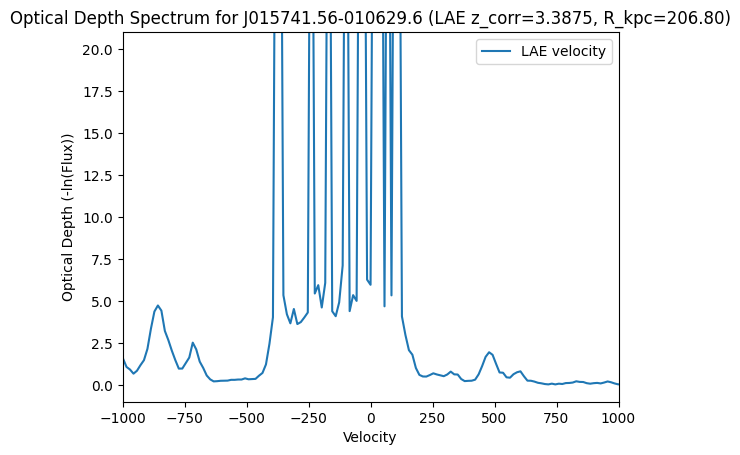

3.3886   | No data in range | 103.76


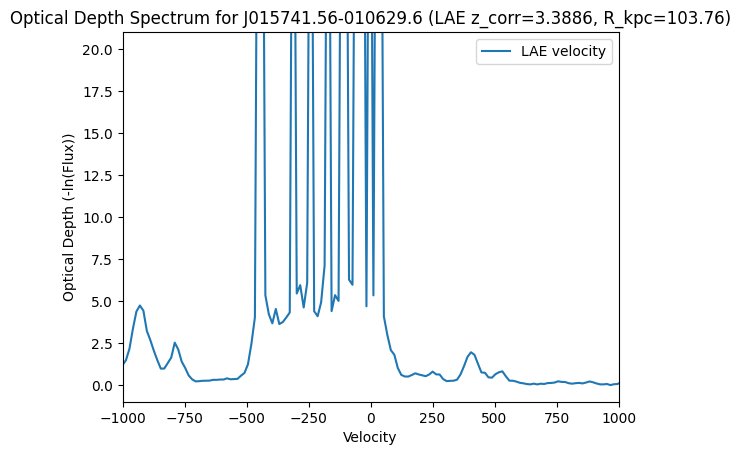

3.3883   | No data in range | 30.86


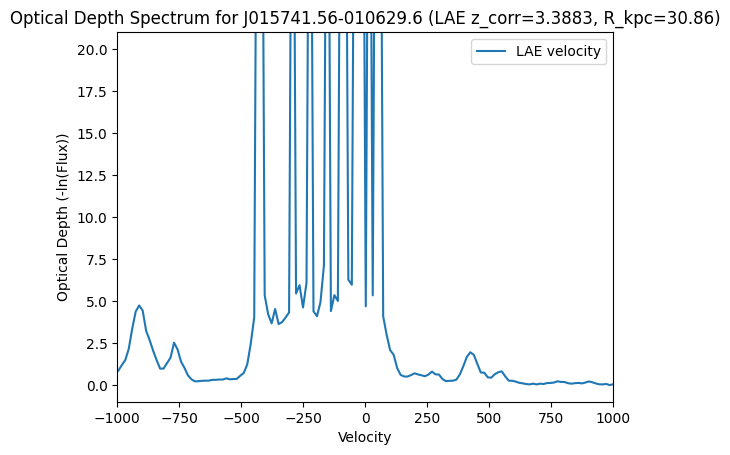

3.3886   | No data in range | 79.05


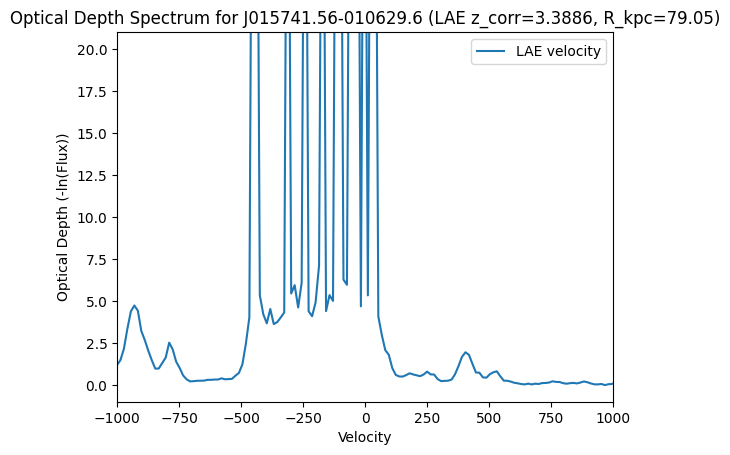

3.5230   | No data in range | 76.63


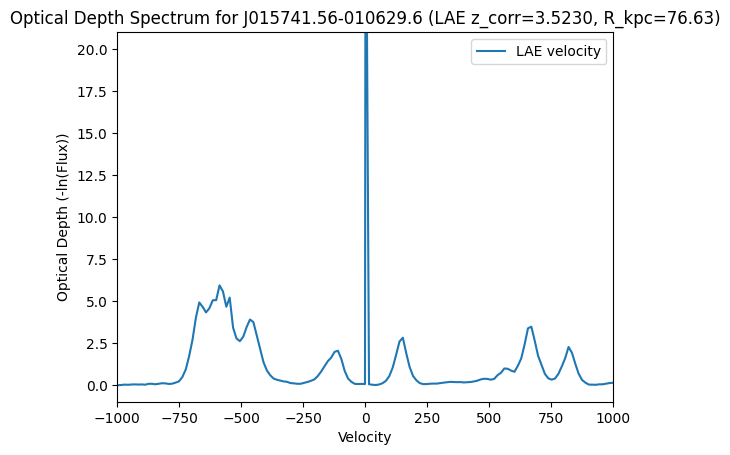

3.5404   | No data in range | 161.19


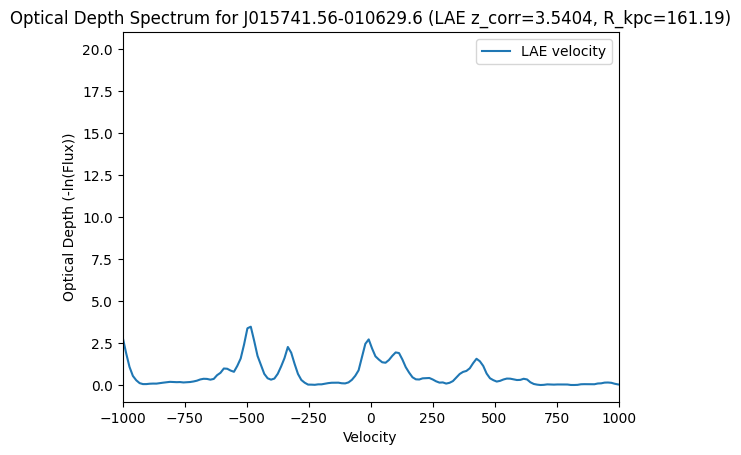


--- Quasar: J020944.61+051713.6 (z_QSO=4.1846) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8329   | 6.3313 | 96.49


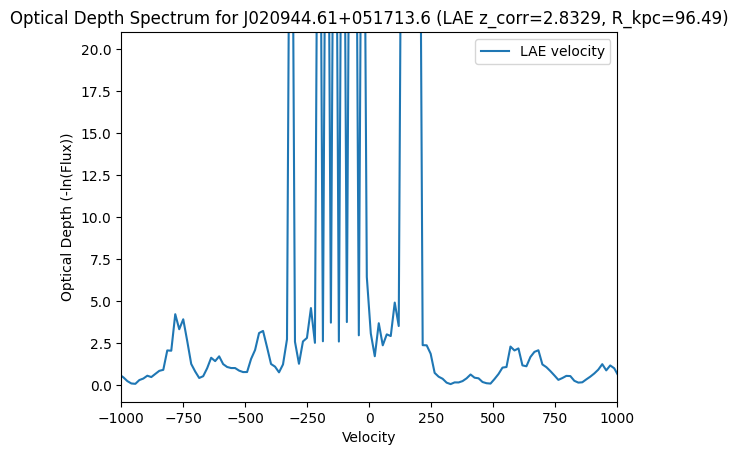

2.9305   | 6.3313 | 211.77


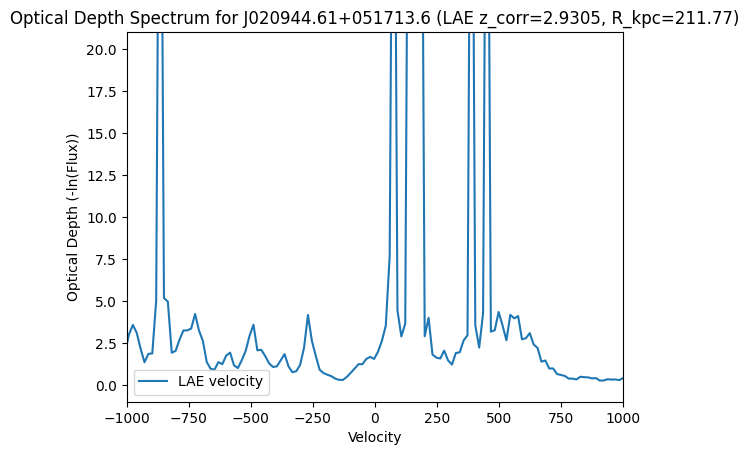

3.1052   | 6.3313 | 142.17


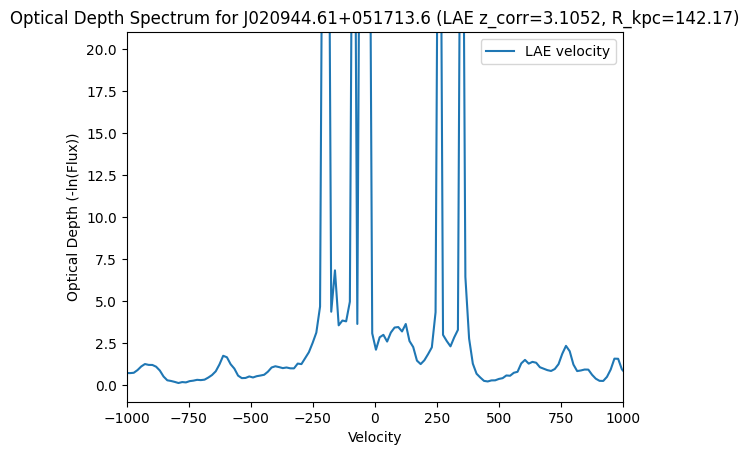

3.1698   | 6.3313 | 212.20


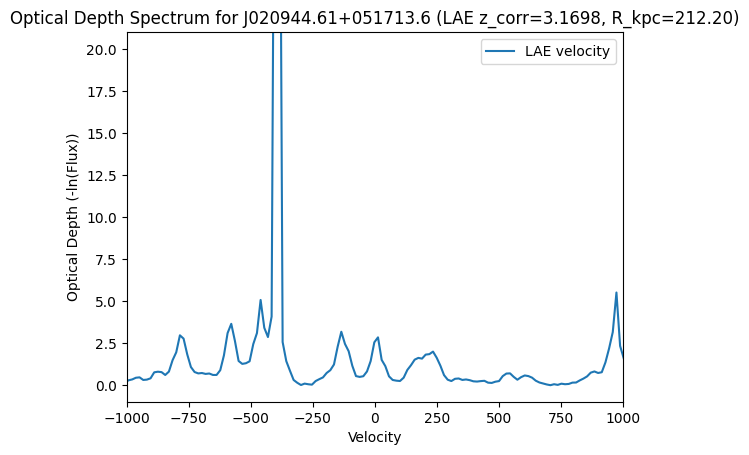

3.2456   | 6.3313 | 185.39


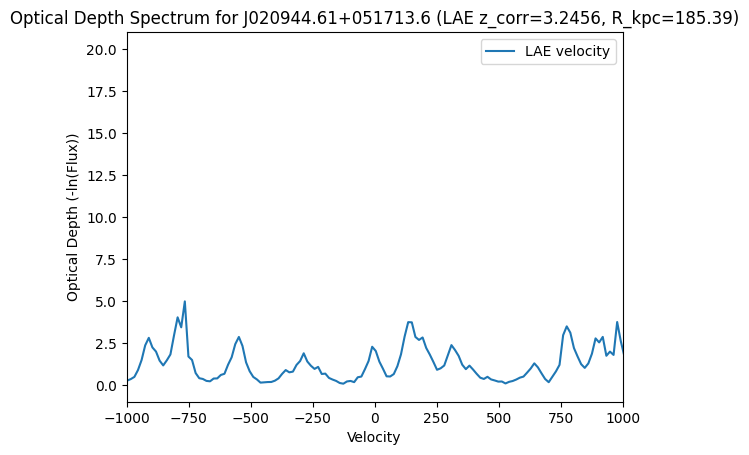

3.2570   | 6.3313 | 189.82


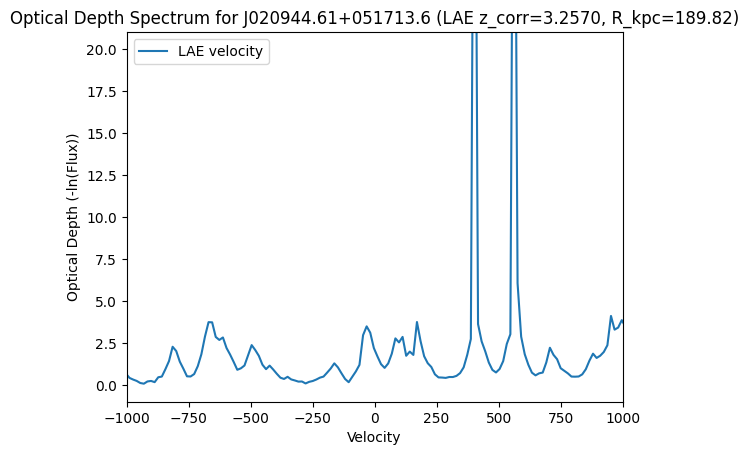

3.4396   | 6.3313 | 172.76


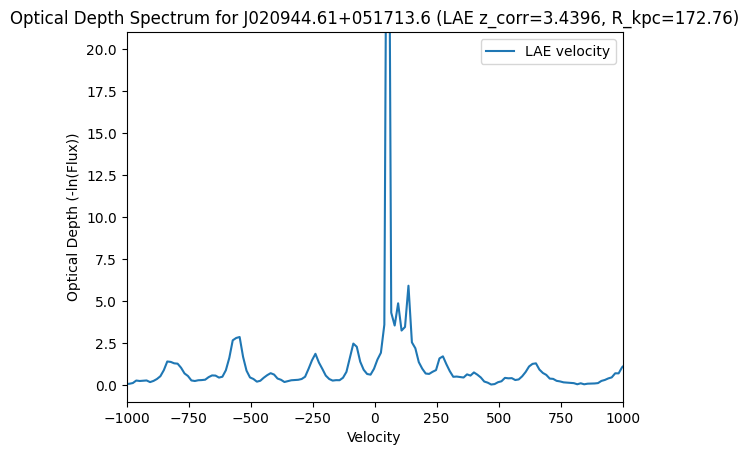

3.7085   | 6.3313 | 128.81


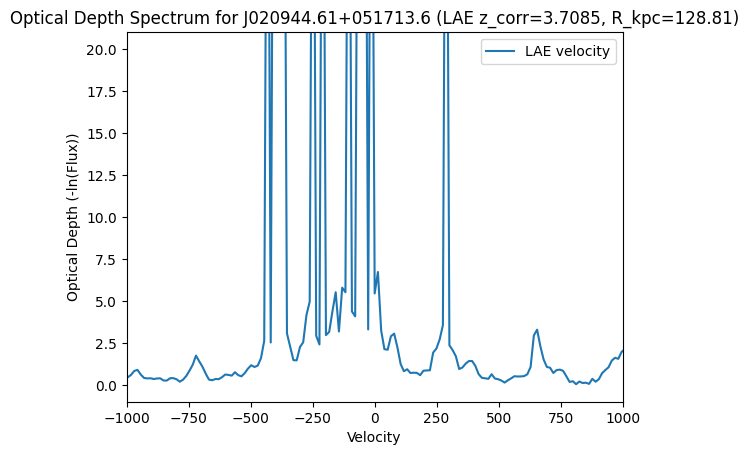


--- Quasar: J024401.84-013403.7 (z_QSO=4.0440) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8557   | 6.3313 | 114.79


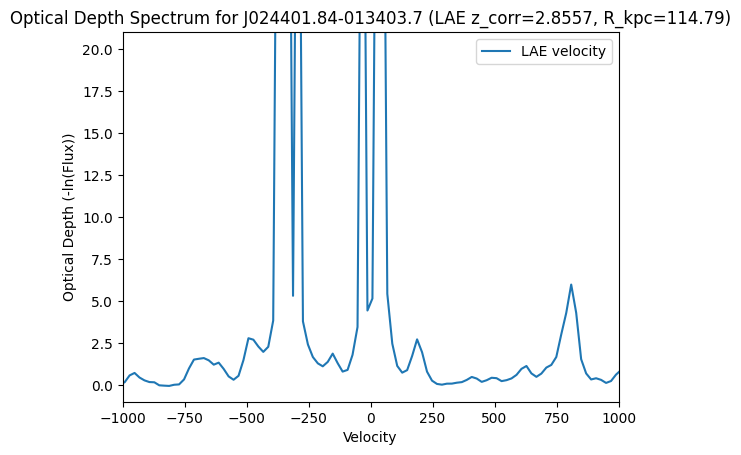

3.1188   | 6.3313 | 203.43


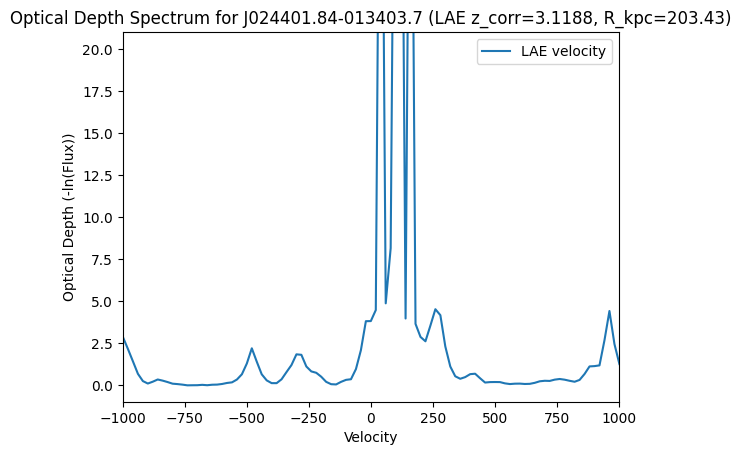

3.1225   | 6.3313 | 95.08


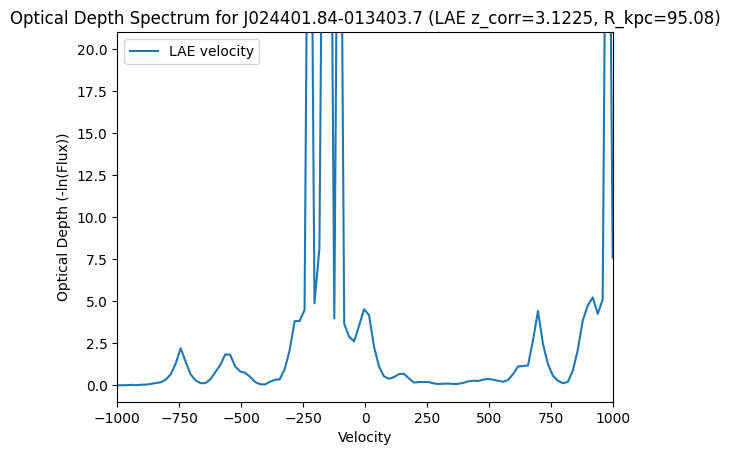

3.1353   | 6.3313 | 216.91


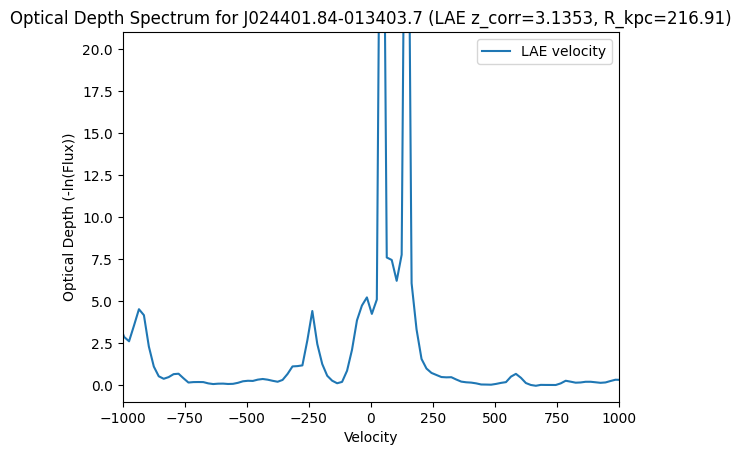

3.1353   | 6.3313 | 195.69


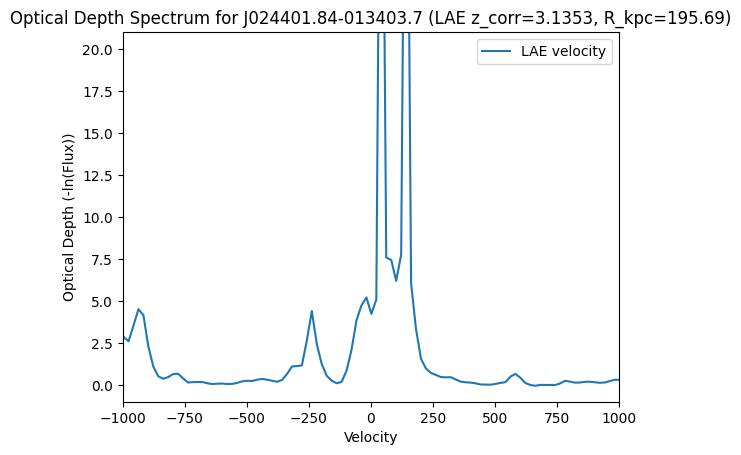

3.3470   | 6.3313 | 213.58


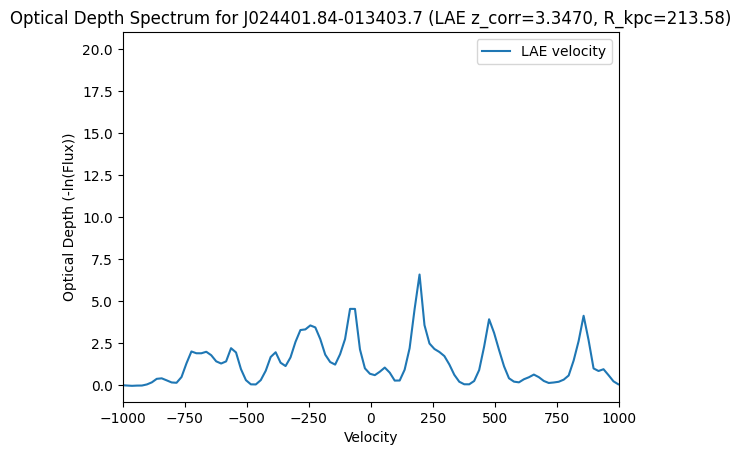

3.3963   | 6.3313 | 94.32


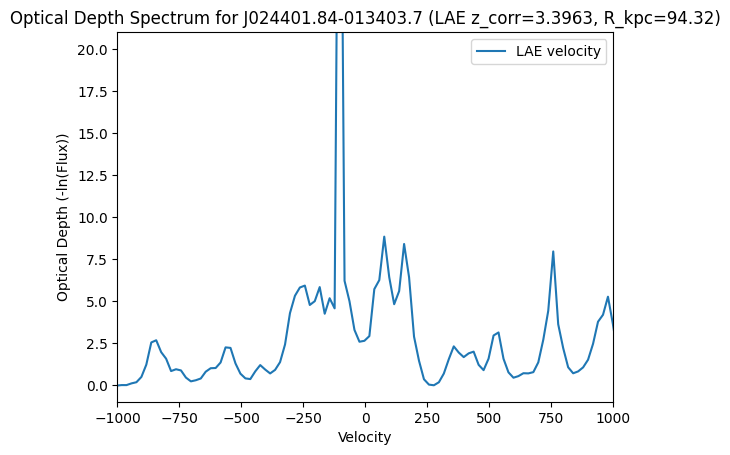

3.4076   | 6.3313 | 254.39


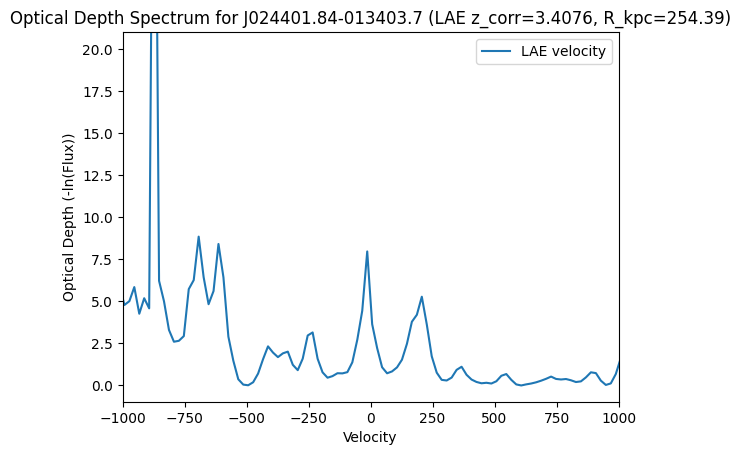

3.4085   | 6.3313 | 215.77


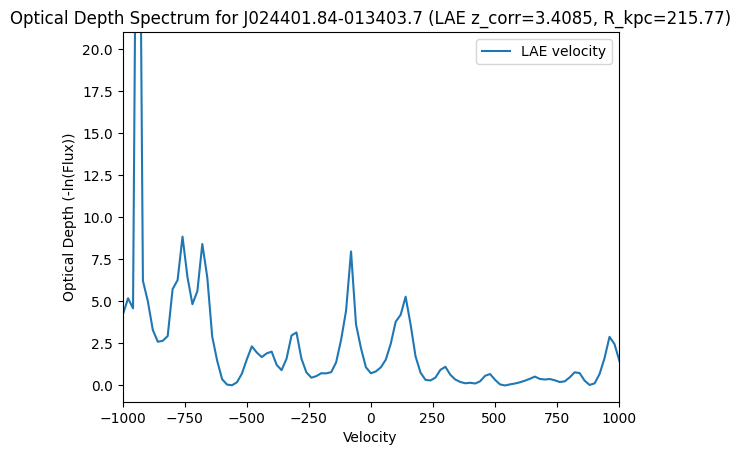

3.4323   | 6.3313 | 181.57


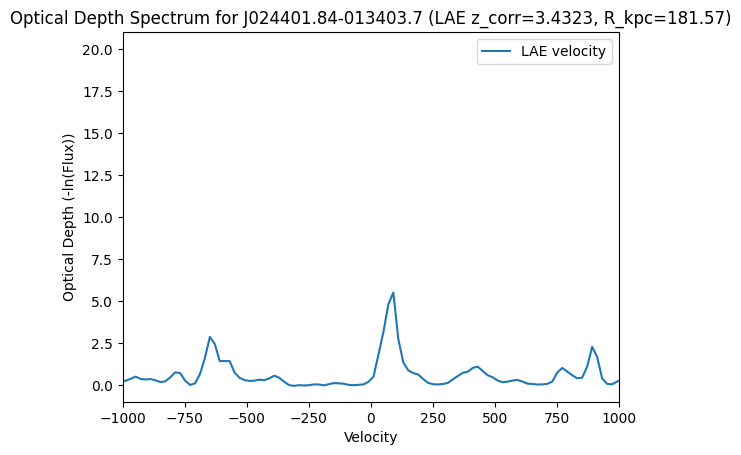

3.5937   | 6.3313 | 212.59


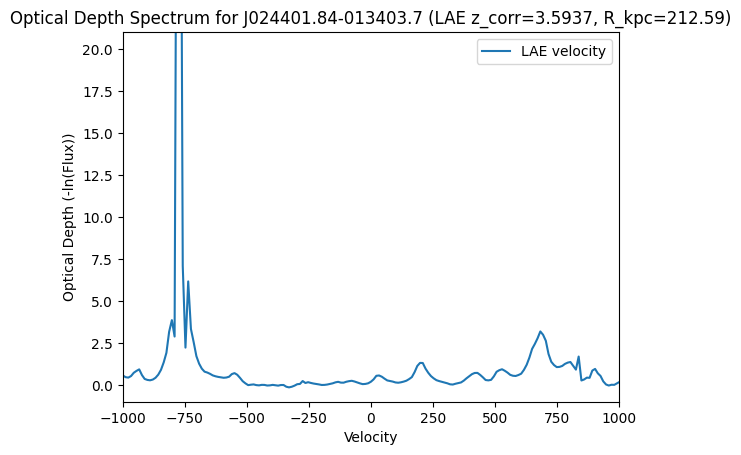

3.6111   | 6.3313 | 161.80


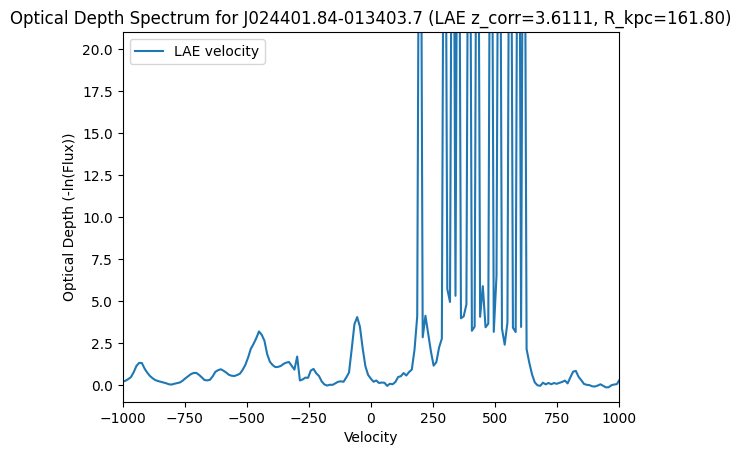

3.6162   | 6.3313 | 105.92


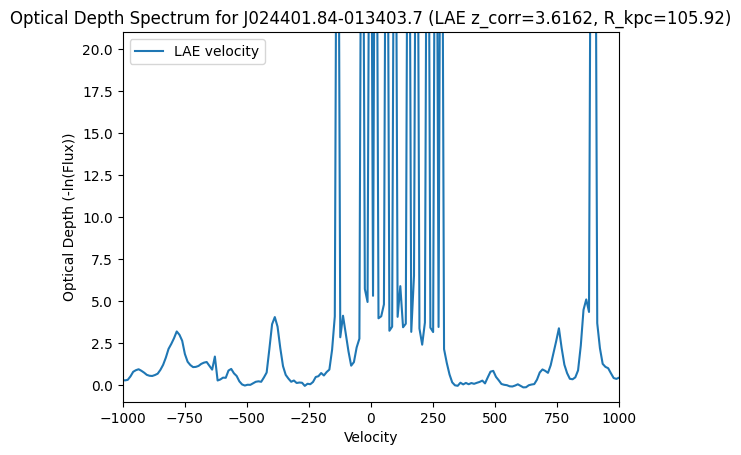

3.6388   | 6.3313 | 24.62


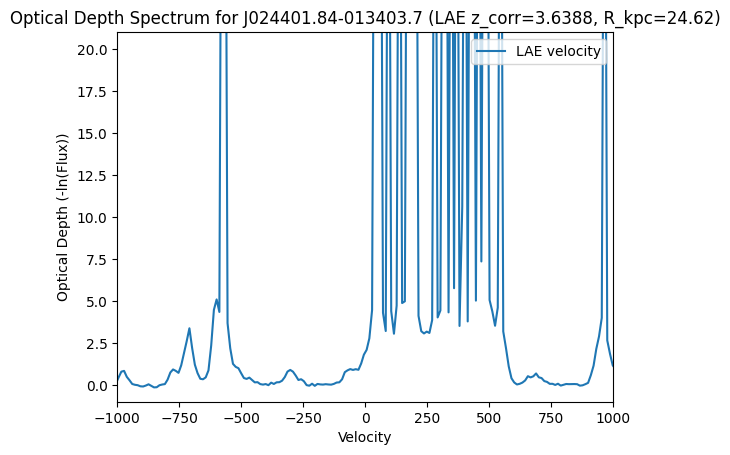

3.6450   | 6.3313 | 166.96


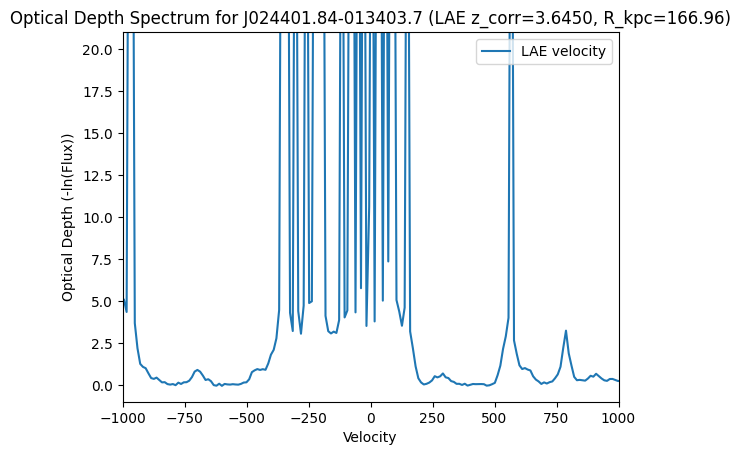

3.7357   | 6.3313 | 200.73


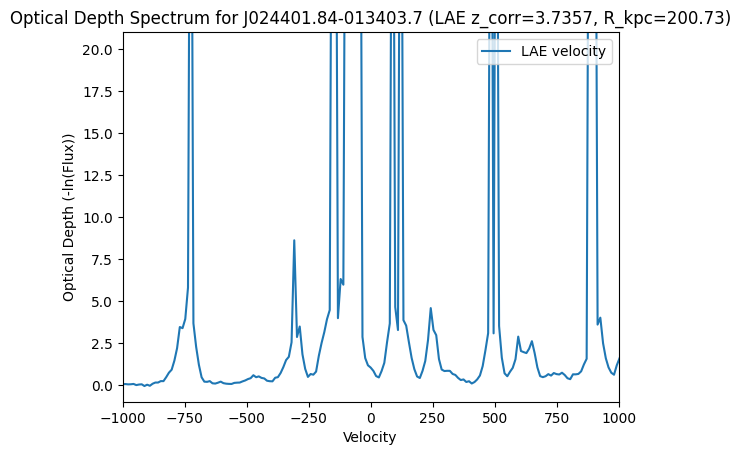

3.7333   | 6.3313 | 221.92


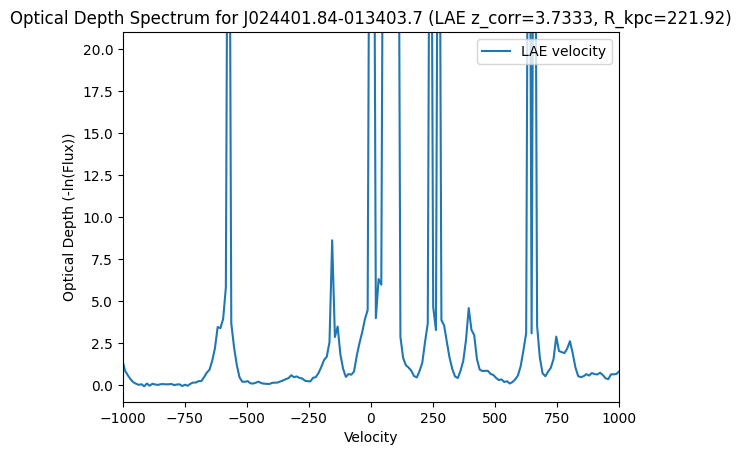

3.7478   | 6.3313 | 119.58


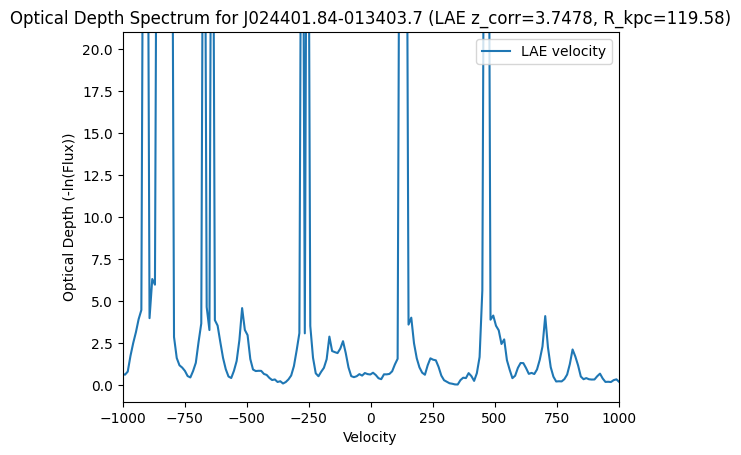


--- Quasar: J033413.42-161205.4 (z_QSO=4.3800) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8599   | 6.3313 | 229.17


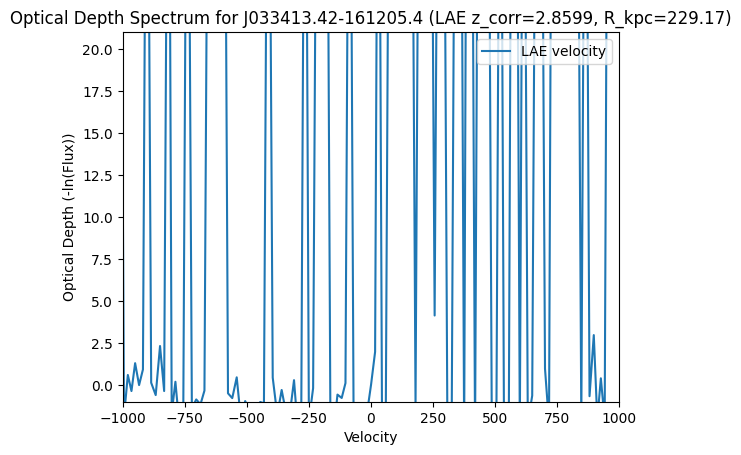

2.8844   | 6.3313 | 197.65


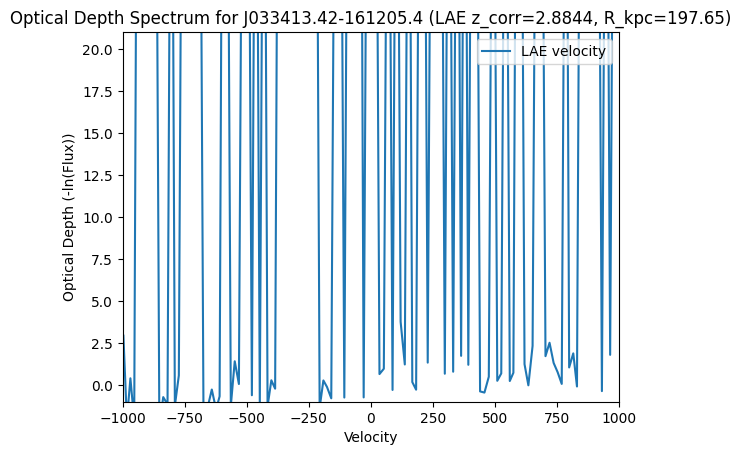

2.8849   | 6.3313 | 234.12


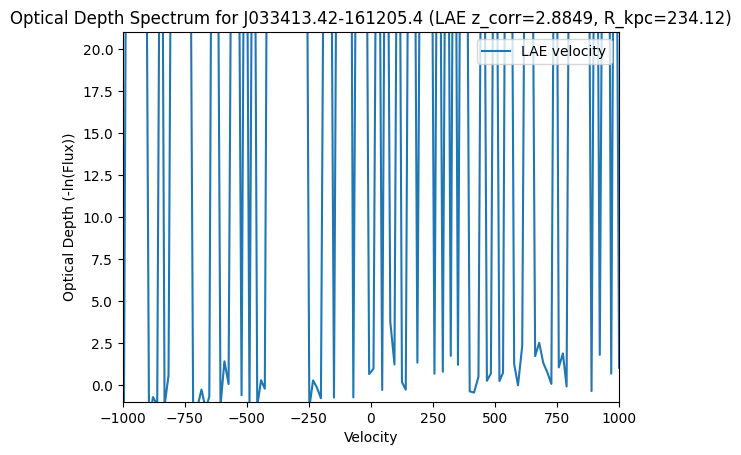

2.9273   | 6.3313 | 213.19


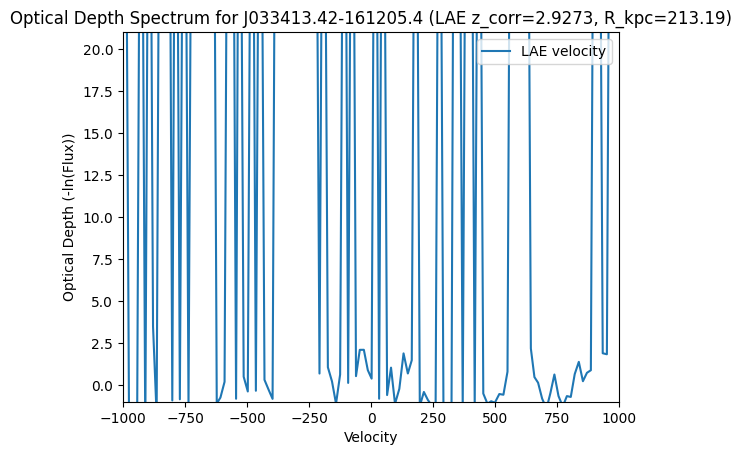

2.9258   | 6.3313 | 122.48


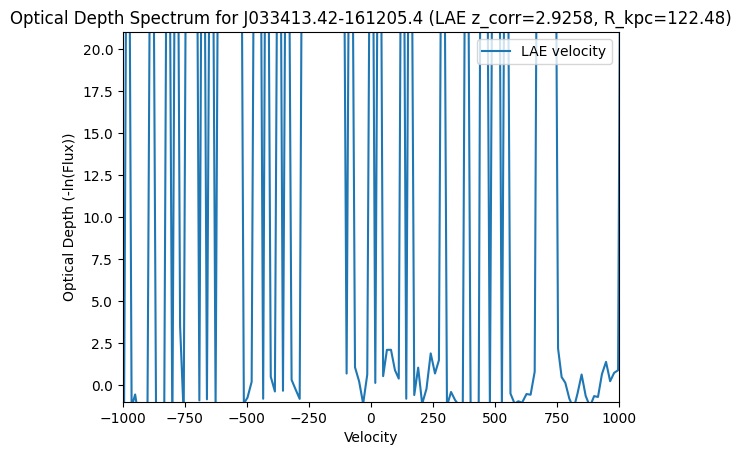

2.9279   | 6.3313 | 76.77


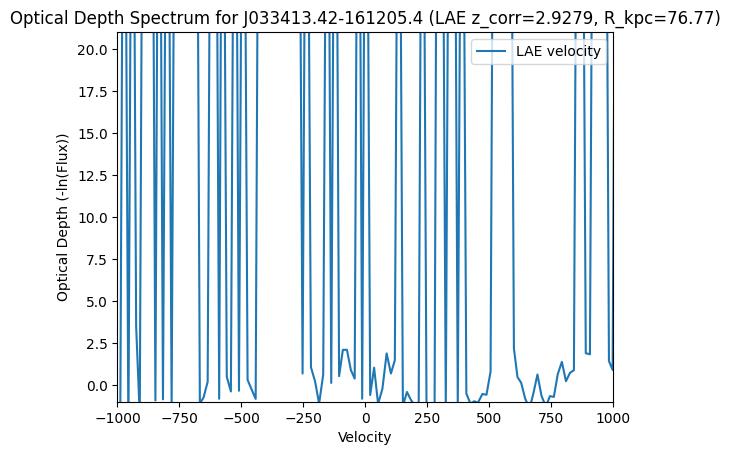

3.0533   | 6.3313 | 78.03


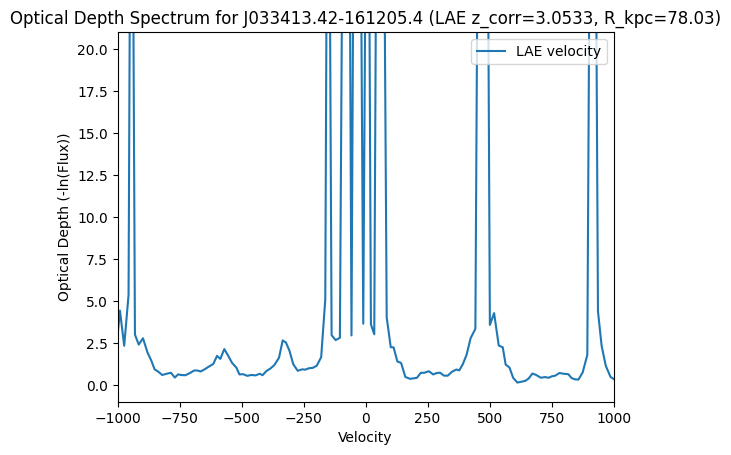

3.0960   | 6.3313 | 210.57


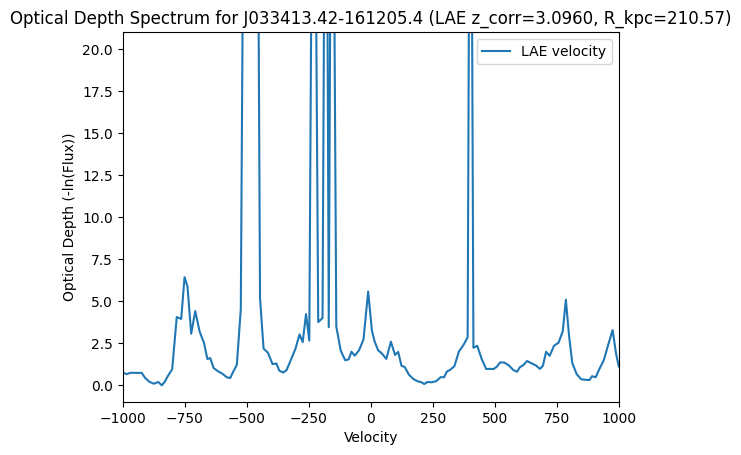

3.1606   | 6.3313 | 184.58


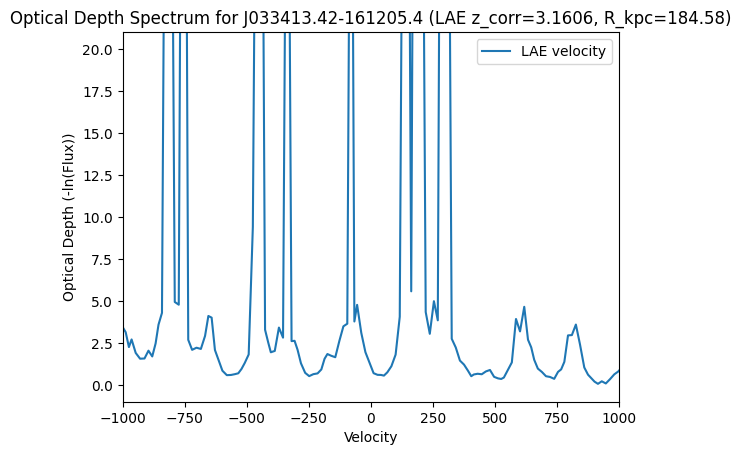

3.2356   | 6.3313 | 194.65


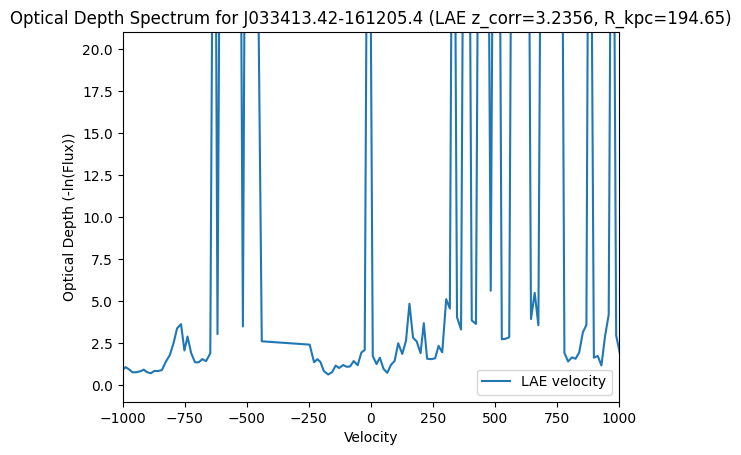

3.2942   | 6.3313 | 101.16


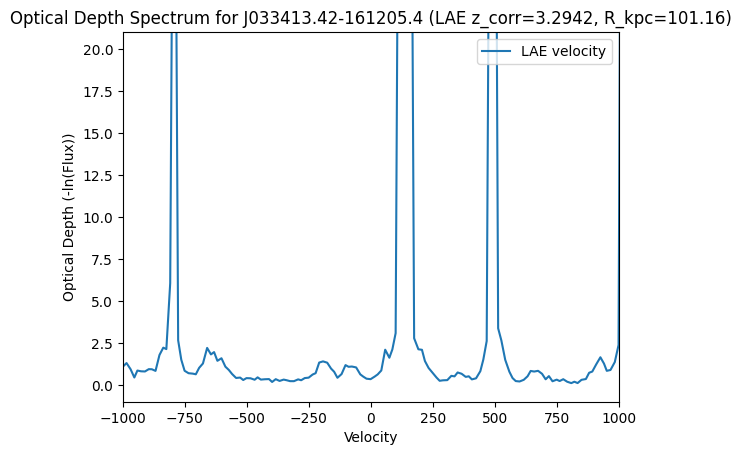

3.3889   | 6.3313 | 222.51


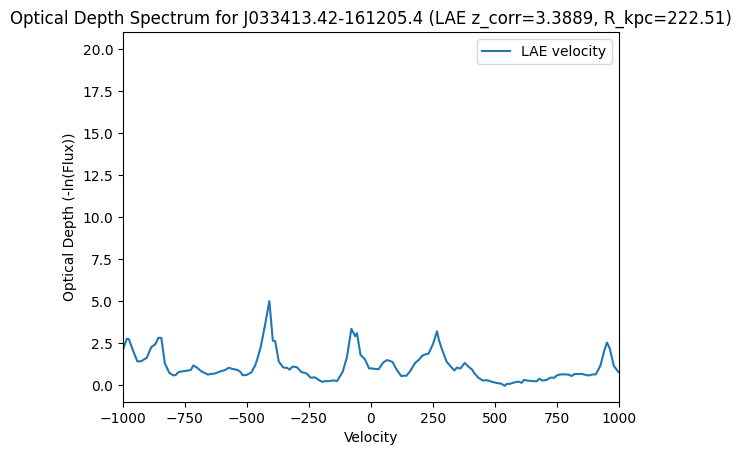

3.5750   | 6.3313 | 167.73


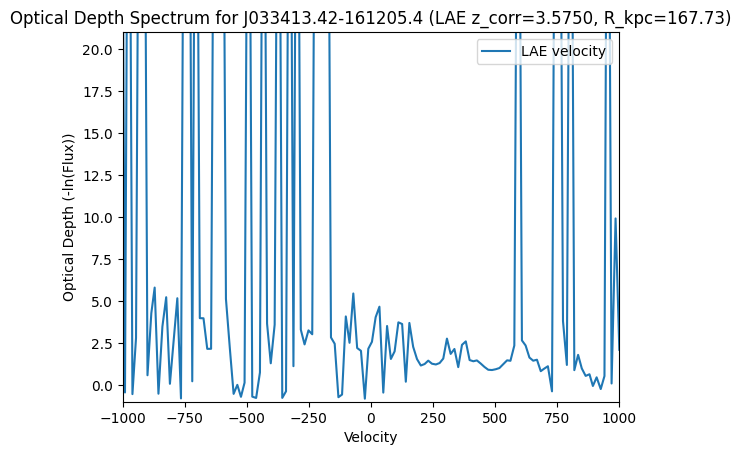

3.5698   | 6.3313 | 217.41


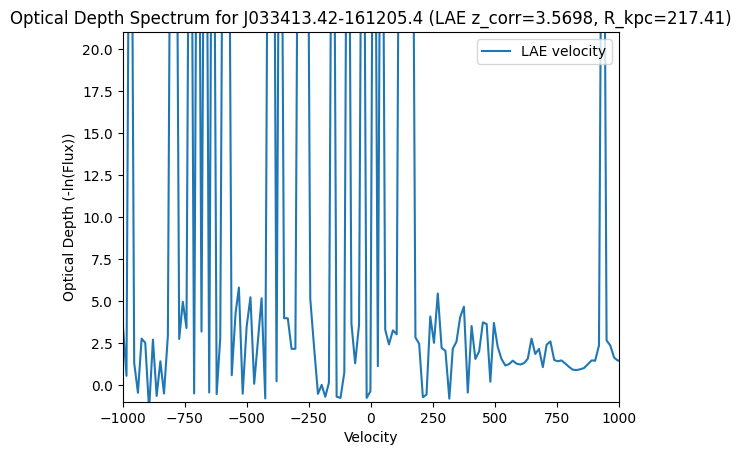

3.6075   | 6.3313 | 175.56


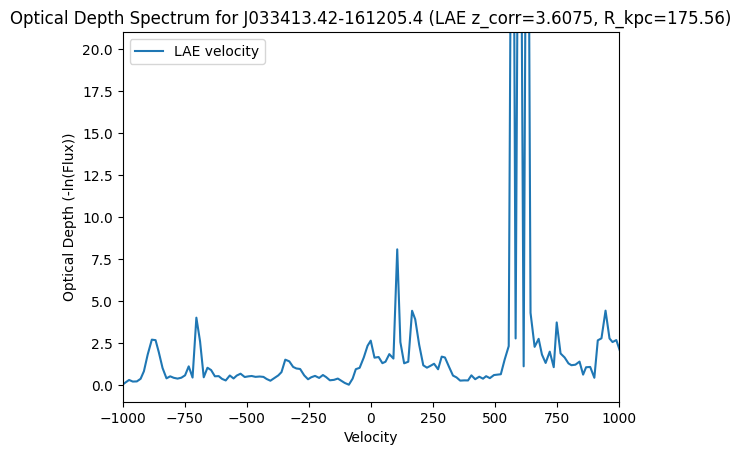

3.7597   | 6.3313 | 194.67


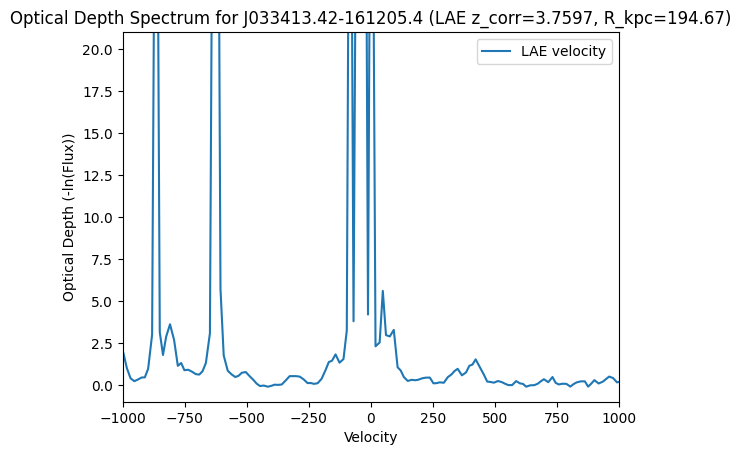


--- Quasar: J033900.98-013317.7 (z_QSO=3.2040) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8095   | No data in range | 66.99


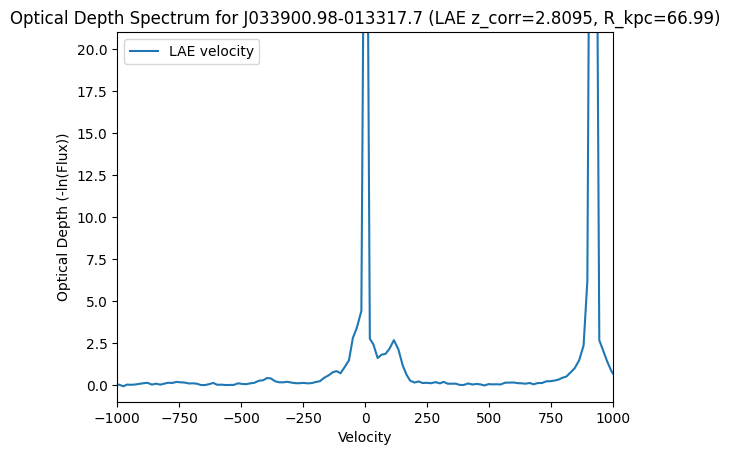

2.8350   | No data in range | 182.45


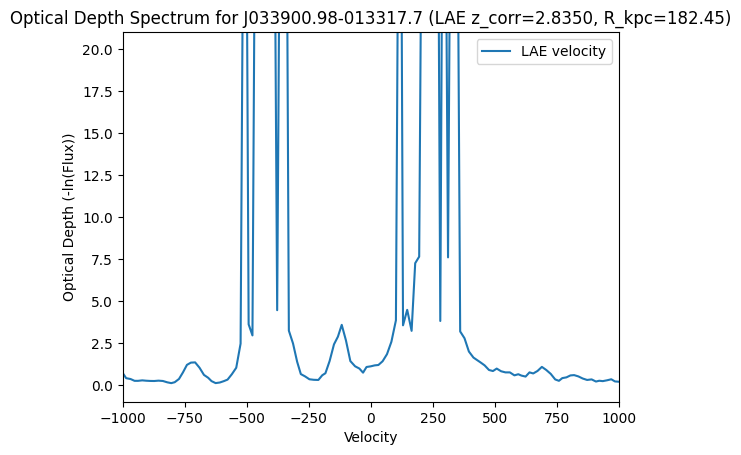

2.8348   | No data in range | 250.04


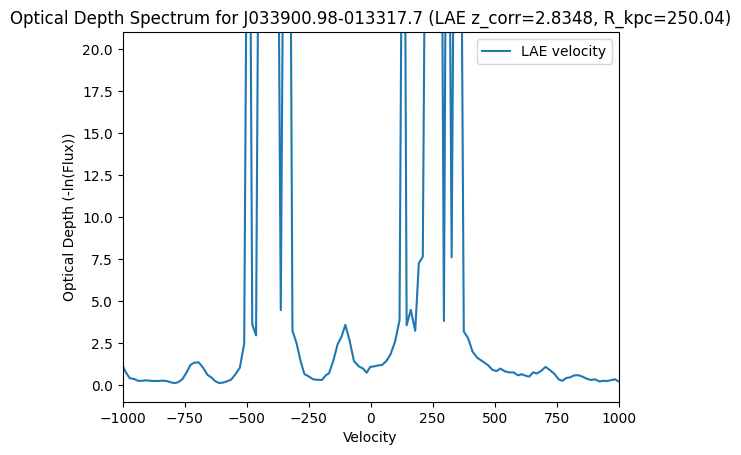

3.0413   | No data in range | 184.77


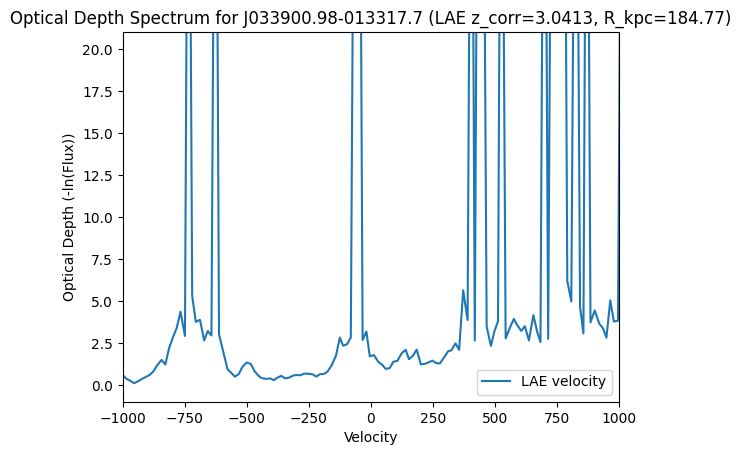

3.0757   | No data in range | 224.37


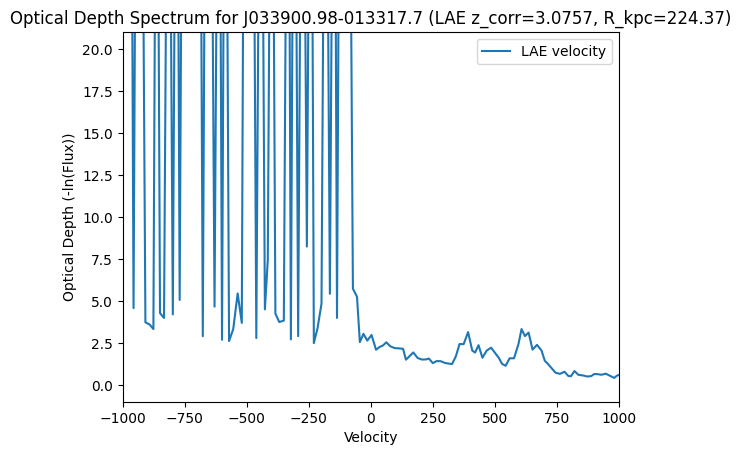

3.0845   | No data in range | 134.41


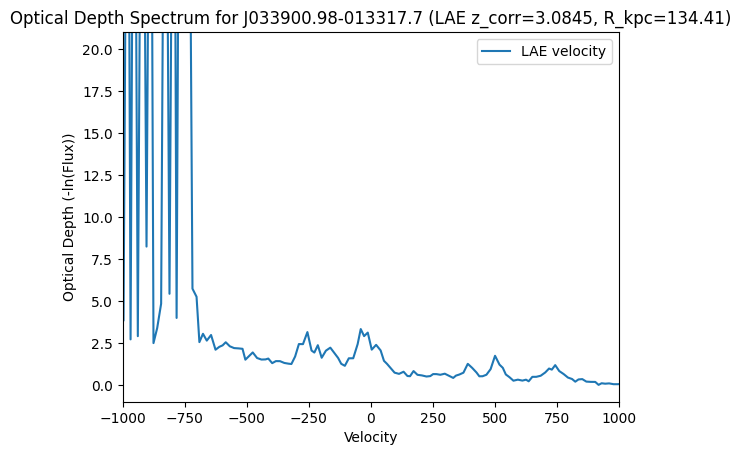

3.1914   | No data in range | 186.44


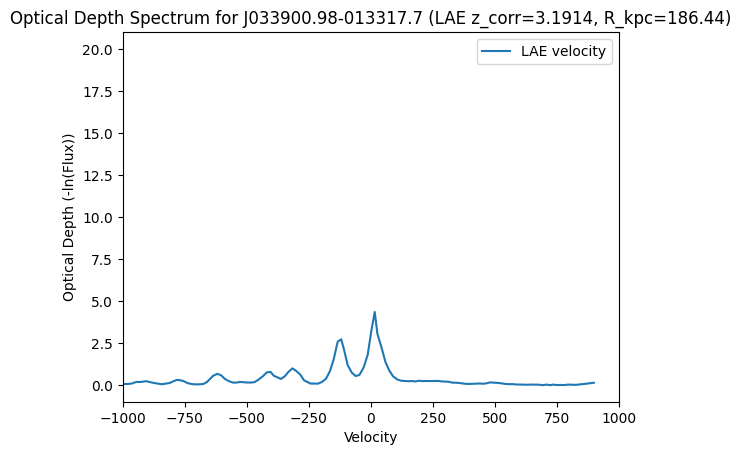

3.2035   | No data in range | 185.65


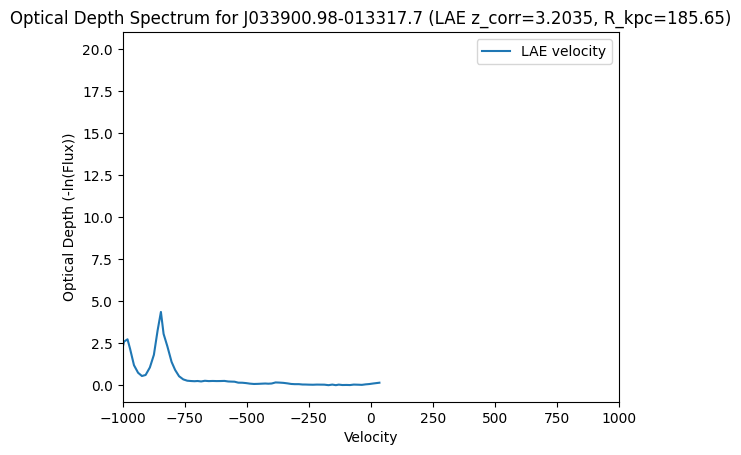

3.2022   | No data in range | 181.68


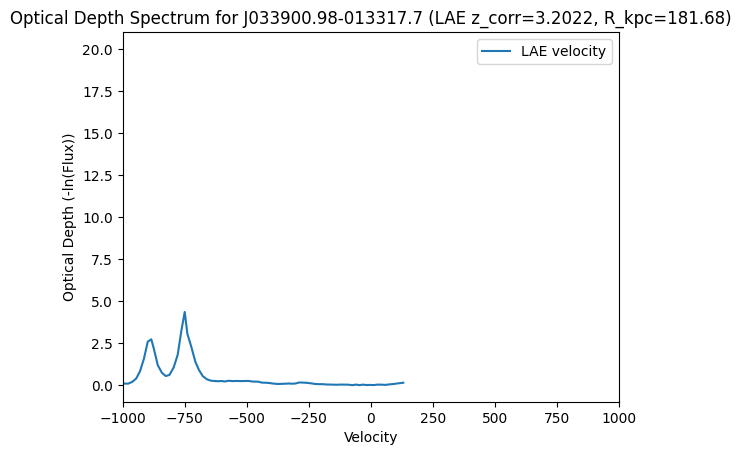

3.2008   | No data in range | 229.24


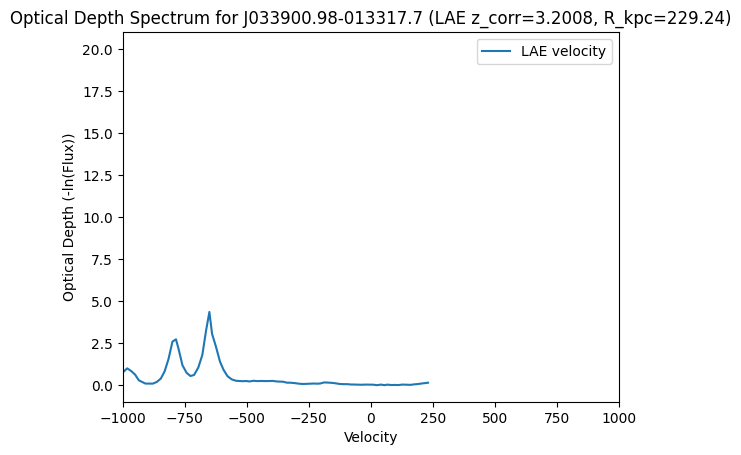

3.1990   | No data in range | 205.76


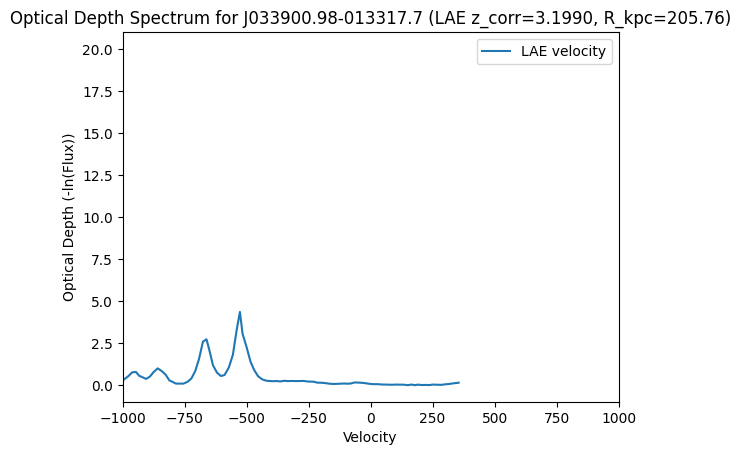

3.2028   | No data in range | 262.17


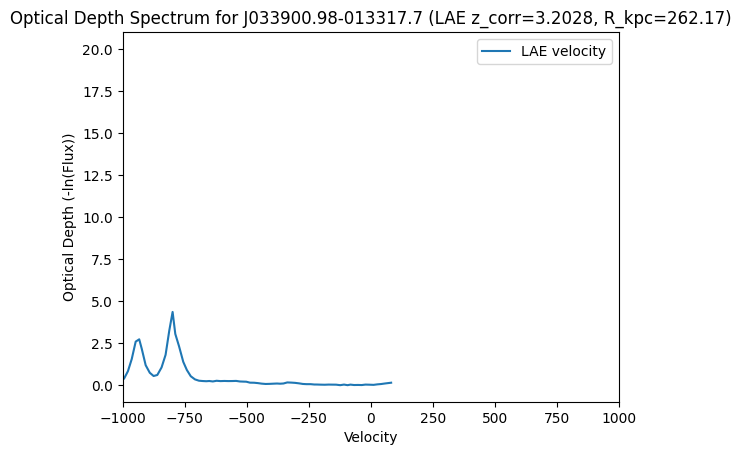


--- Quasar: J094932.26+033531.7 (z_QSO=4.1072) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8024   | 6.3313 | 187.45


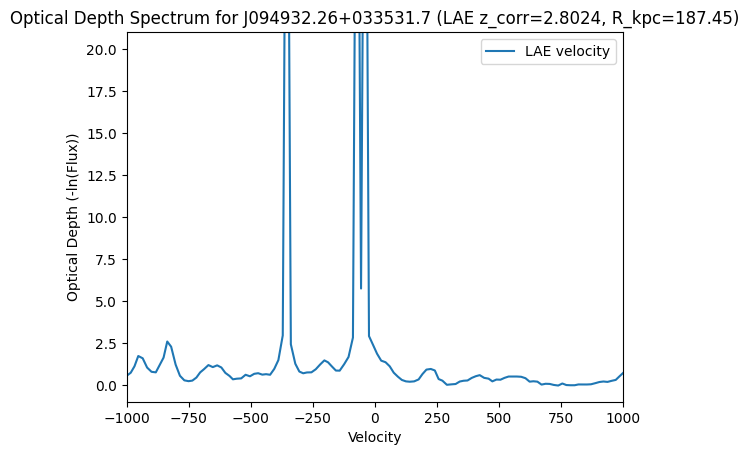

3.4118   | 6.3313 | 247.24


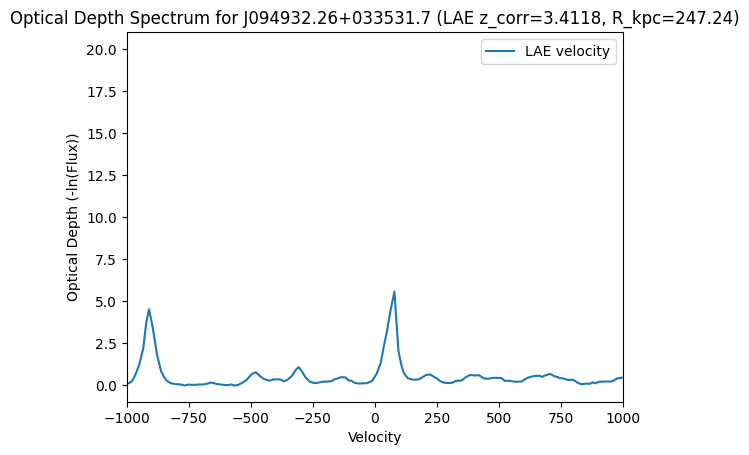

3.5476   | 6.3313 | 189.26


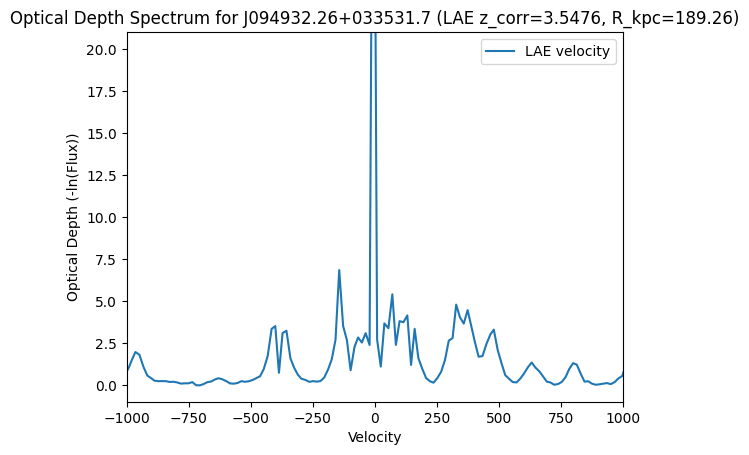

3.5948   | 6.3313 | 235.46


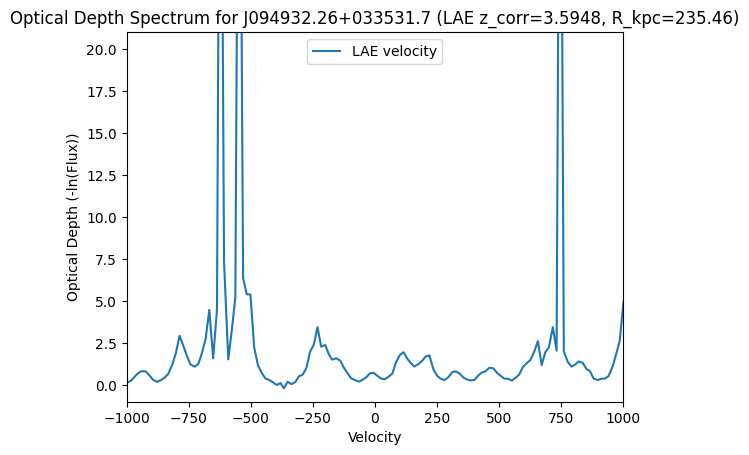

3.6360   | 6.3313 | 35.43


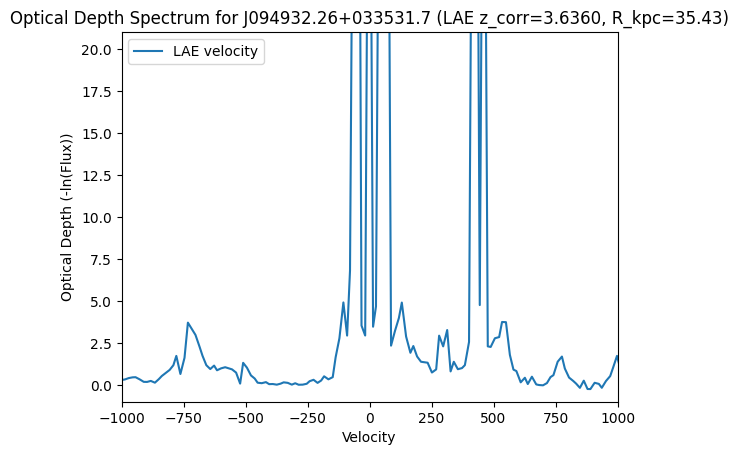


--- Quasar: J095852.19+120245.0 (z_QSO=3.2746) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.0116   | No data in range | 198.10


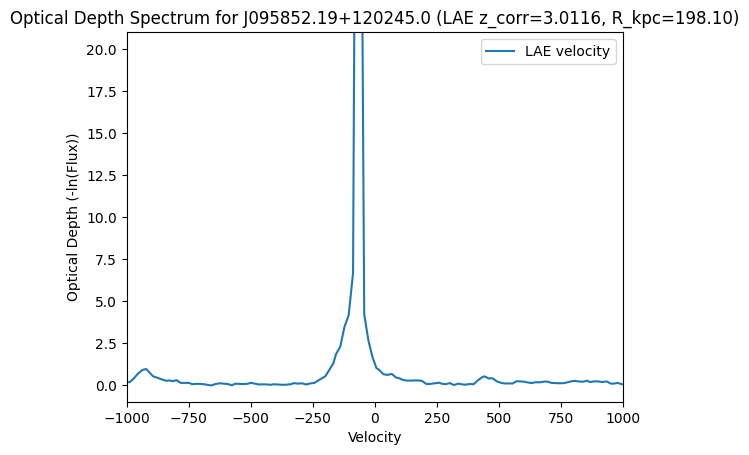

3.0777   | No data in range | 190.05


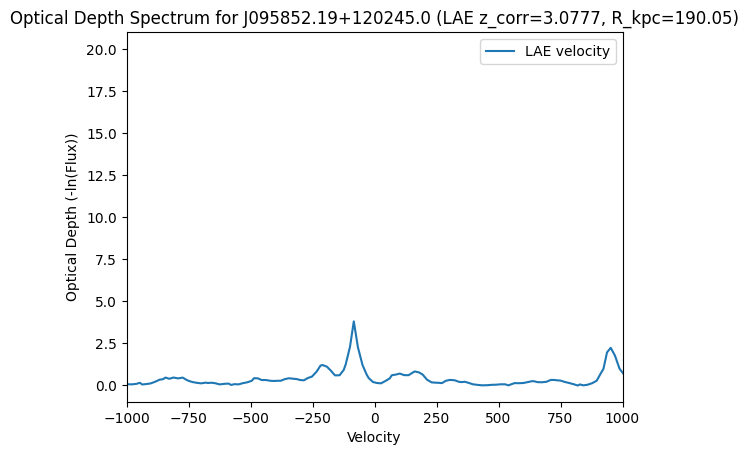

3.1041   | No data in range | 76.41


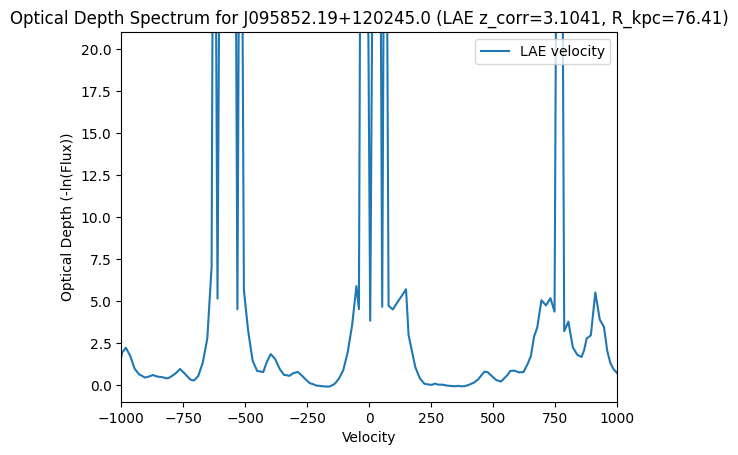

3.1083   | No data in range | 243.94


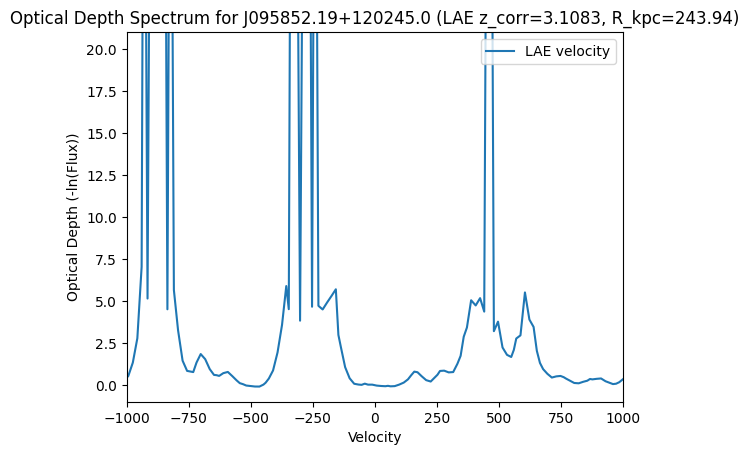

3.1585   | No data in range | 124.57


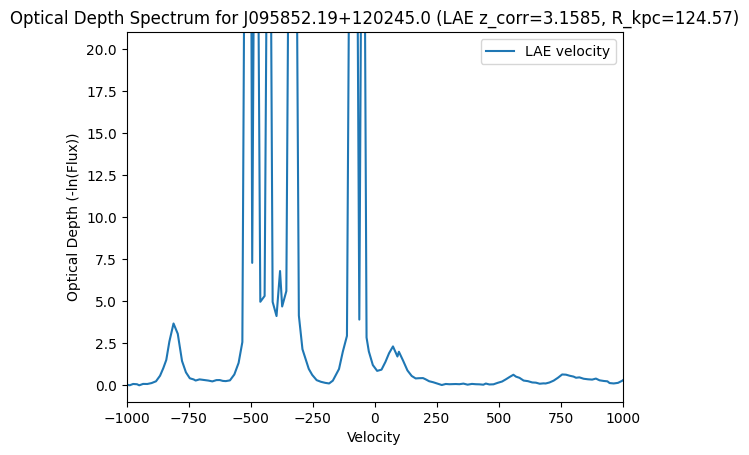


--- Quasar: J102009.99+104002.7 (z_QSO=3.1528) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.0133   | No data in range | 190.02


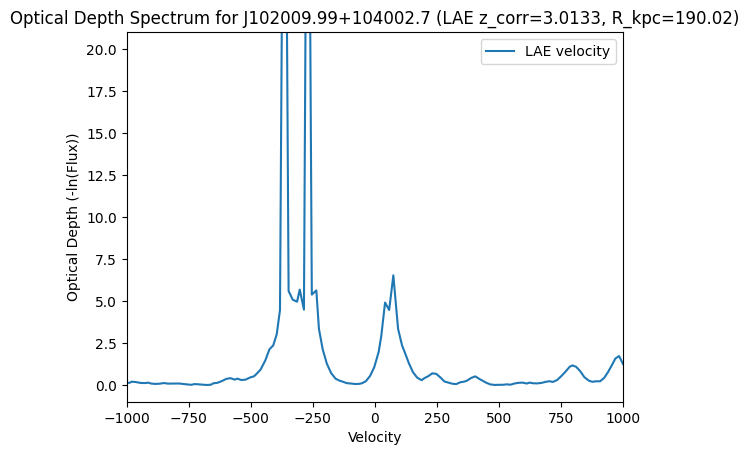

3.0131   | No data in range | 107.46


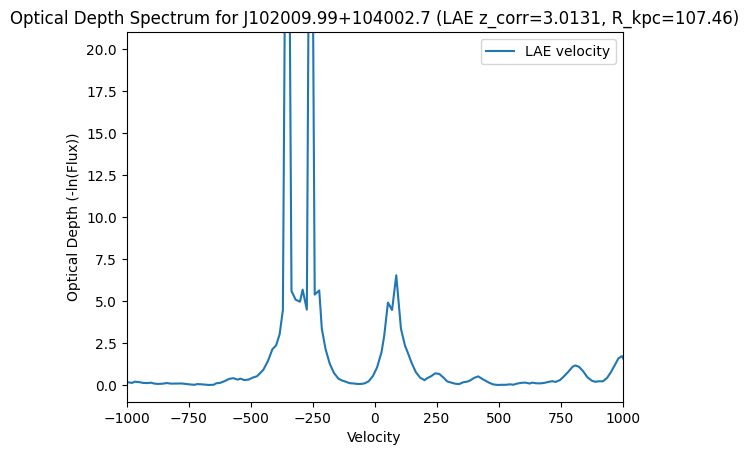

3.1521   | No data in range | 265.31


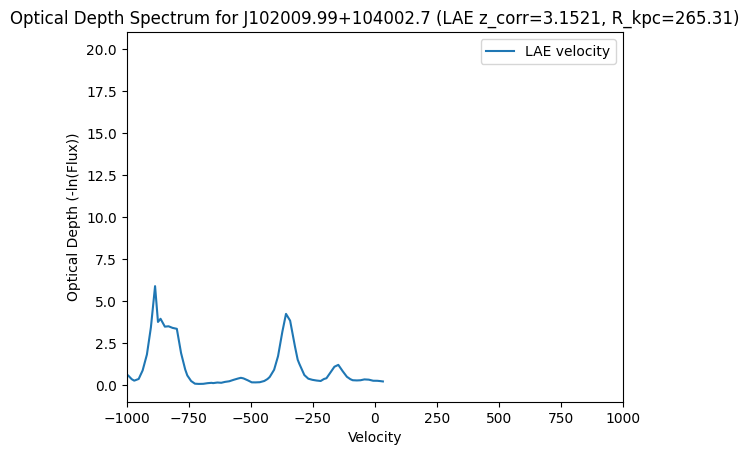


--- Quasar: J111008.61+024458.0 (z_QSO=4.1582) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8114   | 6.3313 | 238.22


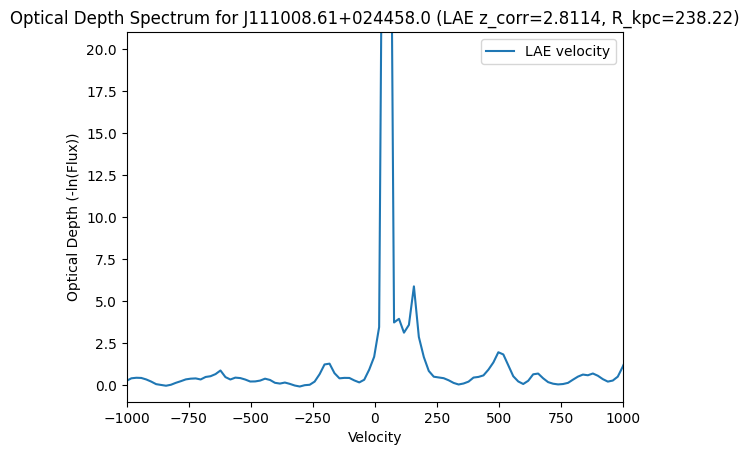

2.9143   | 6.3313 | 299.11


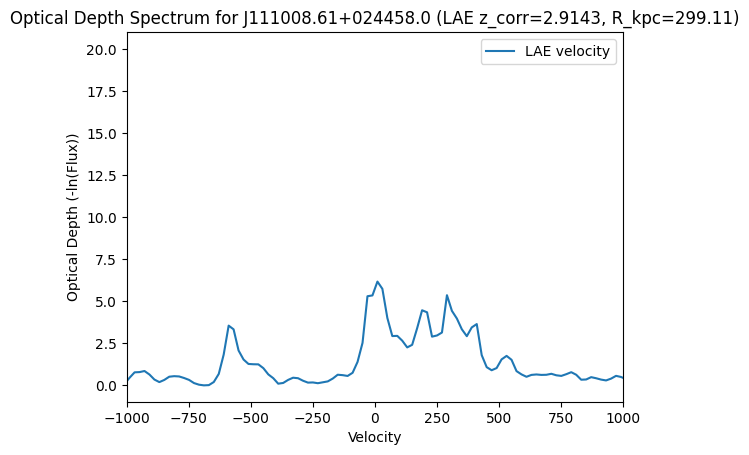

3.0642   | 6.3313 | 86.39


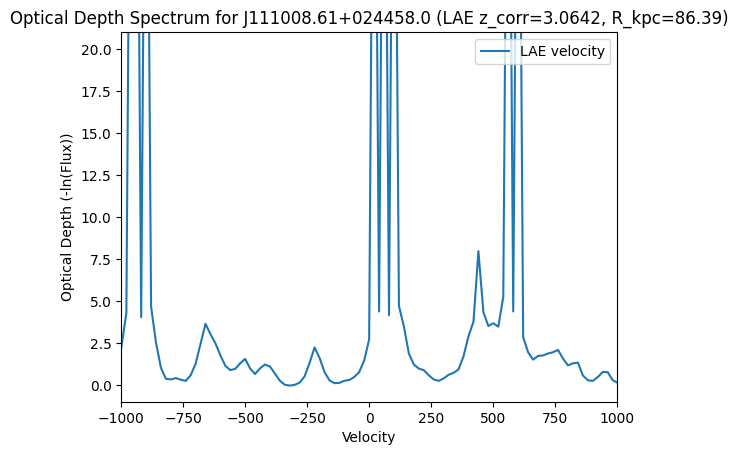

3.2081   | 6.3313 | 164.51


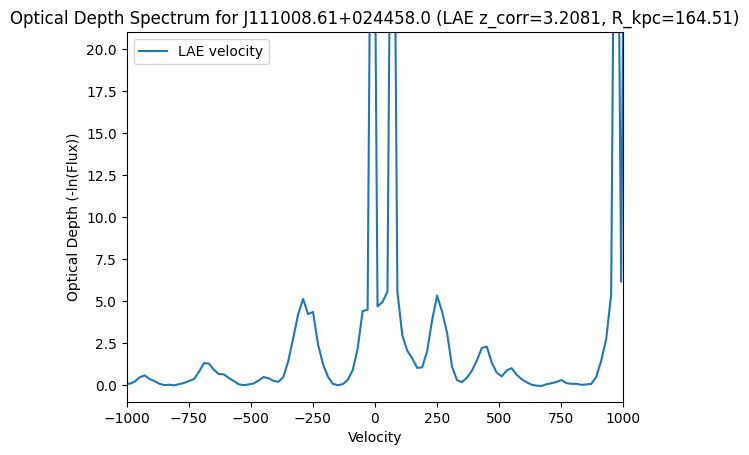

3.2704   | 6.3313 | 200.10


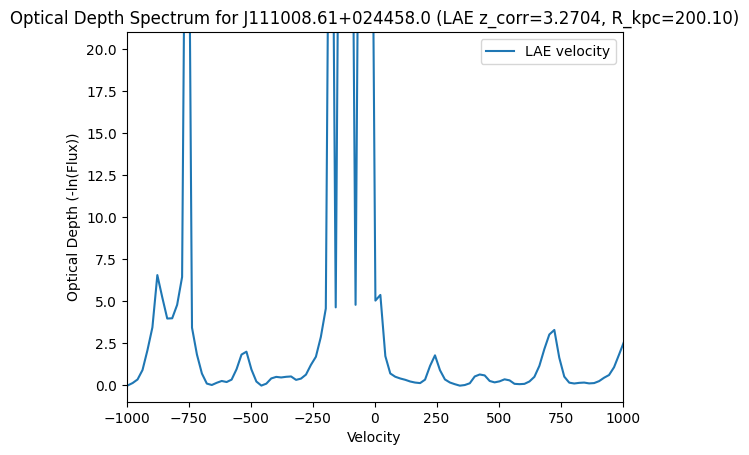

3.4156   | 6.3313 | 121.75


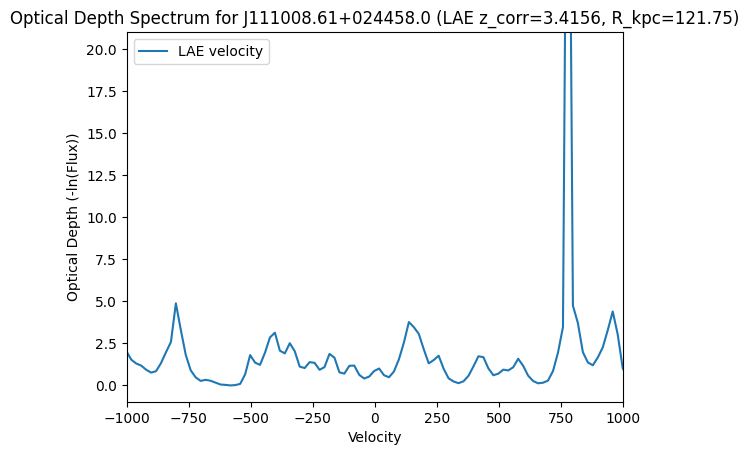

3.4166   | 6.3313 | 223.14


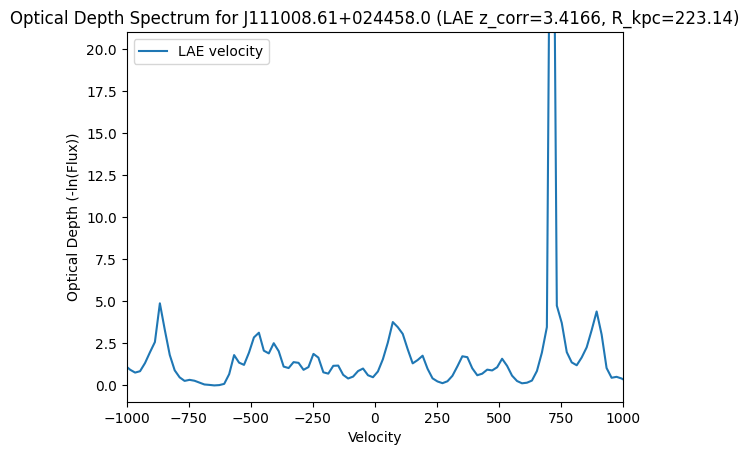

3.4687   | 6.3313 | 249.10


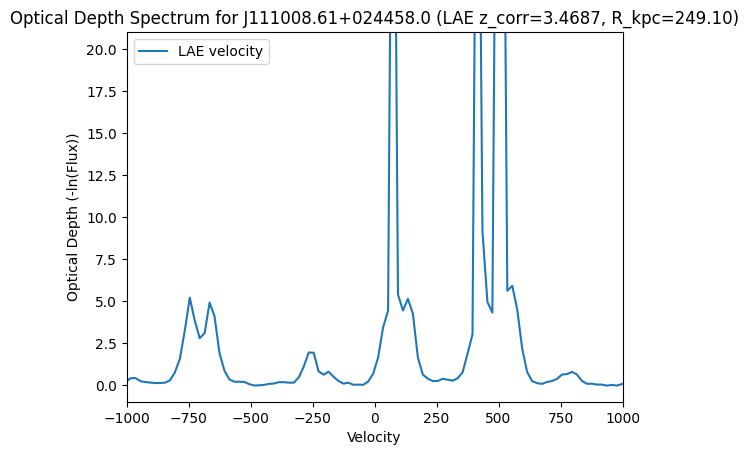

3.6900   | 6.3313 | 170.01


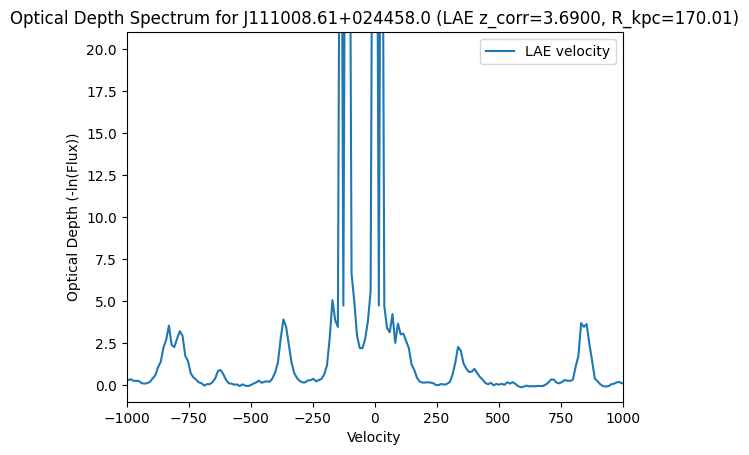


--- Quasar: J111113.79-080402.0 (z_QSO=3.9300) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8362   | 6.3313 | 170.76


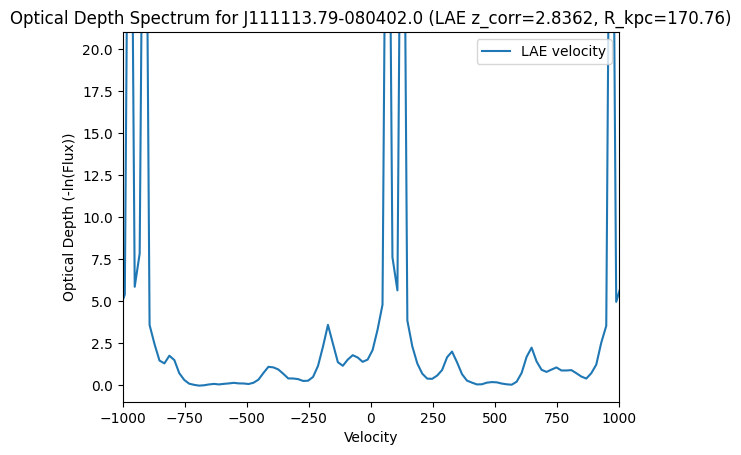

2.9848   | 6.3313 | 226.24


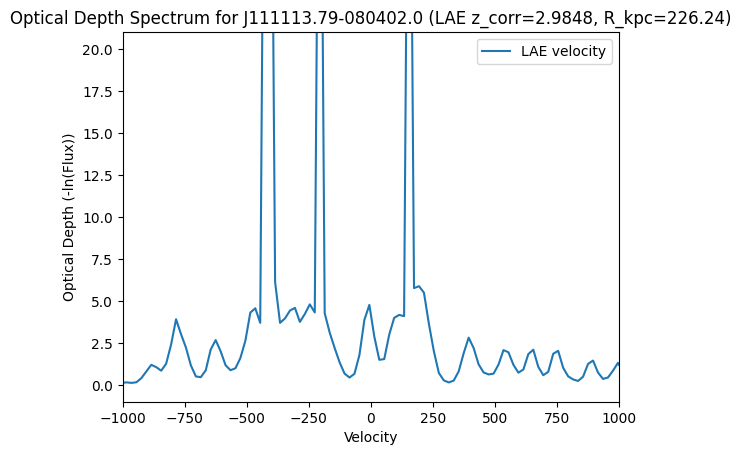

3.0532   | 6.3313 | 146.74


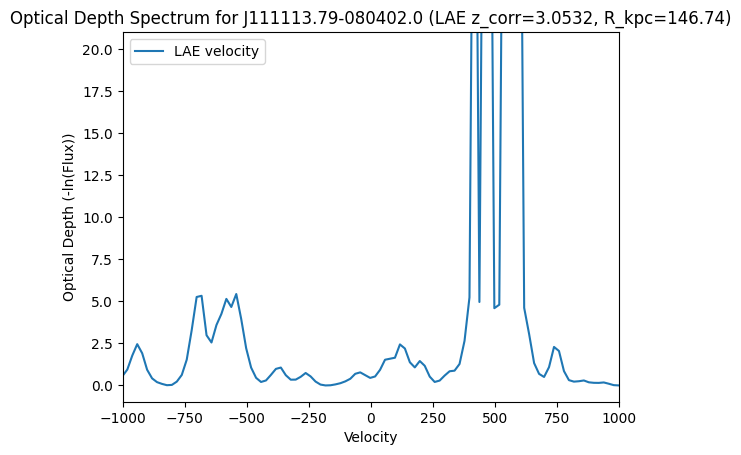

3.3172   | 6.3313 | 156.98


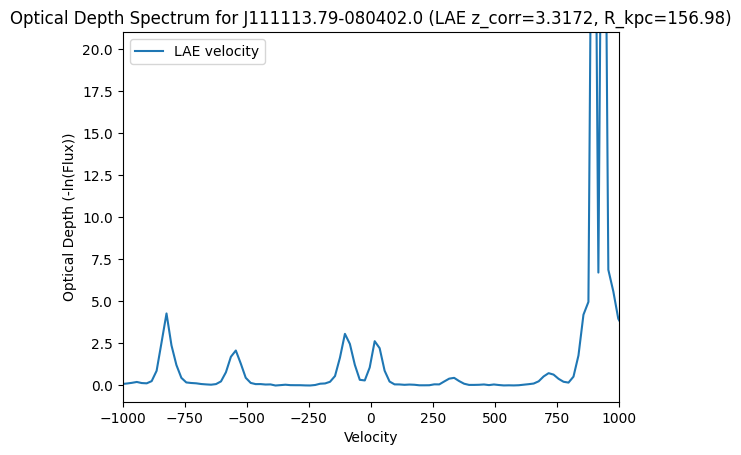

3.3574   | 6.3313 | 149.18


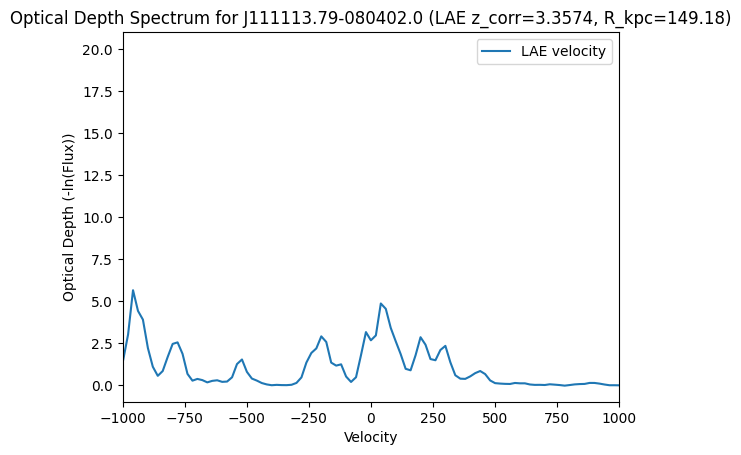

3.5752   | 6.3313 | 63.90


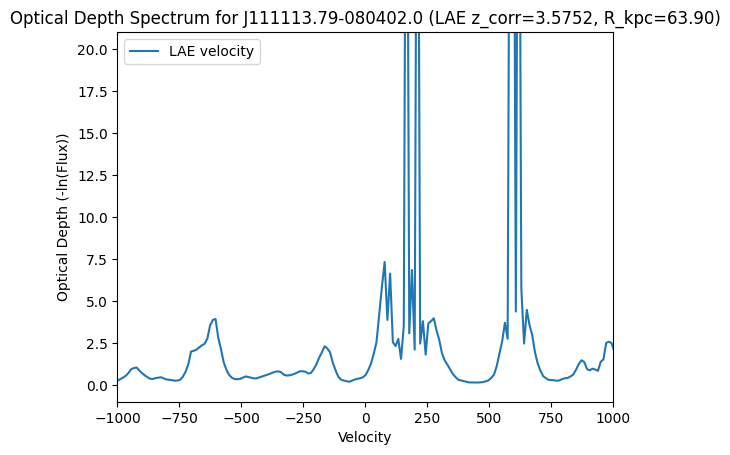

3.5771   | 6.3313 | 252.55


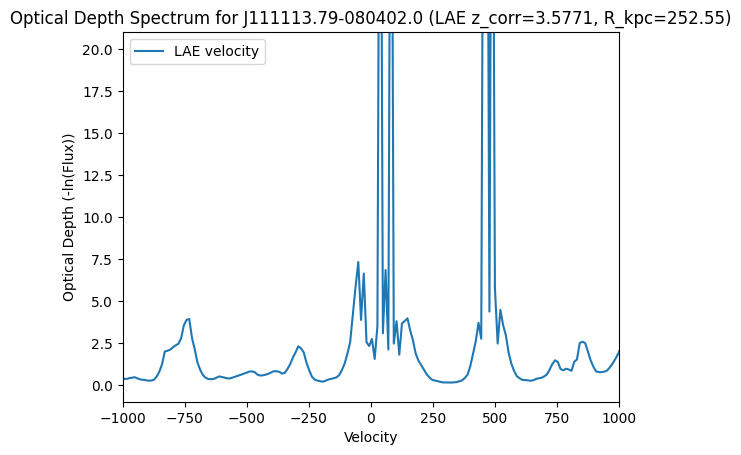

3.5755   | 6.3313 | 171.10


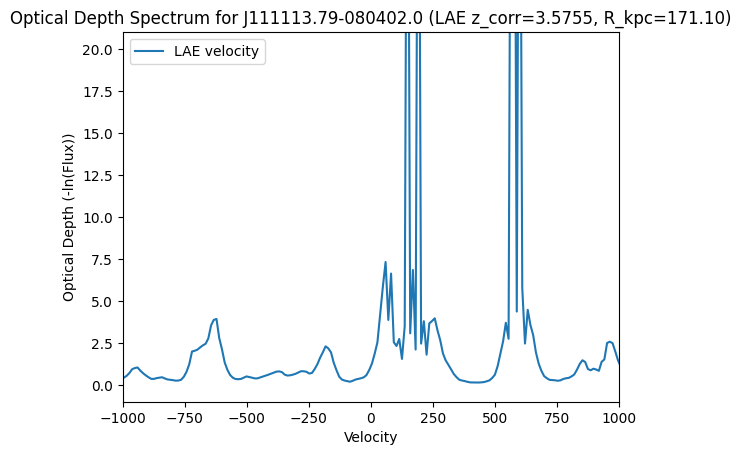

3.6047   | 6.3313 | 68.42


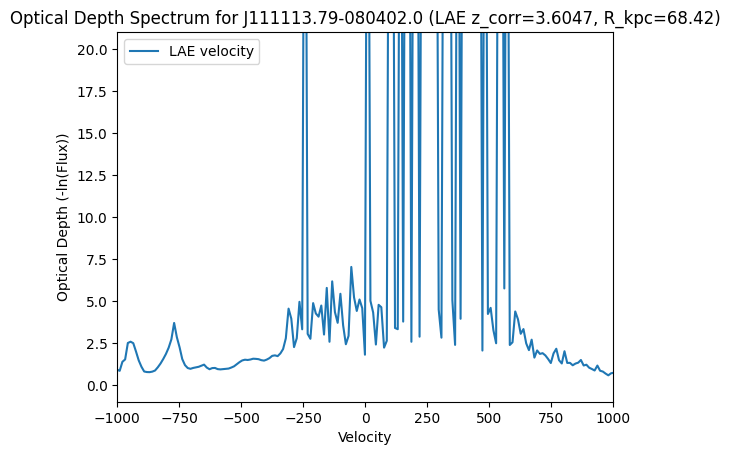

3.6083   | 6.3313 | 104.65


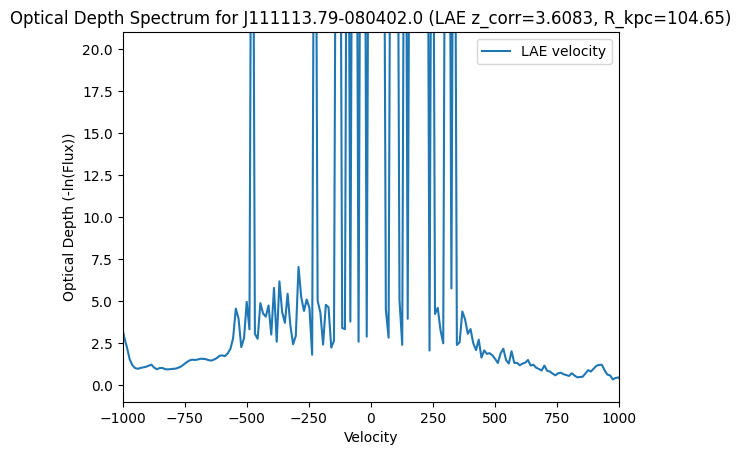

3.6065   | 6.3313 | 198.36


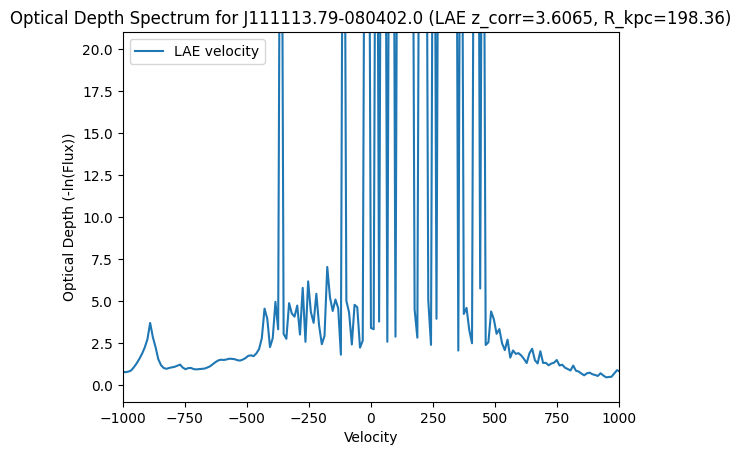

3.7159   | 6.3313 | 127.80


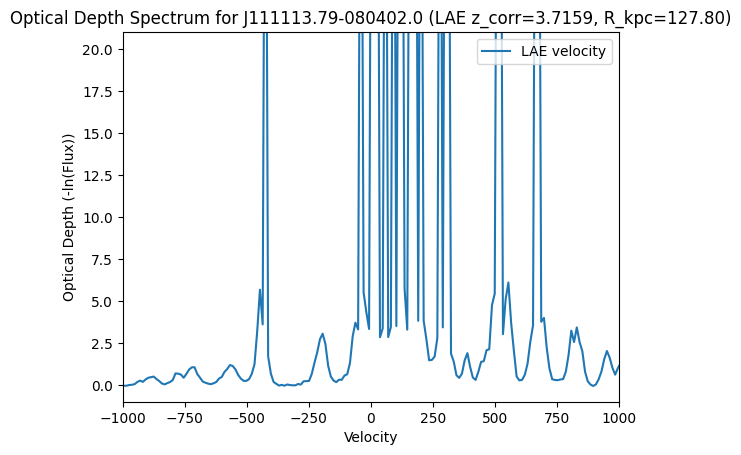

3.7241   | 6.3313 | 172.67


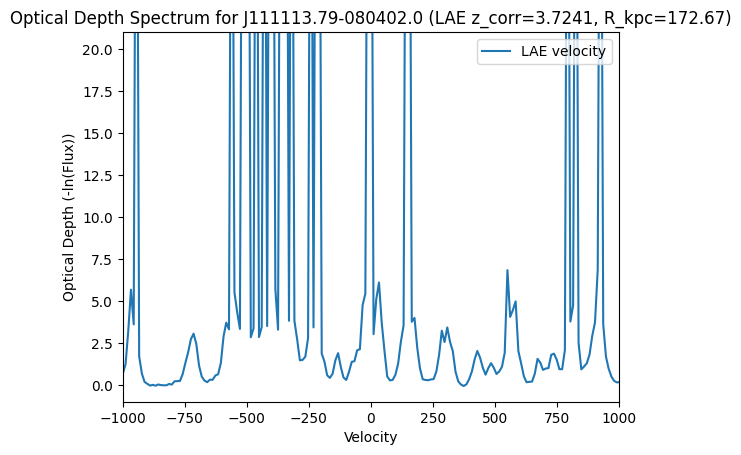


--- Quasar: J120917.93+113830.3 (z_QSO=3.0836) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.8341   | No data in range | 163.54


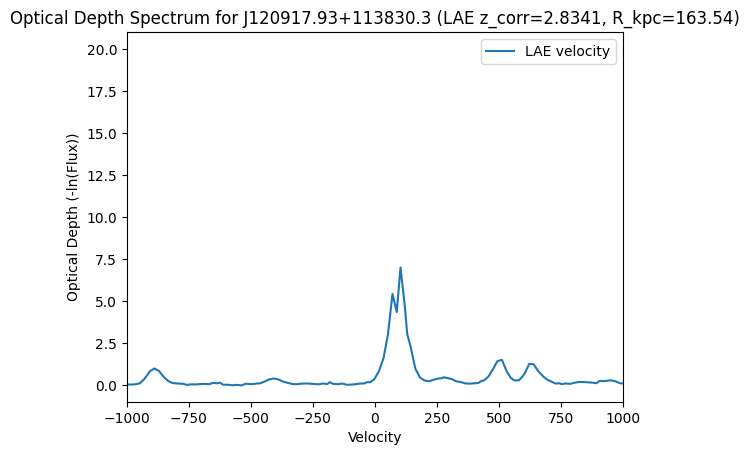

2.9876   | No data in range | 108.25


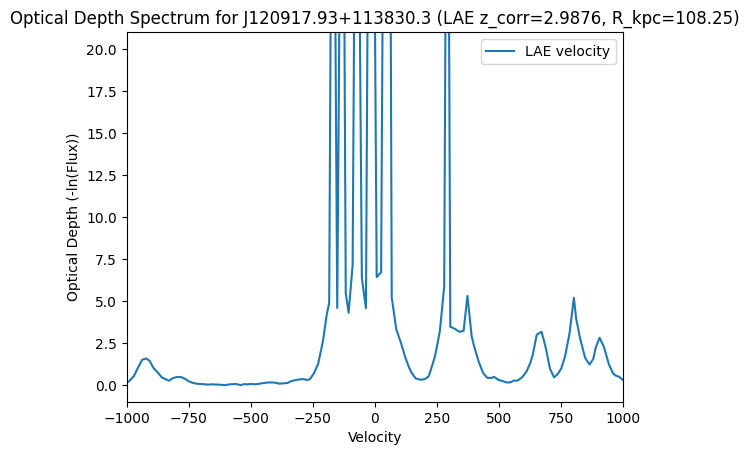


--- Quasar: J123055.57-113909.3 (z_QSO=3.5570) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.1076   | No data in range | 99.92


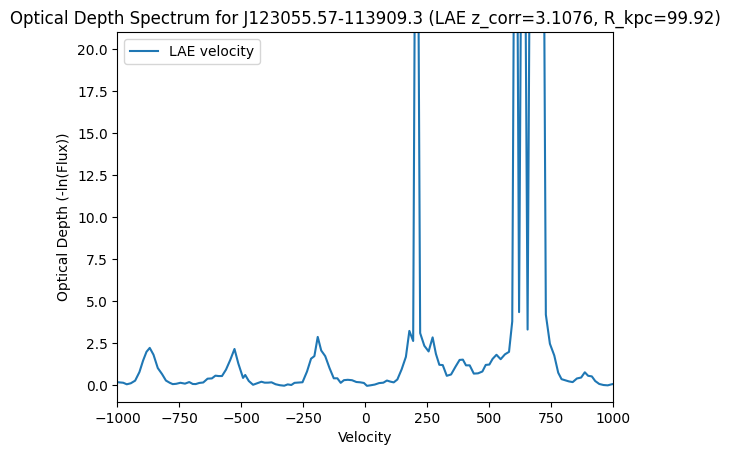

3.1813   | No data in range | 210.26


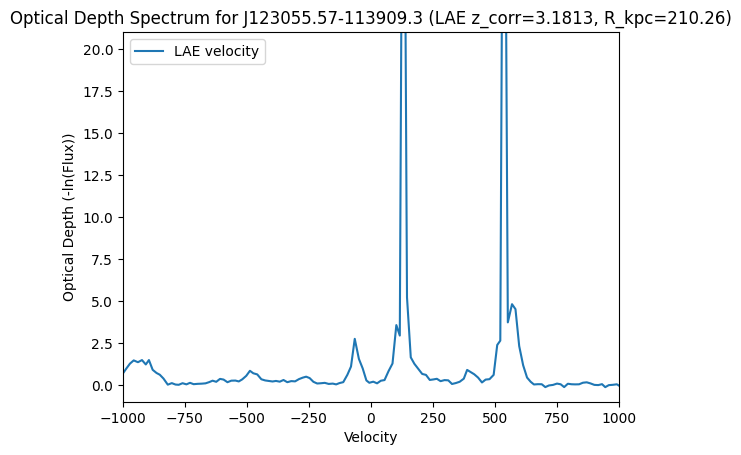

3.2358   | No data in range | 161.55


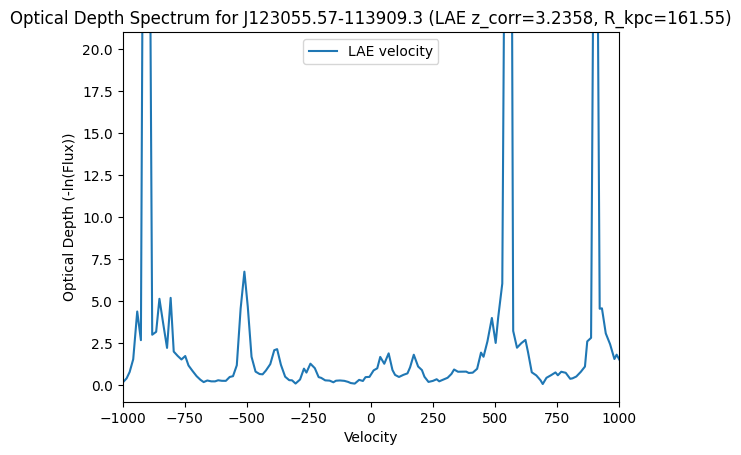

3.2828   | No data in range | 239.87


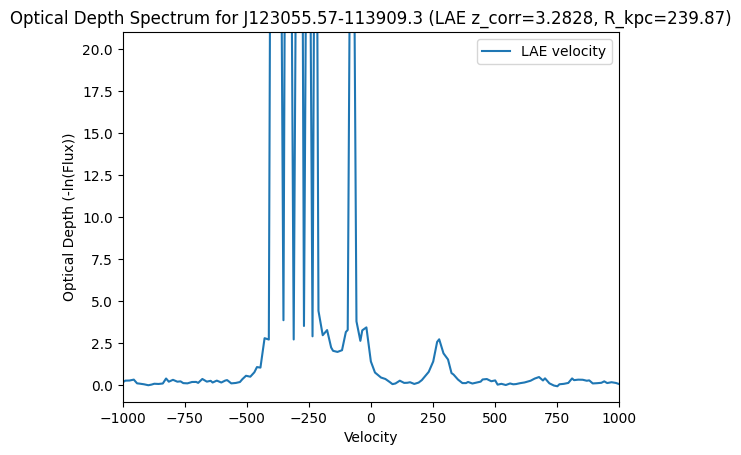

3.3203   | No data in range | 72.82


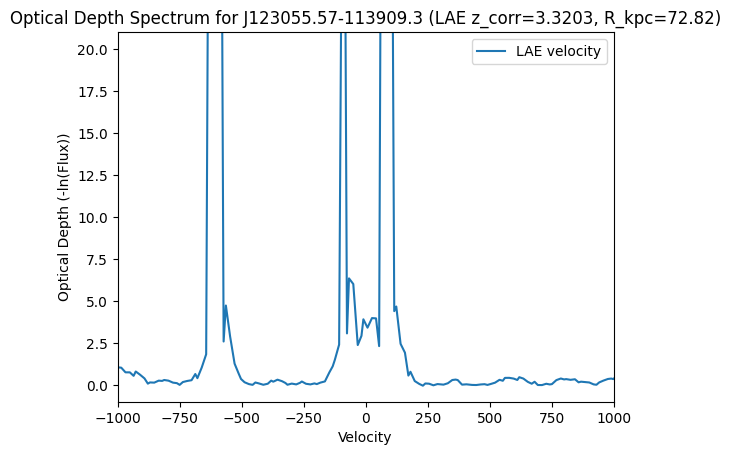

3.3206   | No data in range | 145.34


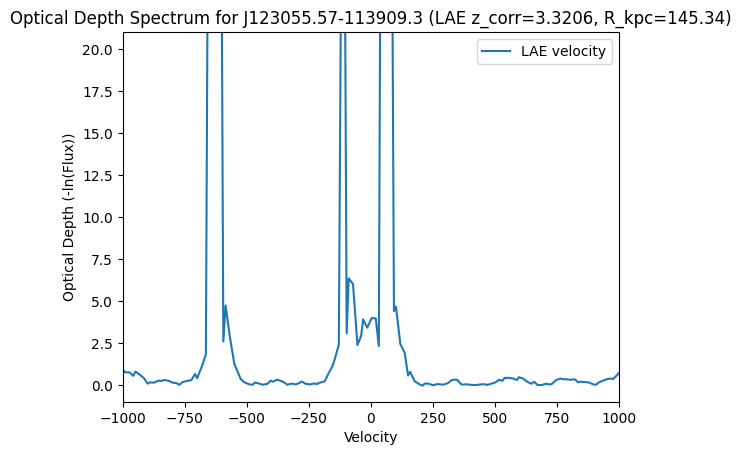

3.3683   | No data in range | 185.77


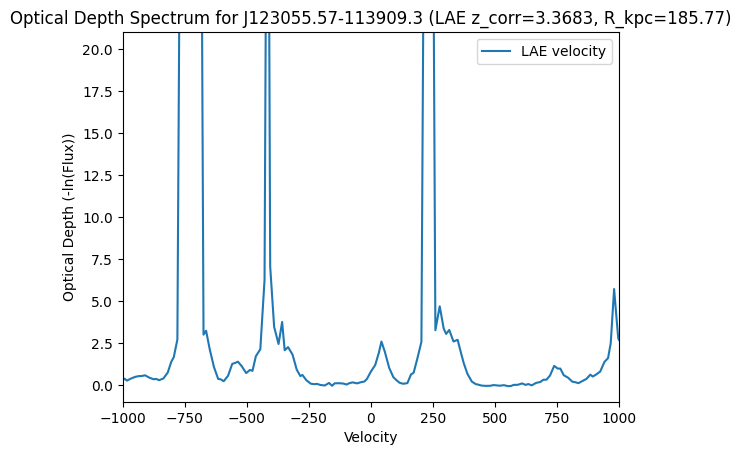

3.3783   | No data in range | 174.16


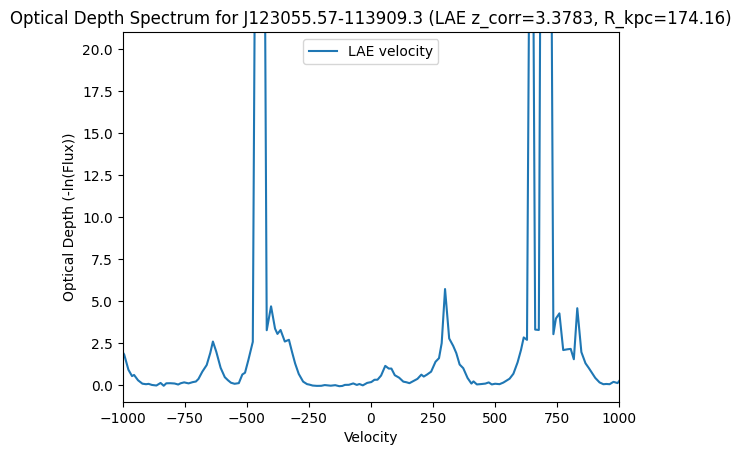

3.4967   | No data in range | 145.84


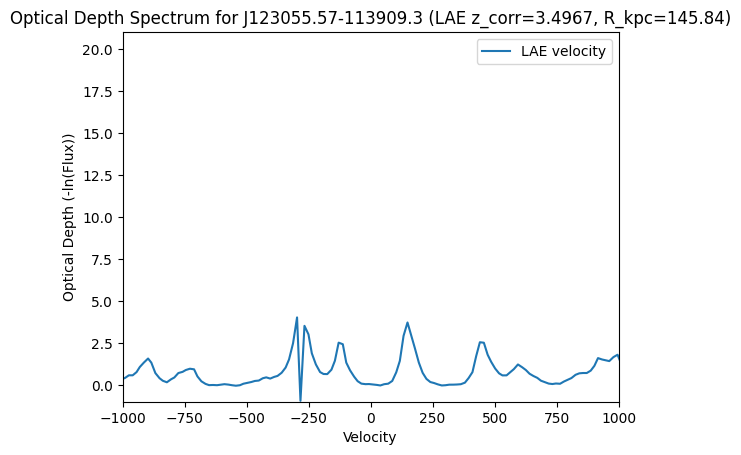

3.5366   | No data in range | 74.17


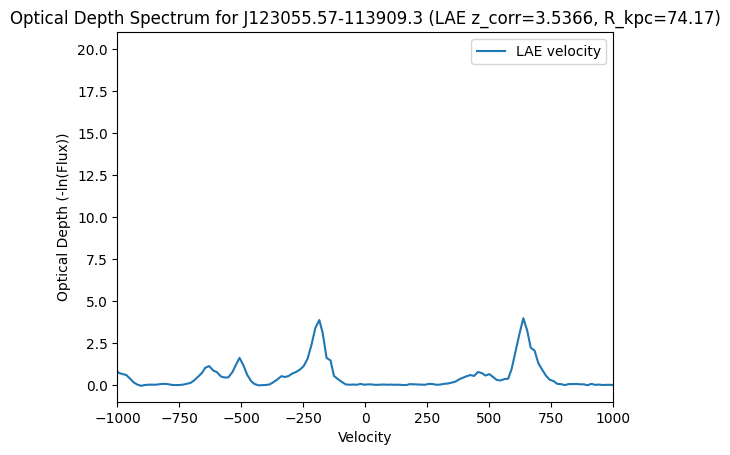

3.5414   | No data in range | 77.31


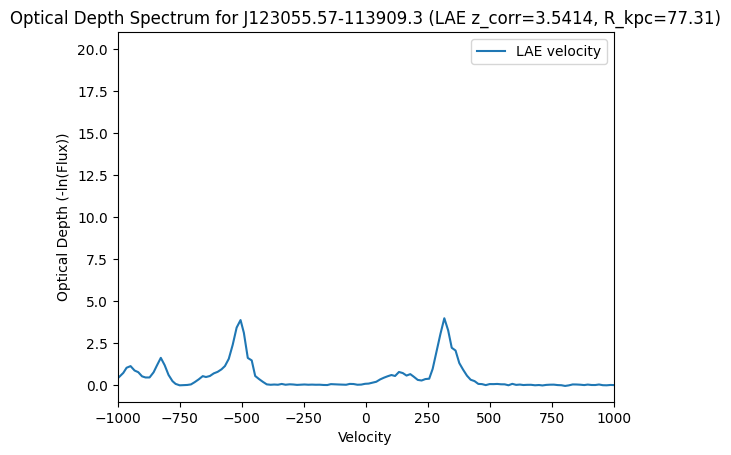

3.5442   | No data in range | 90.45


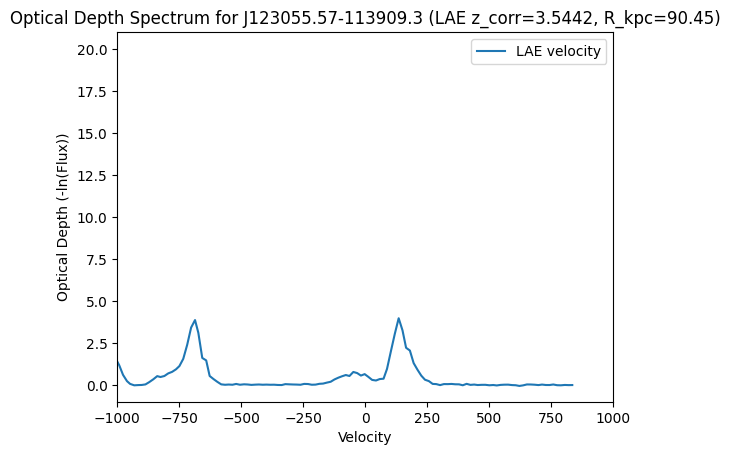


--- Quasar: J124957.23-015928.8 (z_QSO=3.6337) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.0251   | No data in range | 242.69


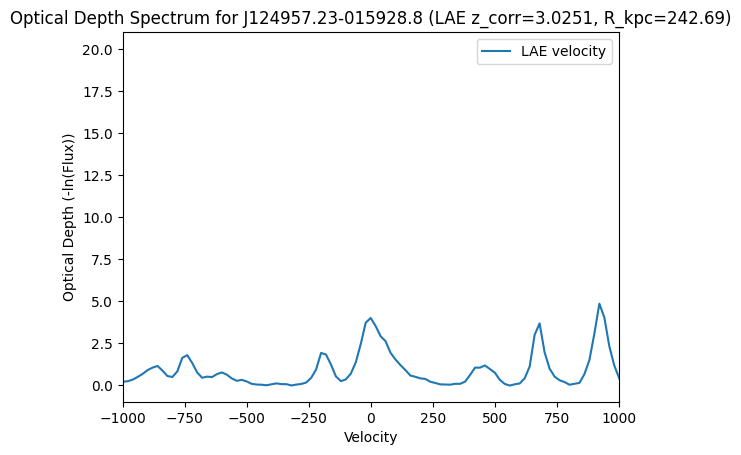

3.4371   | No data in range | 251.37


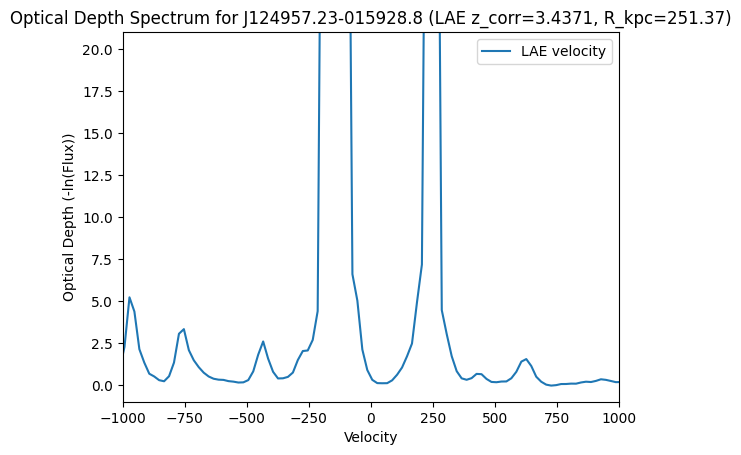

3.4693   | No data in range | 233.44


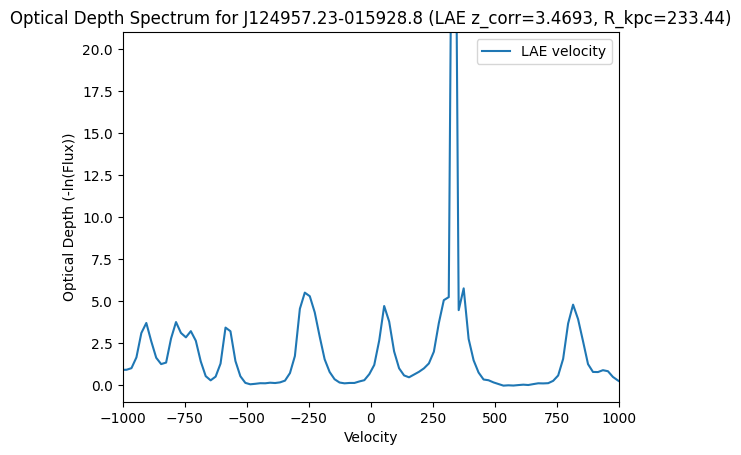

3.4998   | No data in range | 219.51


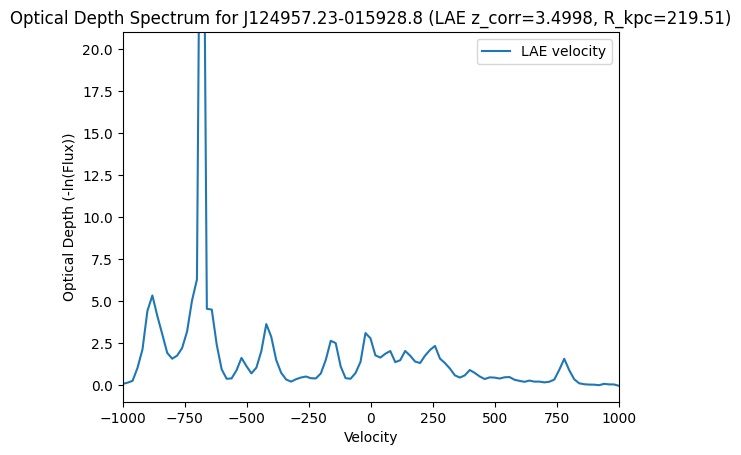

3.5228   | No data in range | 219.81


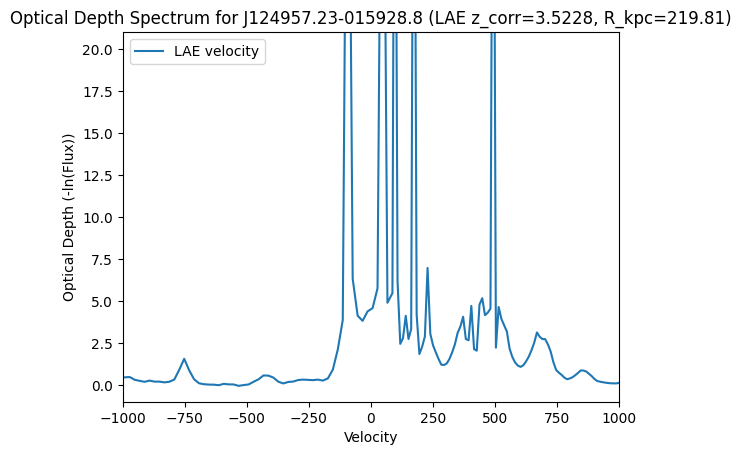

3.5212   | No data in range | 224.29


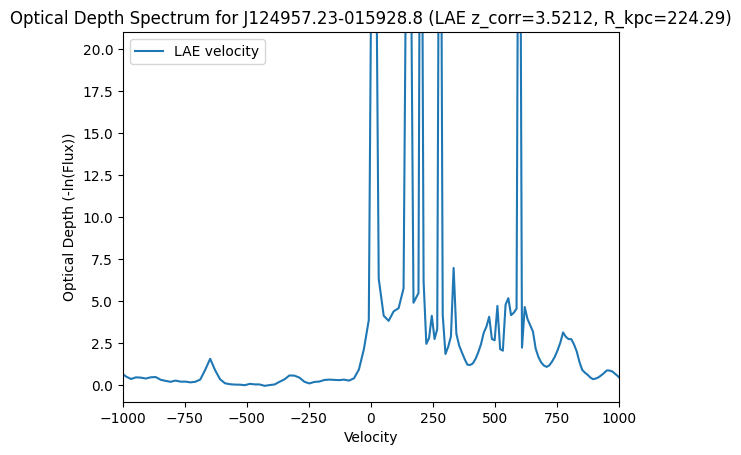

3.5512   | No data in range | 148.57


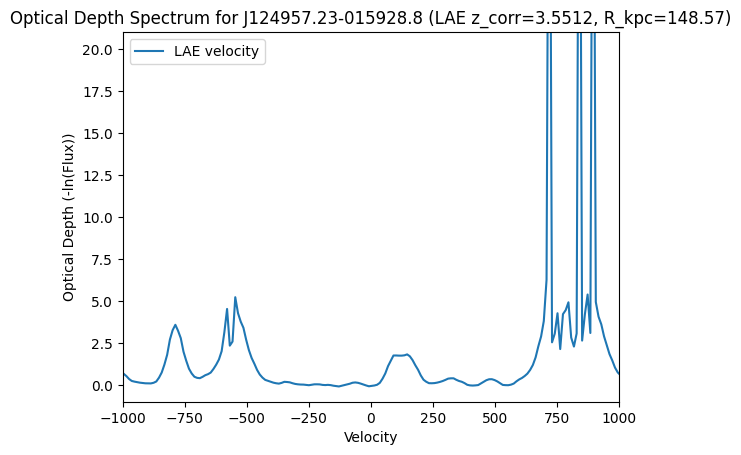

3.5628   | No data in range | 222.05


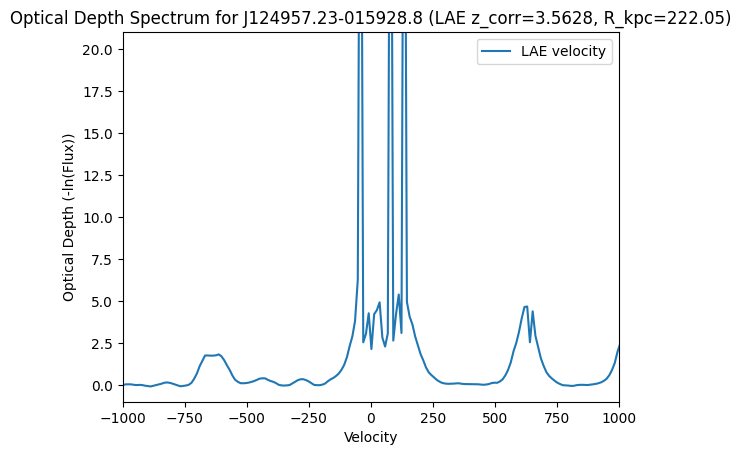


--- Quasar: J133254.51+005250.6 (z_QSO=3.5071) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.0170   | No data in range | 93.98


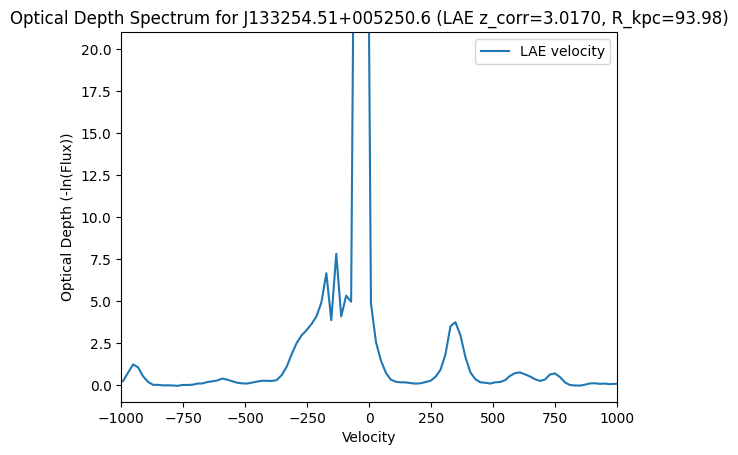

3.0153   | No data in range | 208.64


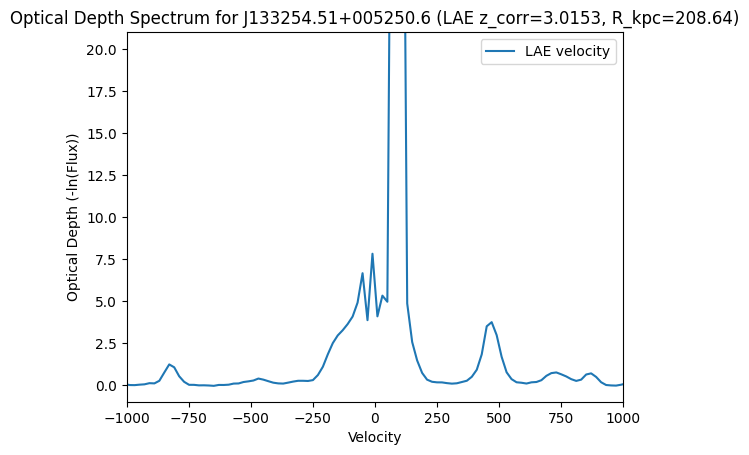

3.0165   | No data in range | 96.13


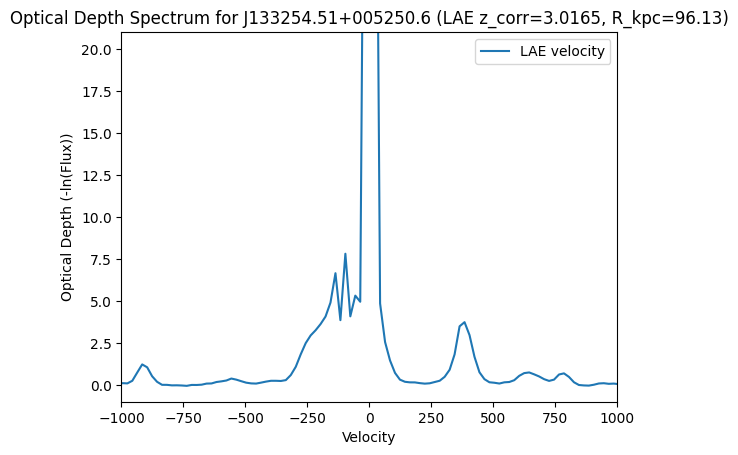

3.0861   | No data in range | 239.28


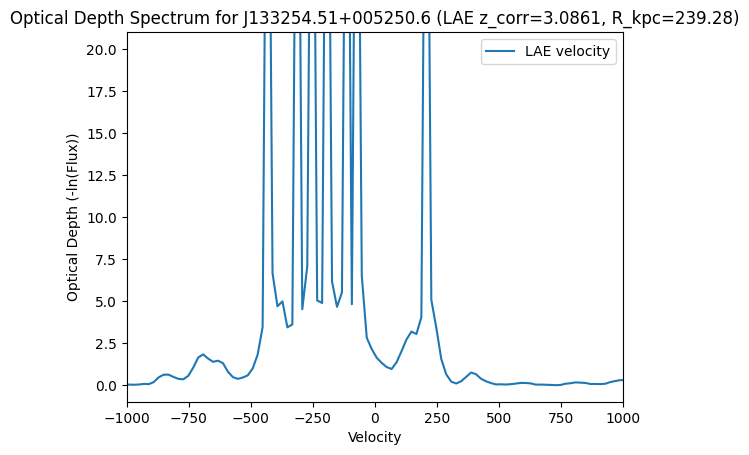

3.1201   | No data in range | 214.58


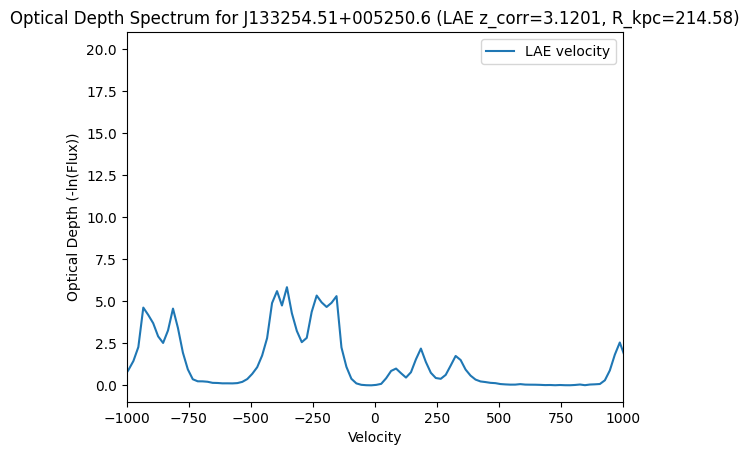

3.1240   | No data in range | 213.66


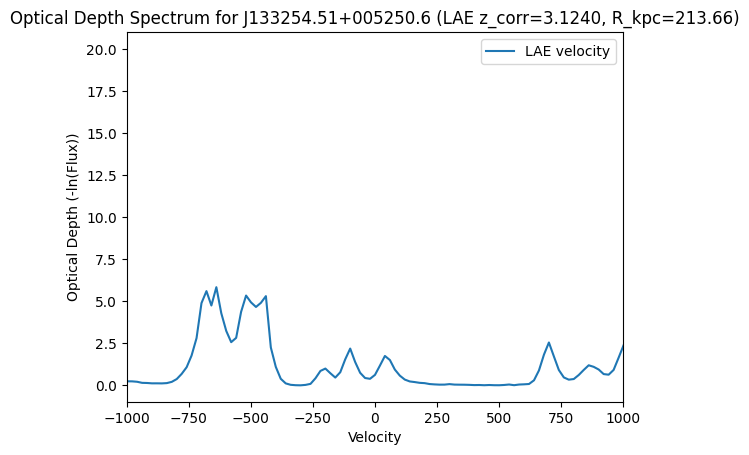

3.1314   | No data in range | 155.74


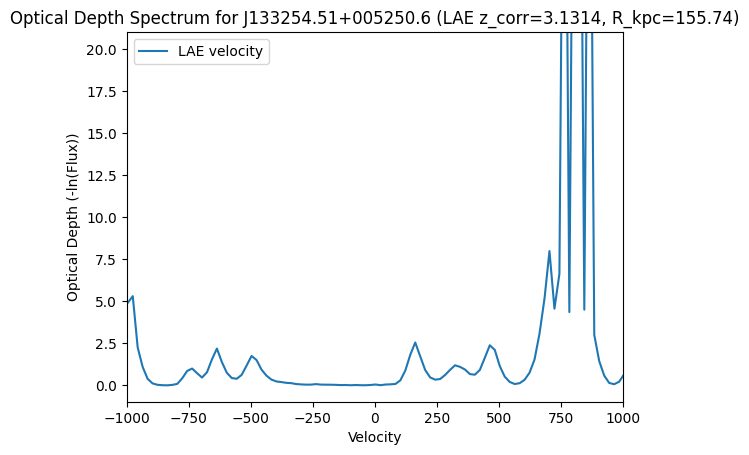

3.1397   | No data in range | 121.66


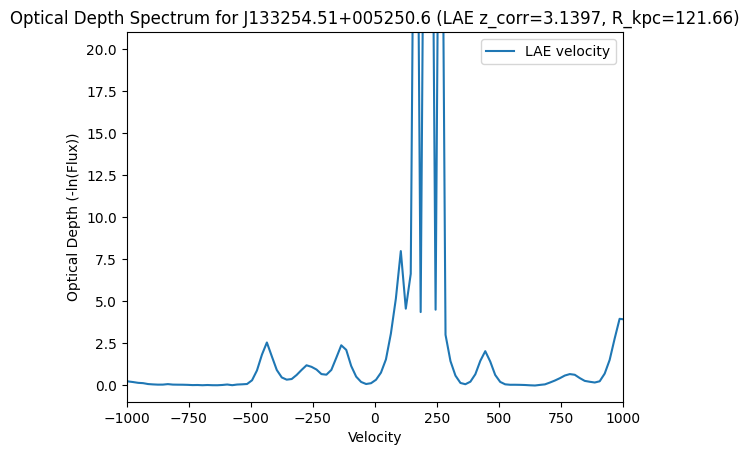

3.1623   | No data in range | 129.29


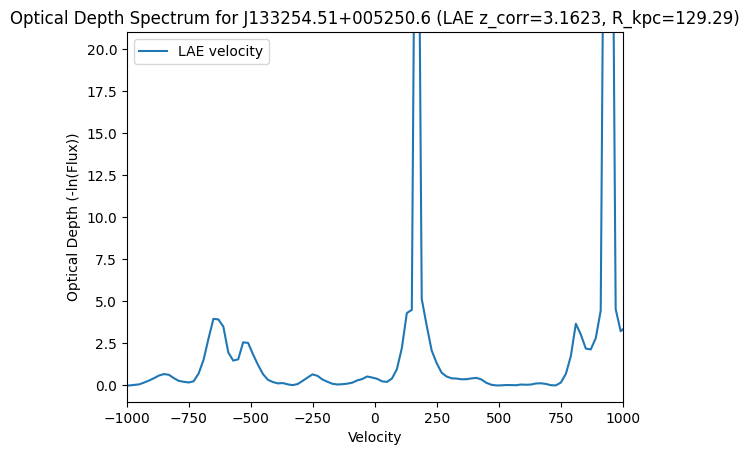

3.3442   | No data in range | 251.69


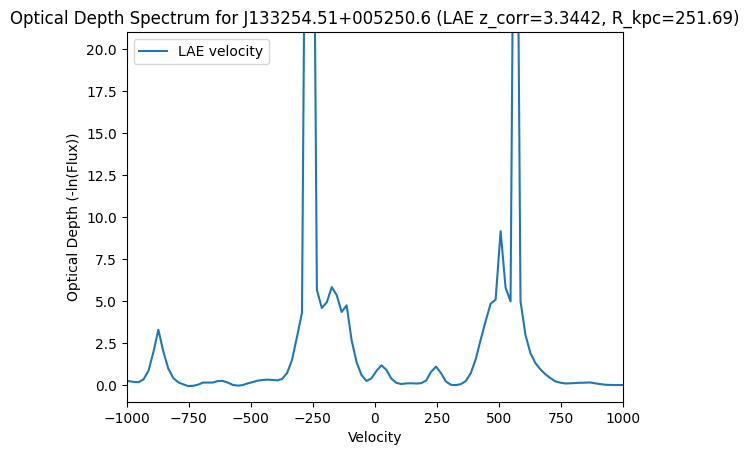

3.3495   | No data in range | 90.73


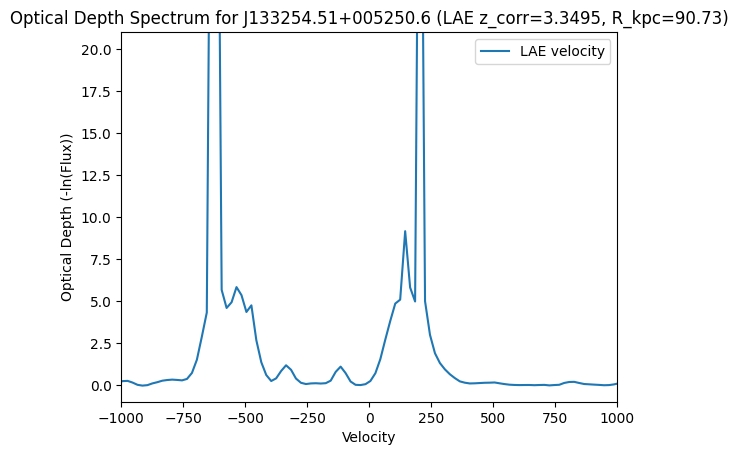

3.4737   | No data in range | 202.36


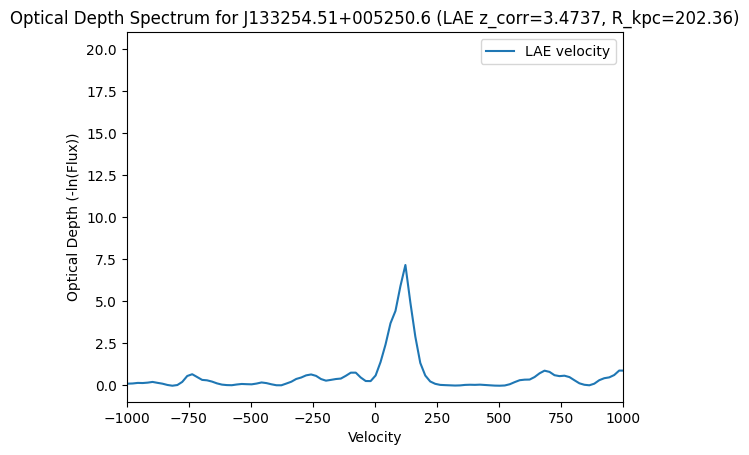

3.5028   | No data in range | 133.17


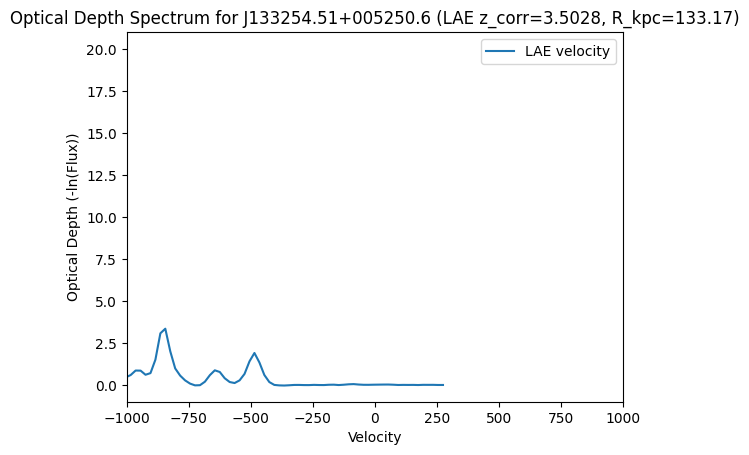


--- Quasar: J142438.10+225600.7 (z_QSO=3.6340) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.3212   | No data in range | 188.73


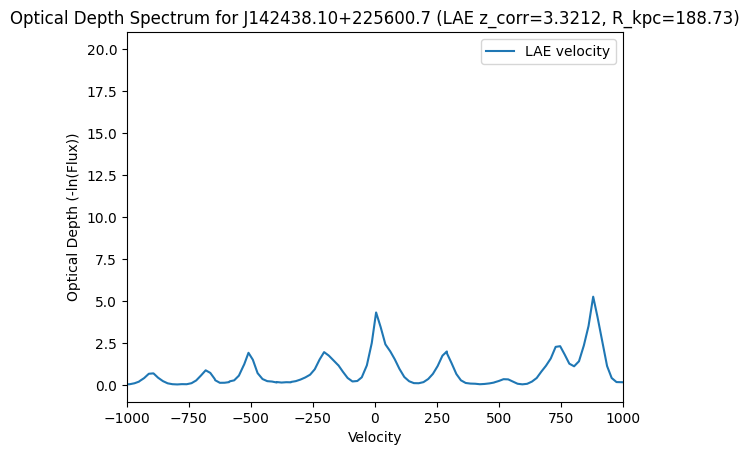

3.3211   | No data in range | 201.65


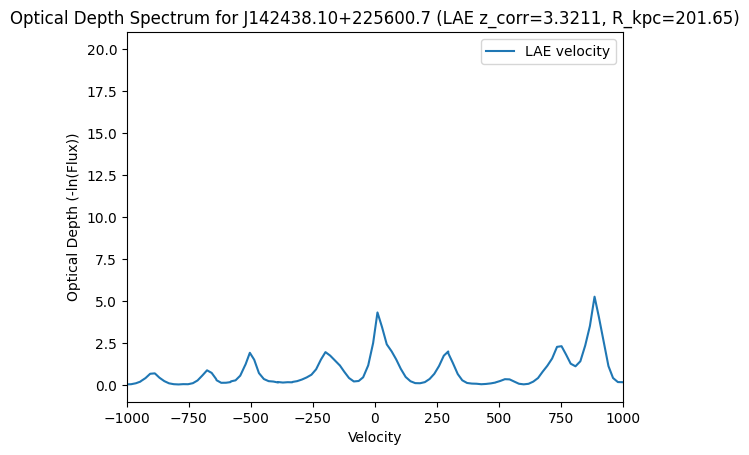

3.3779   | No data in range | 205.47


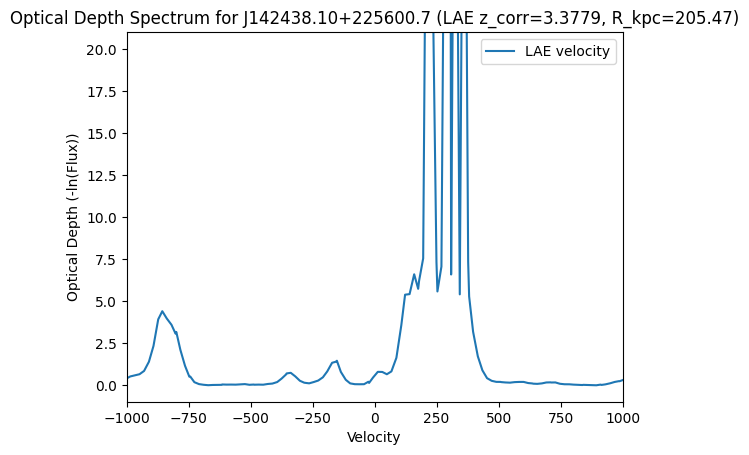

3.5647   | No data in range | 177.97


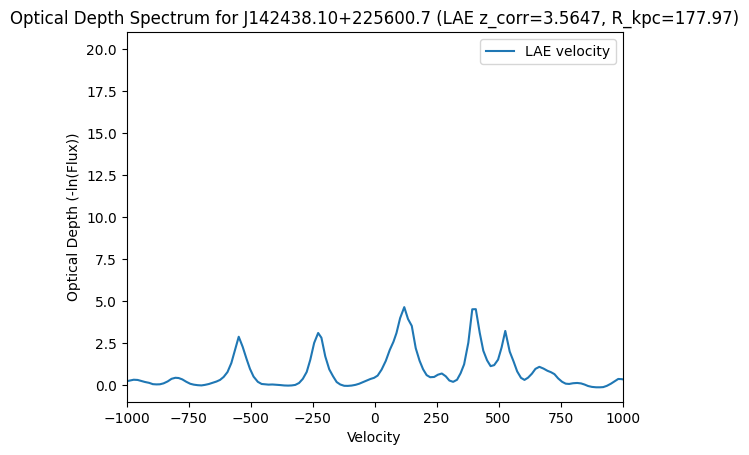


--- Quasar: J162116.92-004250.8 (z_QSO=3.7100) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9315   | 6.3313 | 89.22


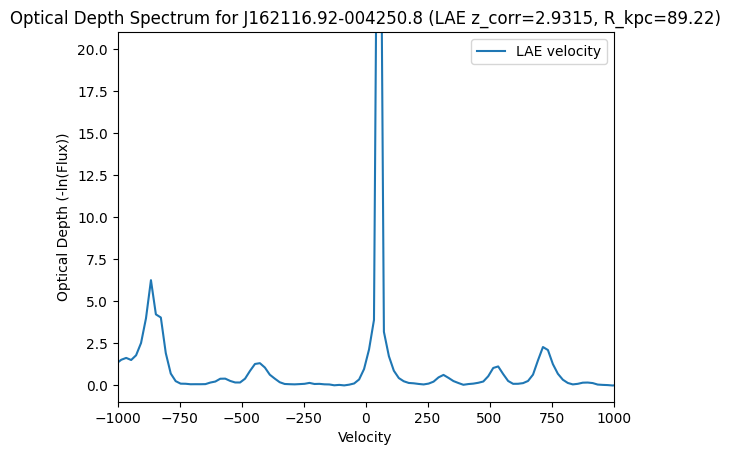

2.9398   | 6.3313 | 261.34


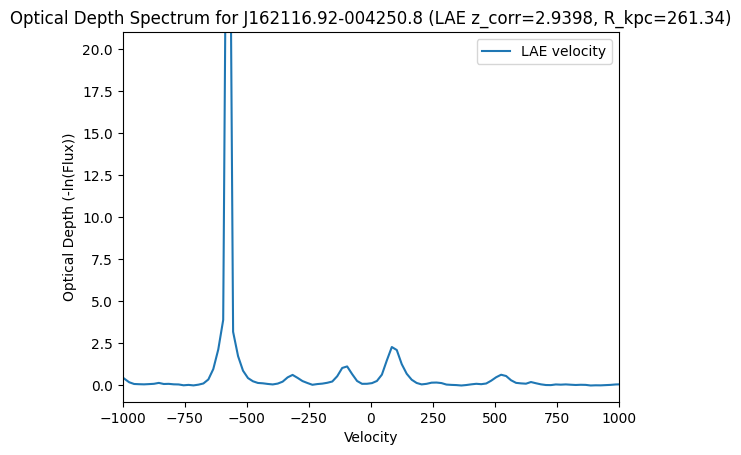

2.9547   | 6.3313 | 159.02


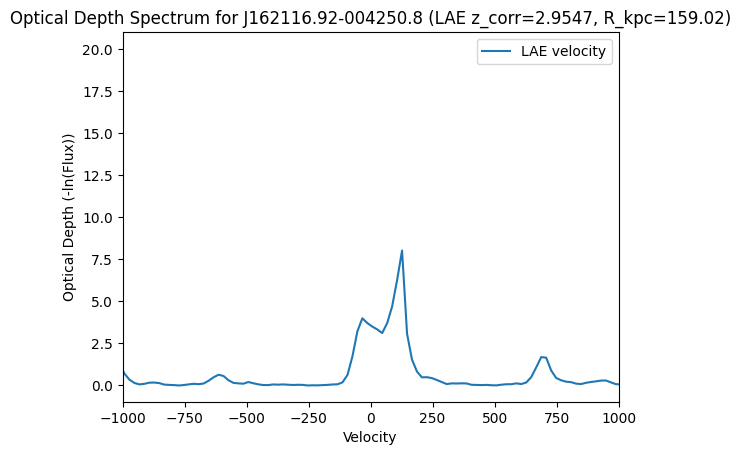

2.9500   | 6.3313 | 184.47


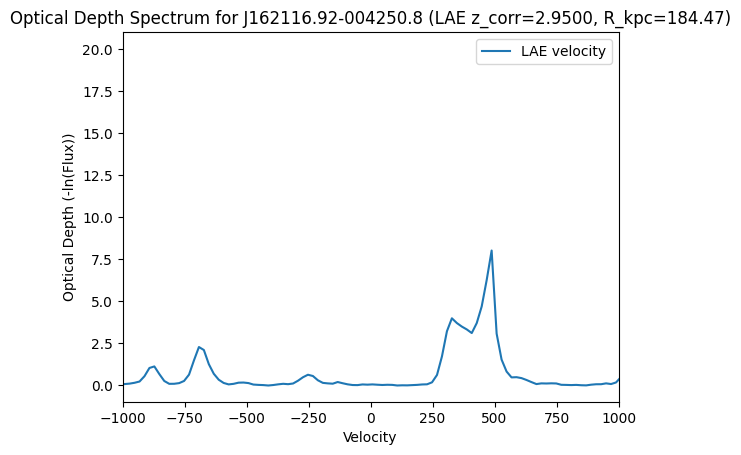

2.9555   | 6.3313 | 133.30


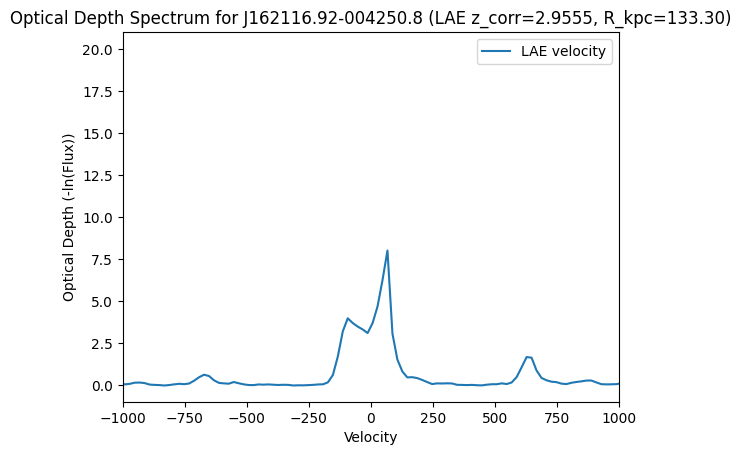

3.1072   | 6.3313 | 207.05


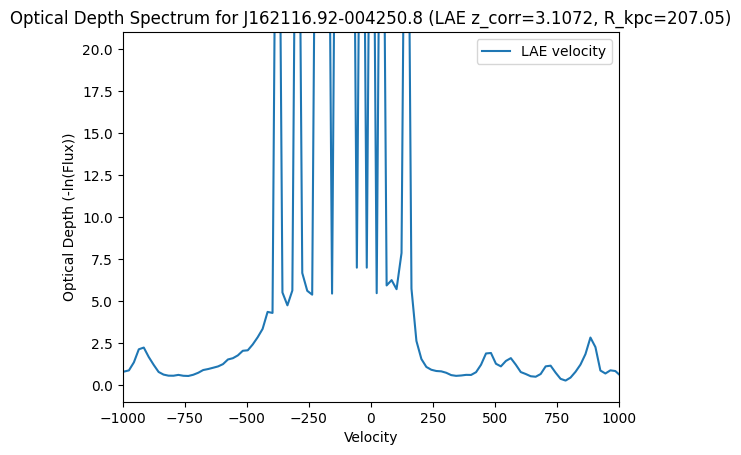

3.1080   | 6.3313 | 157.63


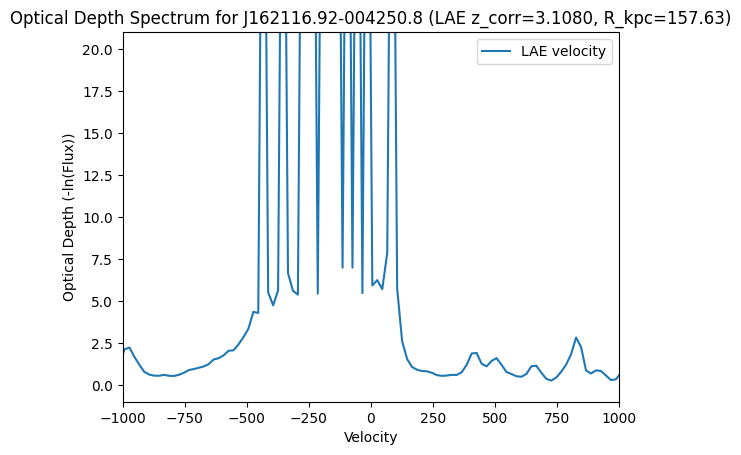

3.1106   | 6.3313 | 200.26


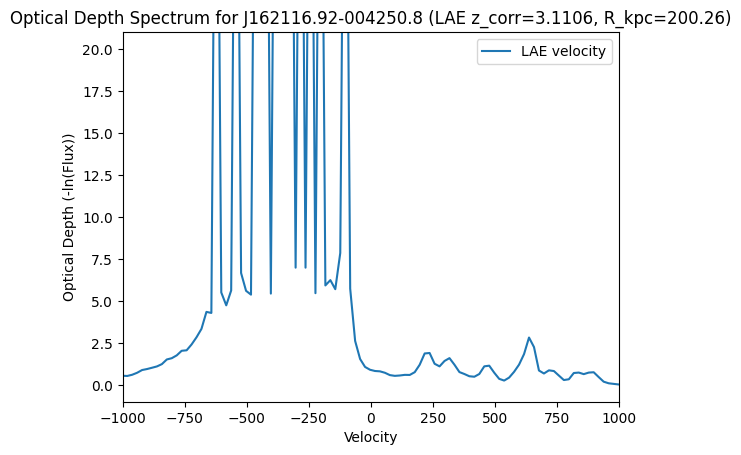

3.1930   | 6.3313 | 194.20


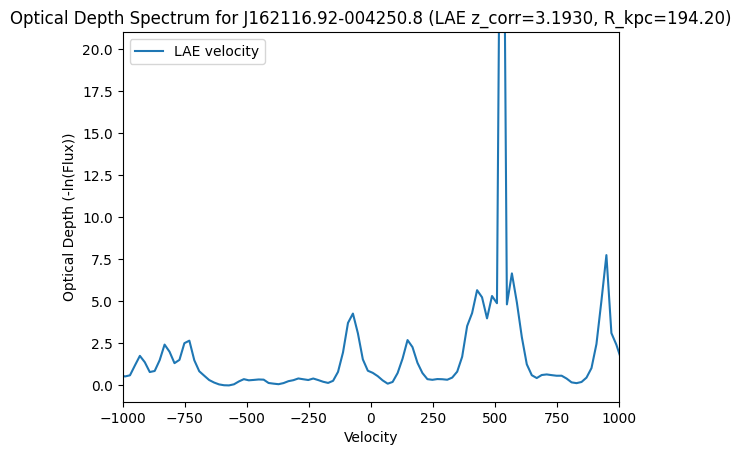

3.1991   | 6.3313 | 139.40


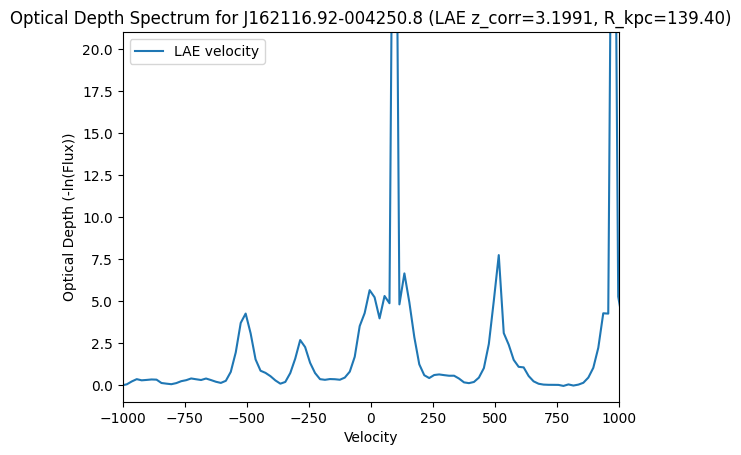

3.2025   | 6.3313 | 190.70


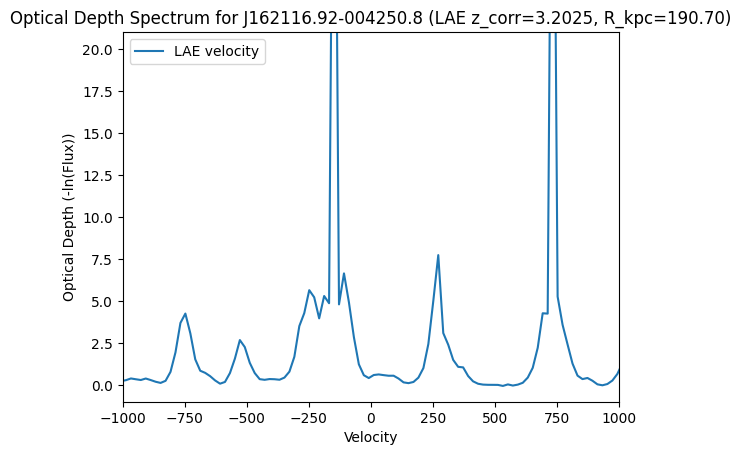

3.3775   | 6.3313 | 154.28


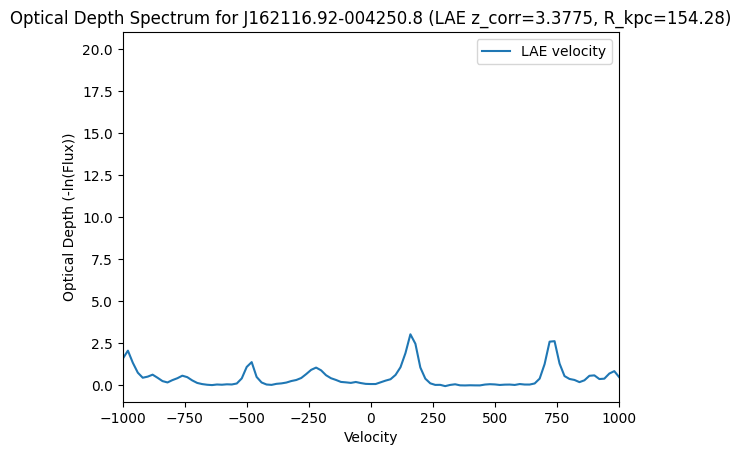

3.4524   | 6.3313 | 223.96


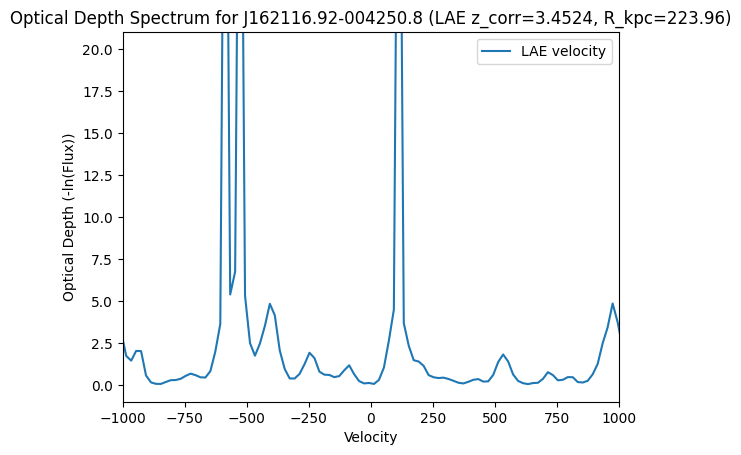

3.4860   | 6.3313 | 137.17


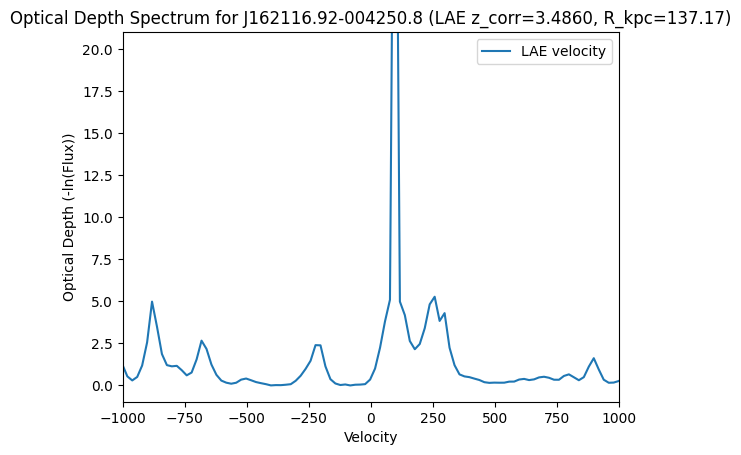

3.4971   | 6.3313 | 234.73


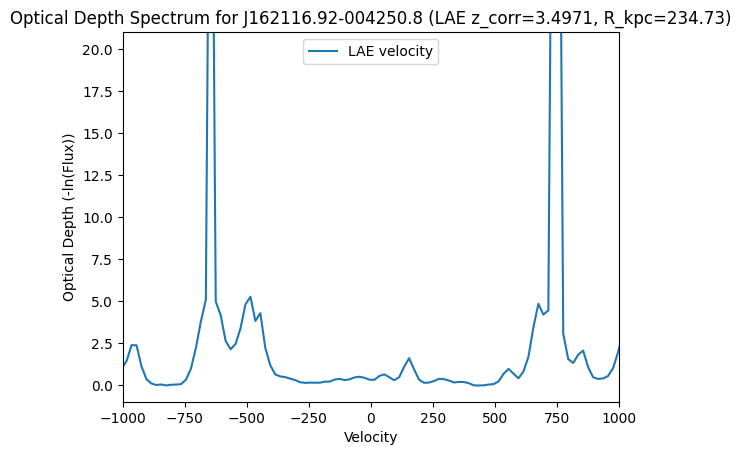


--- Quasar: J193957.25-100241.5 (z_QSO=3.7870) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.0056   | 6.3313 | 123.77


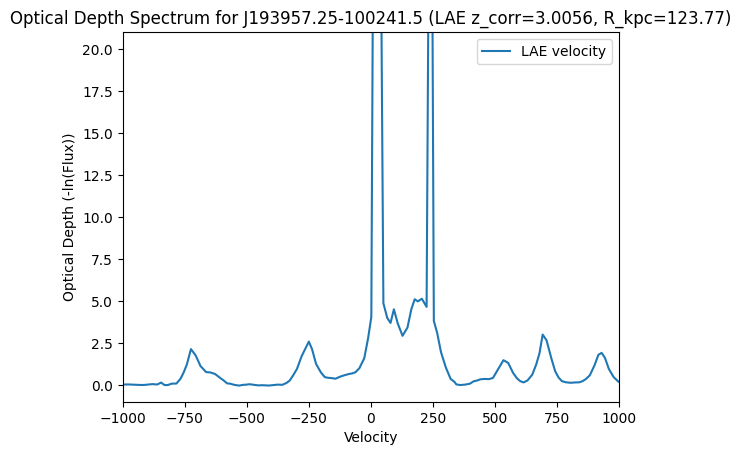

3.1363   | 6.3313 | 160.61


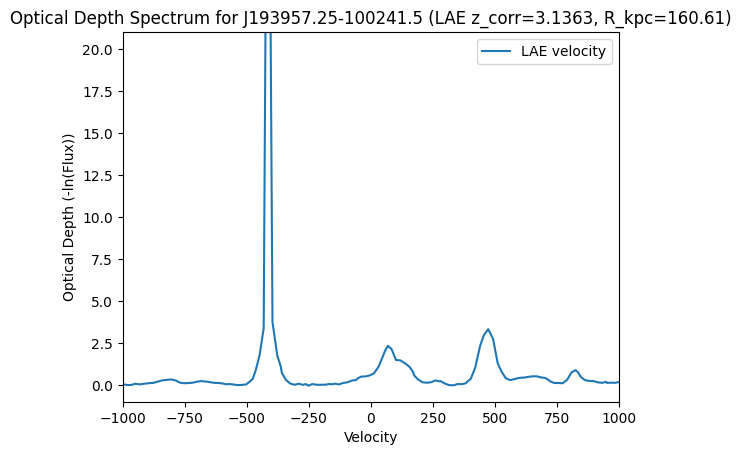

3.5522   | 6.3313 | 33.15


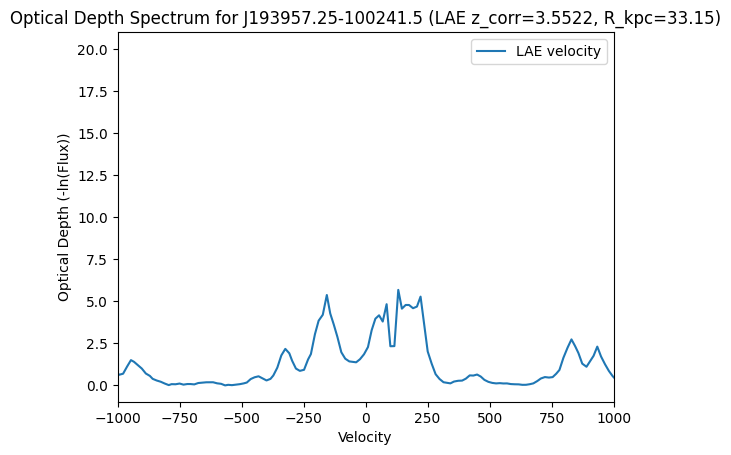


--- Quasar: J200324.14-325144.8 (z_QSO=3.7850) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
3.1899   | 6.3313 | 206.02


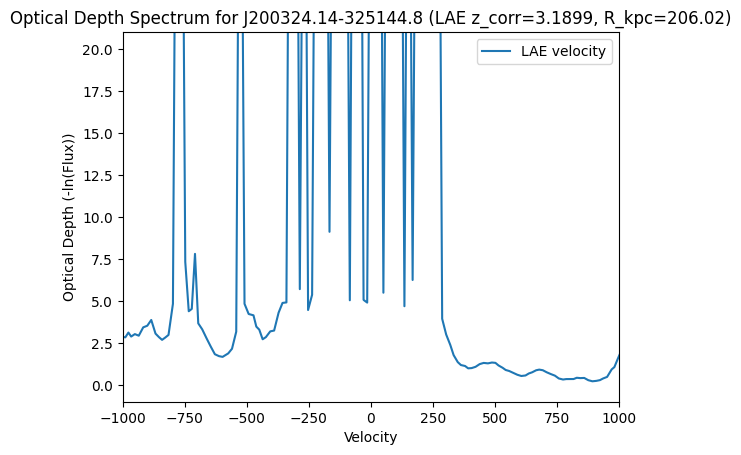

3.2326   | 6.3313 | 124.68


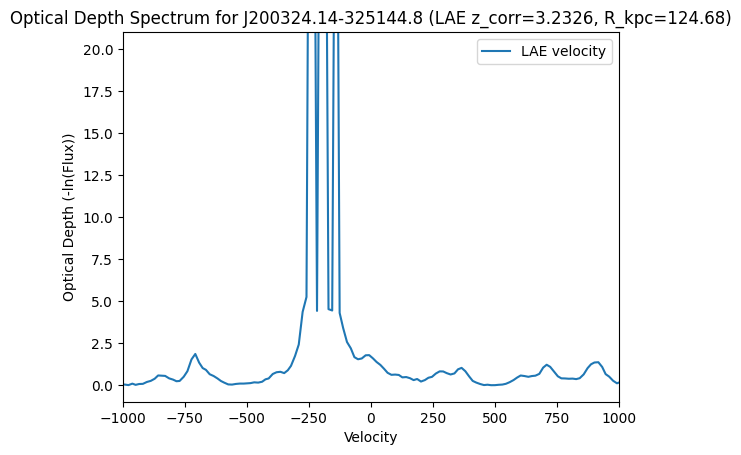

3.2496   | 6.3313 | 91.48


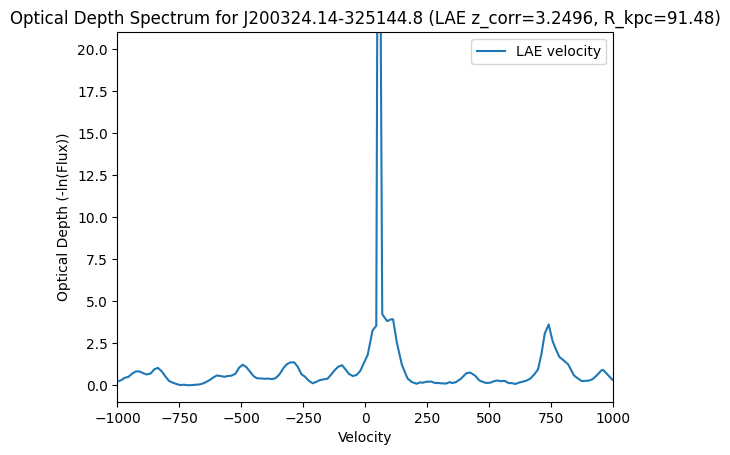

3.3016   | 6.3313 | 193.30


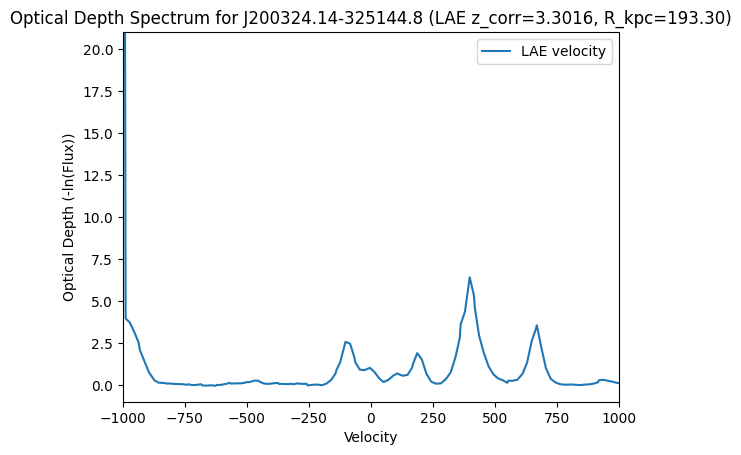

3.3354   | 6.3313 | 144.01


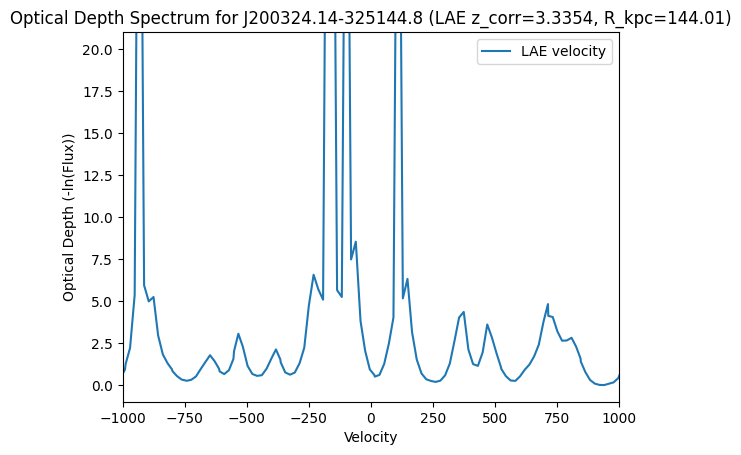

3.3353   | 6.3313 | 159.24


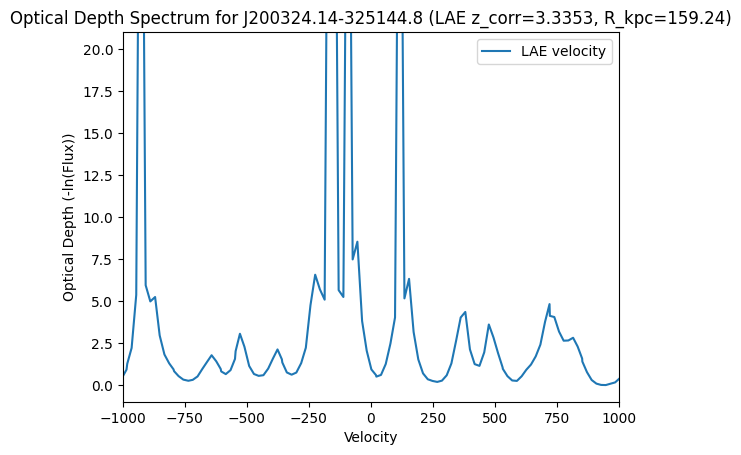

3.4451   | 6.3313 | 68.24


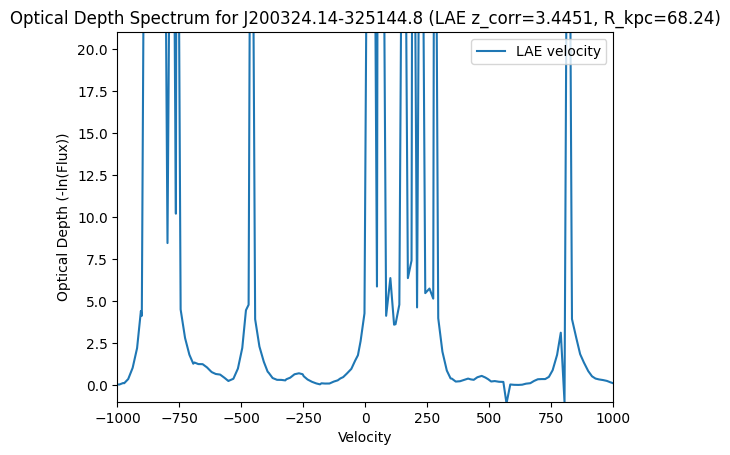

3.5499   | 6.3313 | 76.27


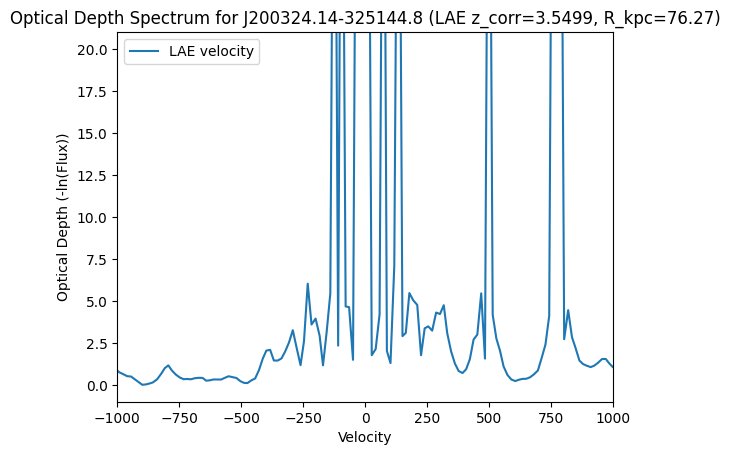

3.5506   | 6.3313 | 242.03


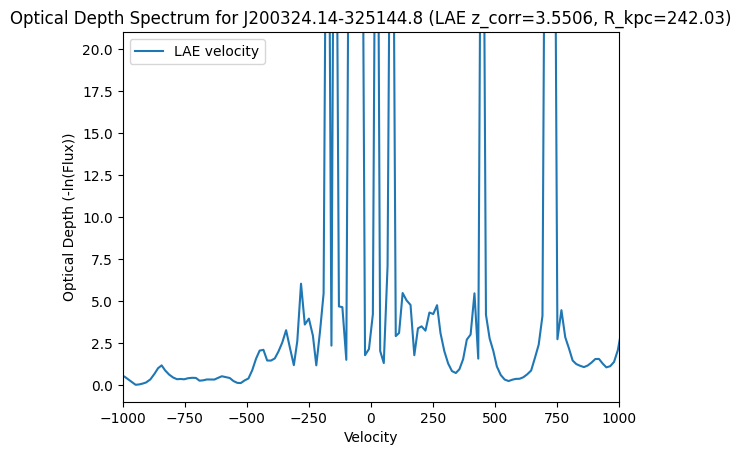

3.5542   | 6.3313 | 184.97


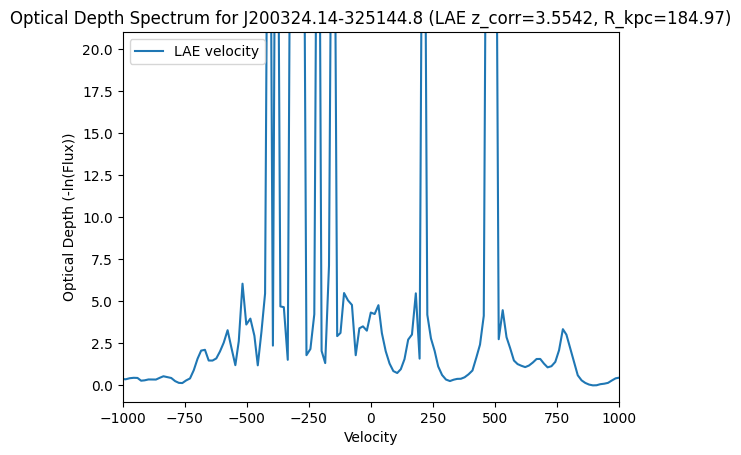

3.6179   | 6.3313 | 172.29


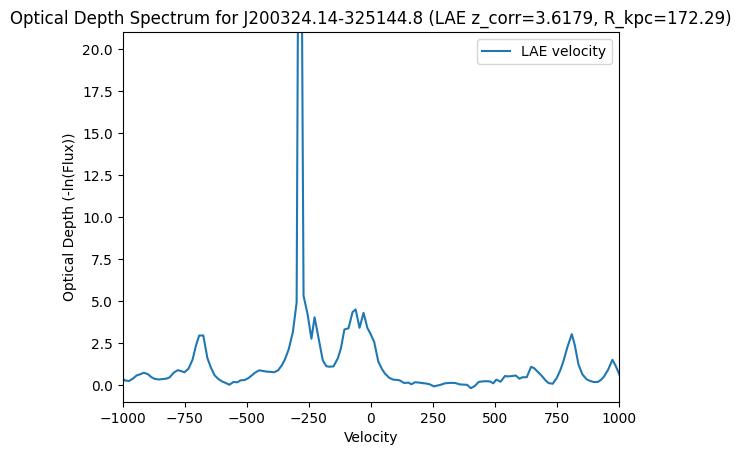

3.6351   | 6.3313 | 147.57


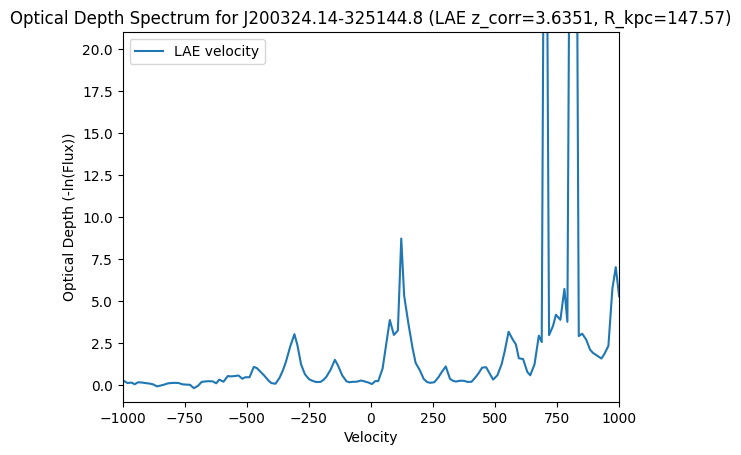

3.6417   | 6.3313 | 246.11


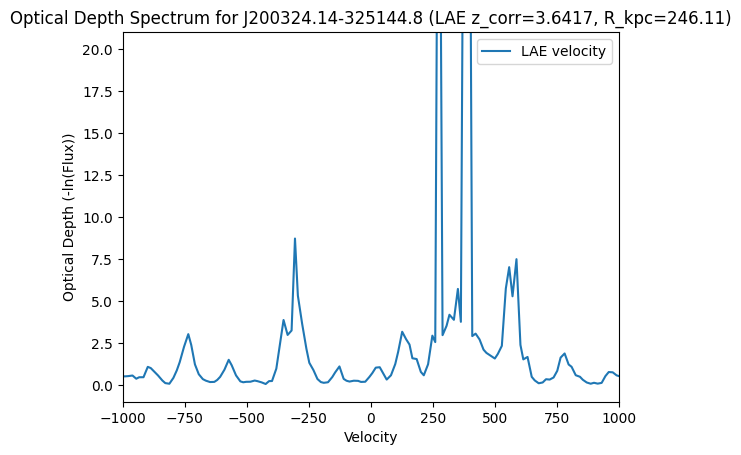

3.6683   | 6.3313 | 136.62


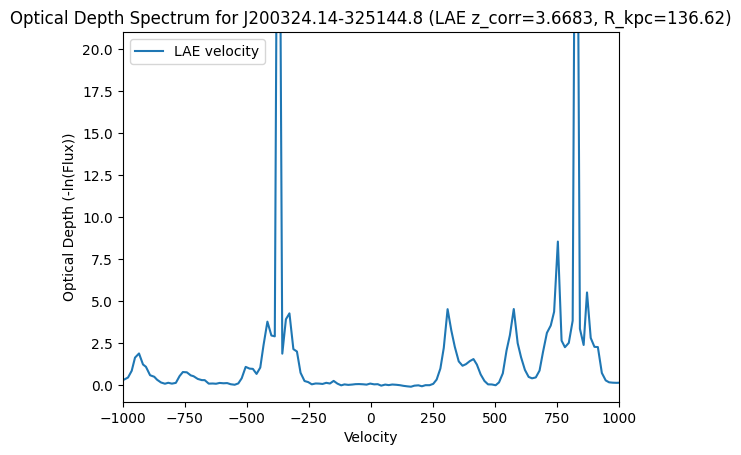

3.7157   | 6.3313 | 127.65


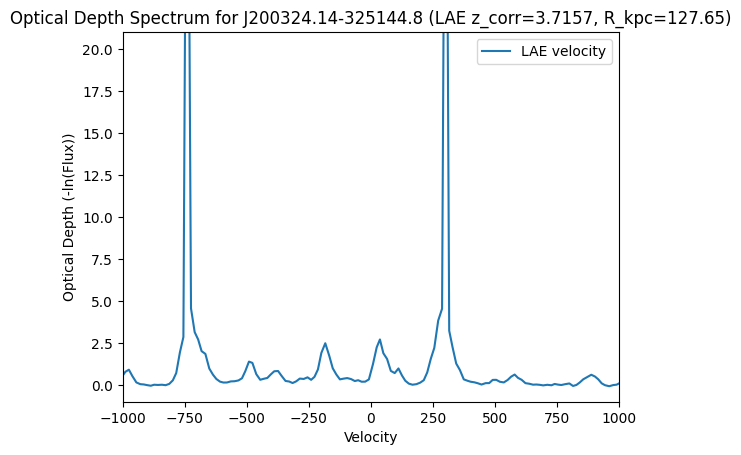


--- Quasar: J205344.72-354655.2 (z_QSO=3.4900) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9210   | No data in range | 175.15


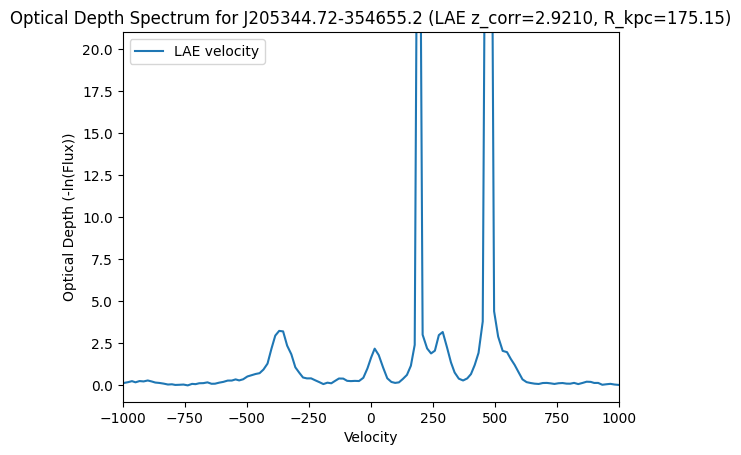

3.0355   | No data in range | 104.33


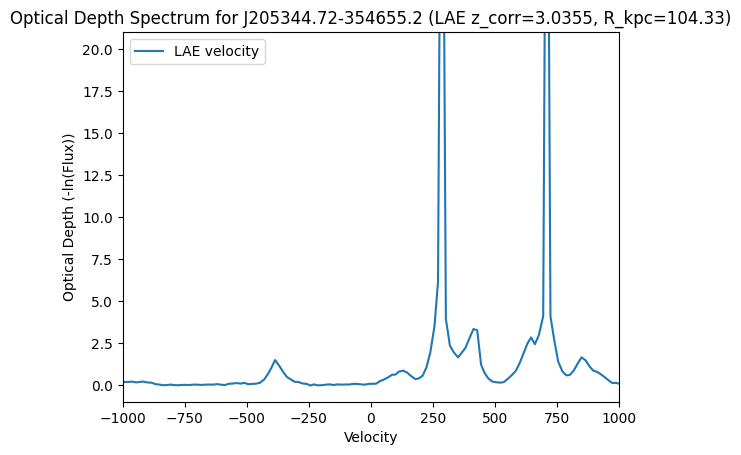

3.0445   | No data in range | 132.84


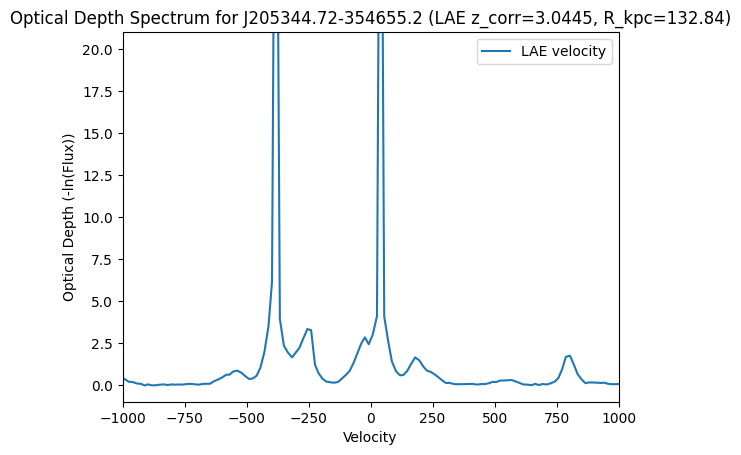

3.0856   | No data in range | 153.36


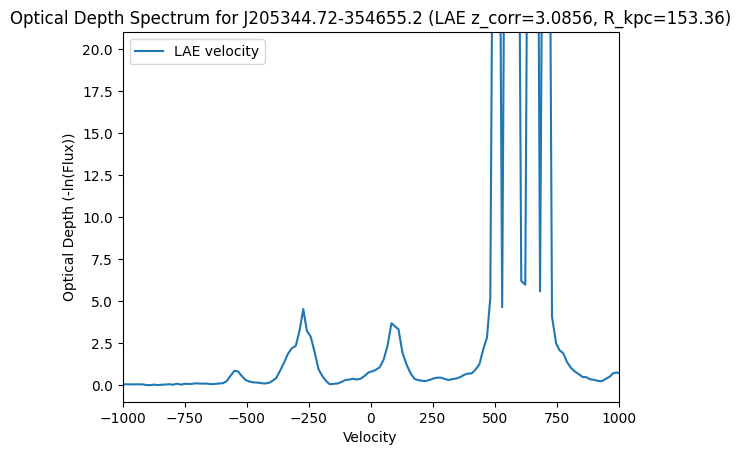

3.0938   | No data in range | 23.82


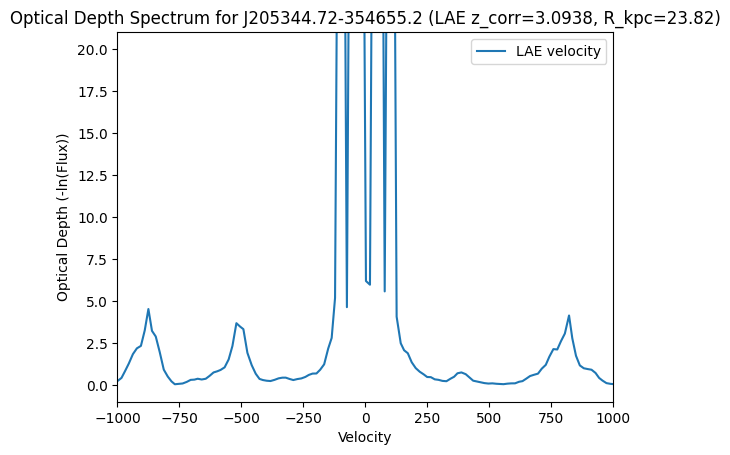

3.0932   | No data in range | 22.62


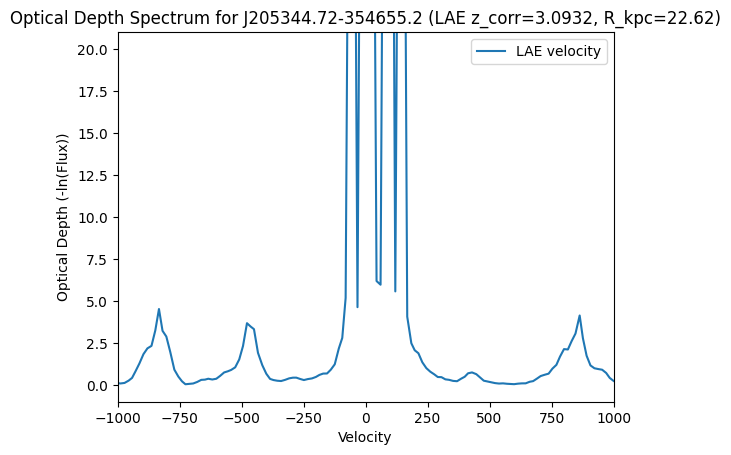

3.0935   | No data in range | 106.47


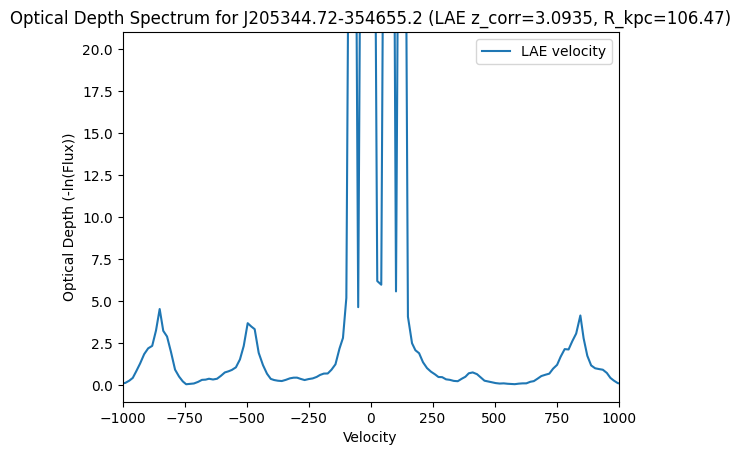

3.1406   | No data in range | 225.22


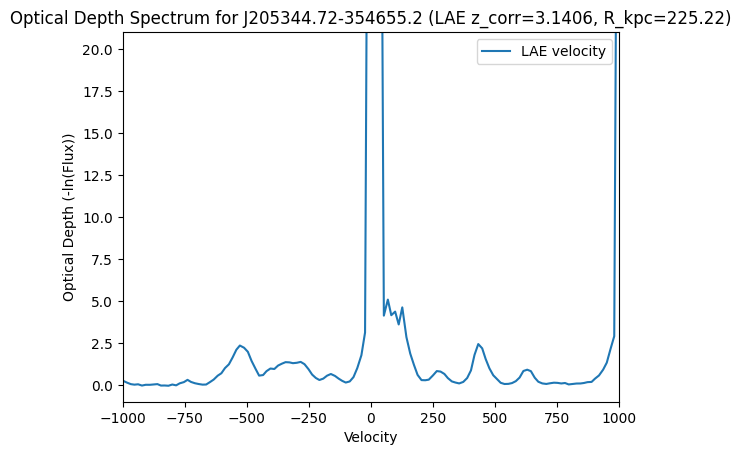

3.1543   | No data in range | 153.53


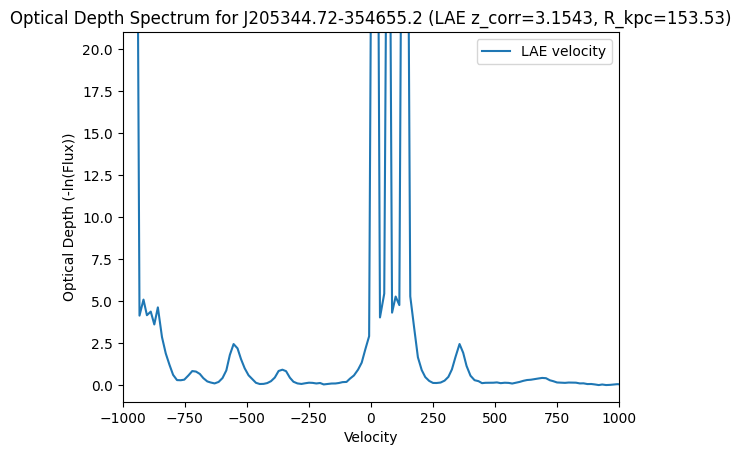

3.1579   | No data in range | 98.93


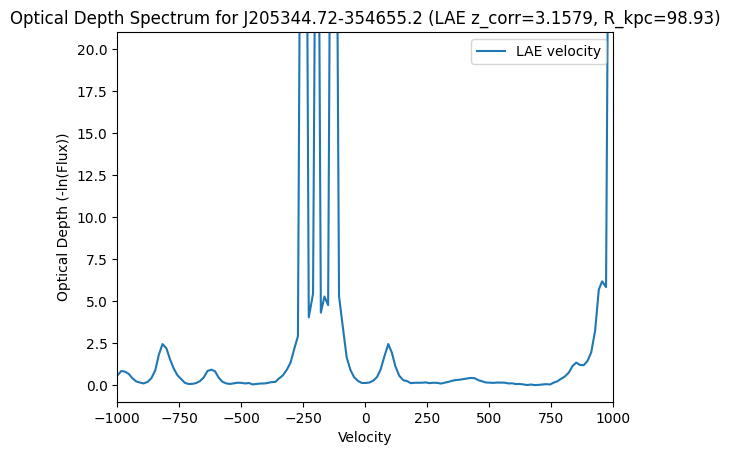

3.1733   | No data in range | 28.16


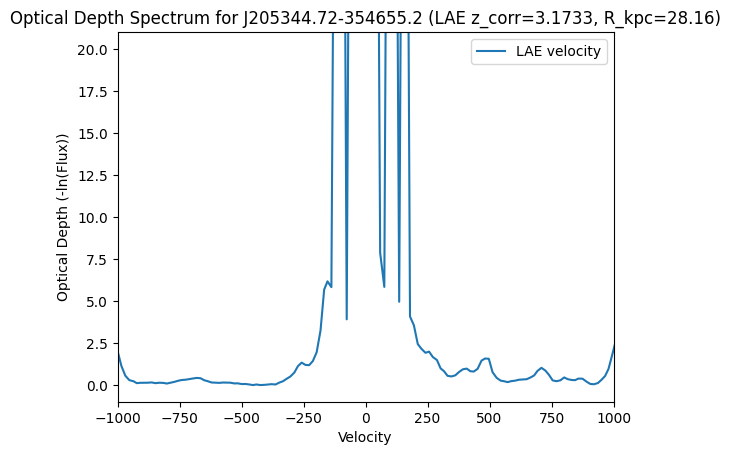

3.1756   | No data in range | 84.56


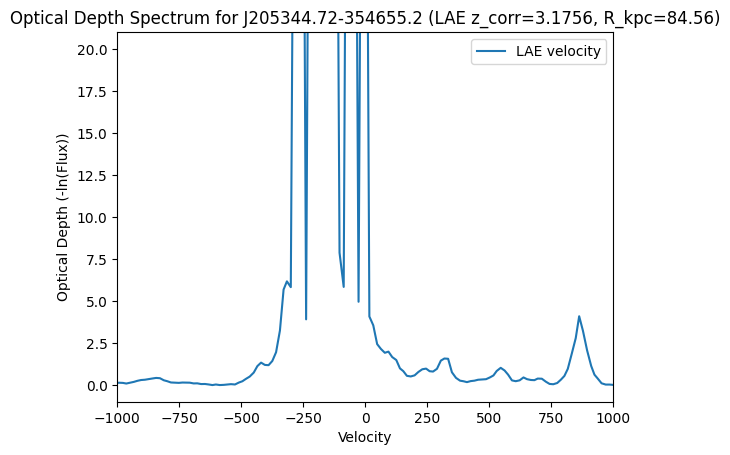

3.1737   | No data in range | 245.87


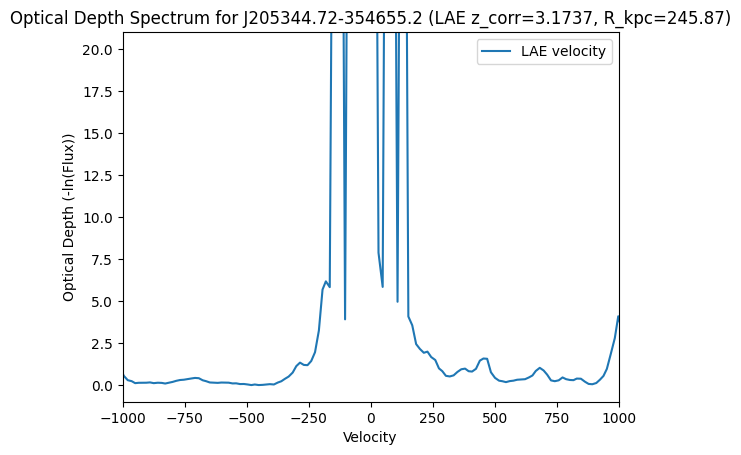

3.3972   | No data in range | 219.31


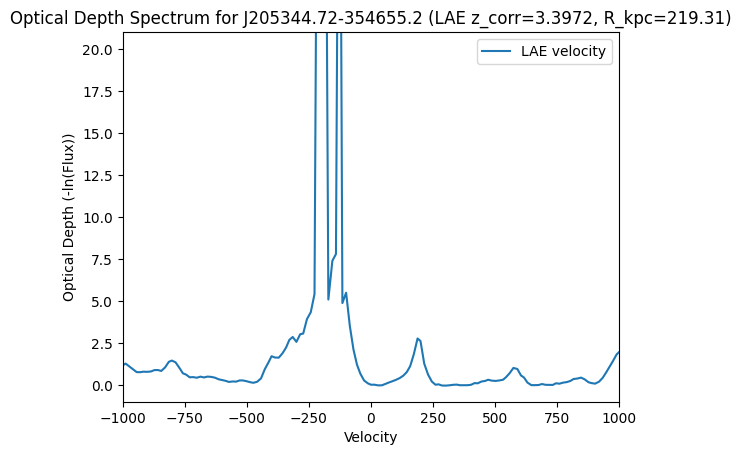


--- Quasar: J221527.29-161133.0 (z_QSO=4.0000) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9296   | 6.3313 | 203.52


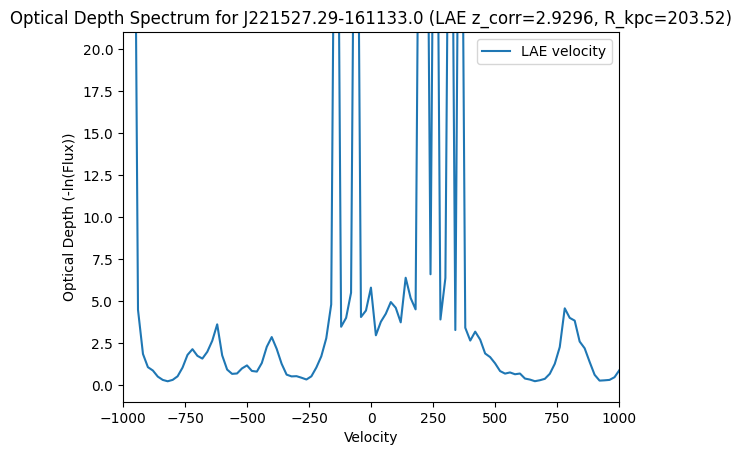

2.9402   | 6.3313 | 206.38


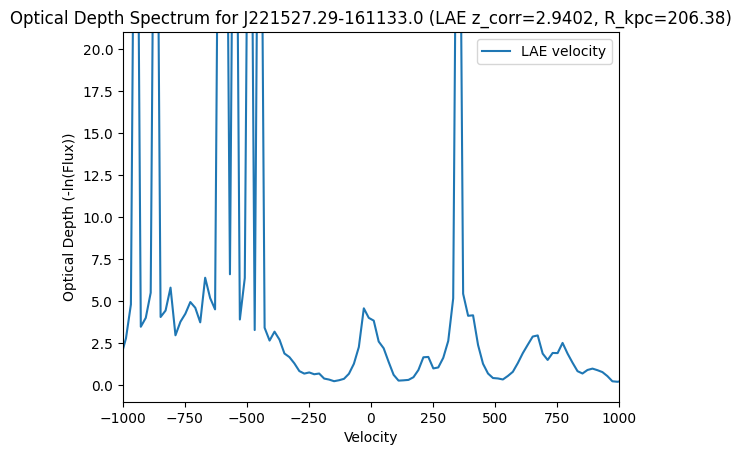

3.0519   | 6.3313 | 232.32


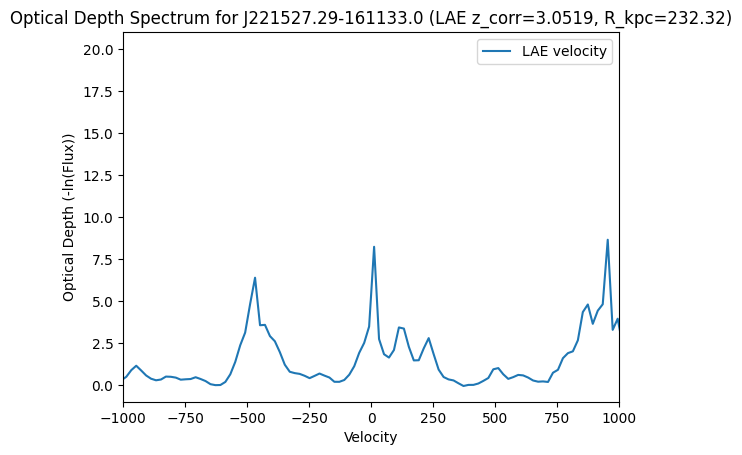

3.0625   | 6.3313 | 95.20


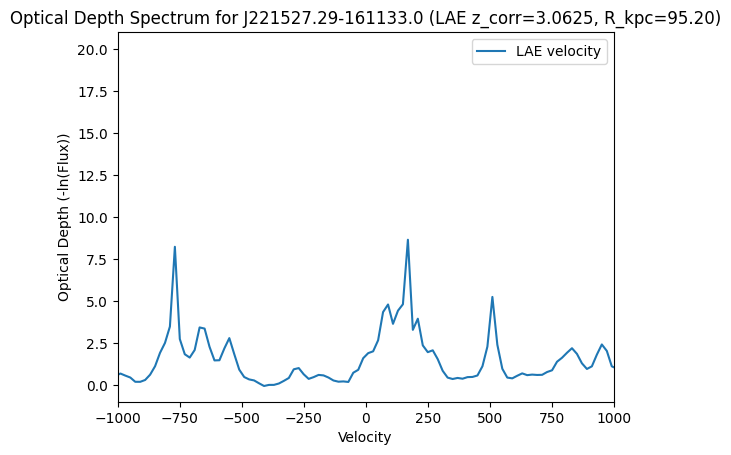

3.1290   | 6.3313 | 190.93


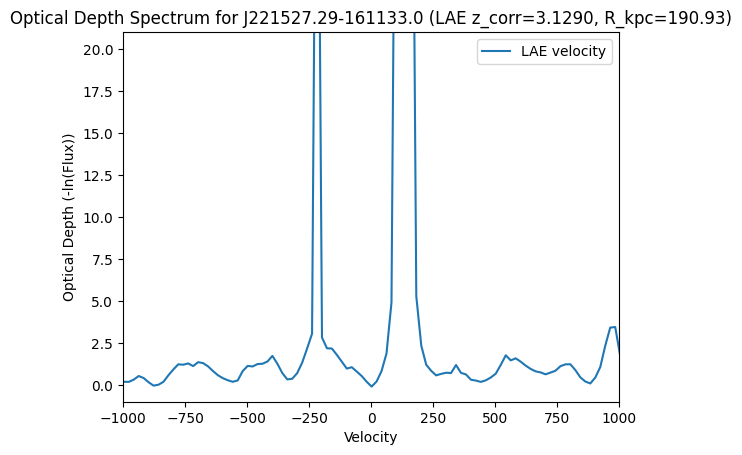

3.3029   | 6.3313 | 101.61


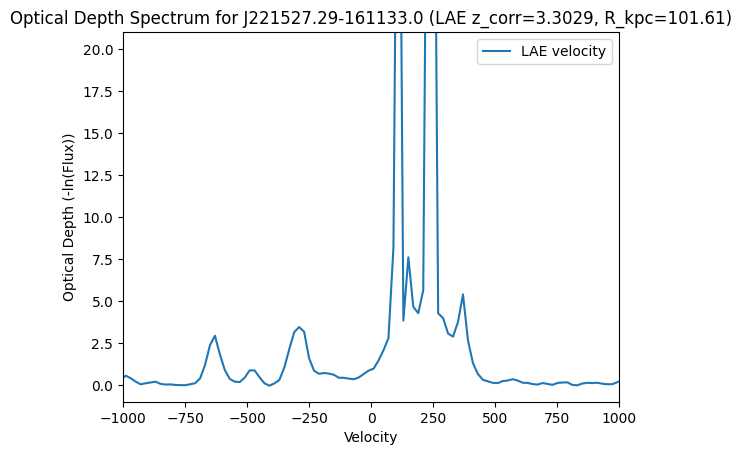

3.3016   | 6.3313 | 160.44


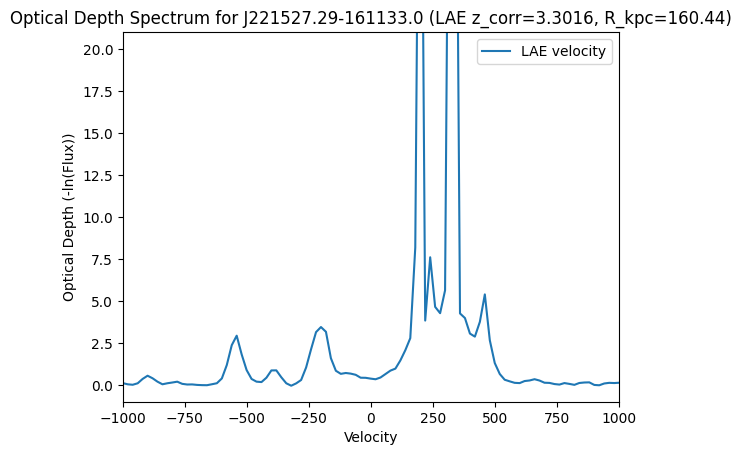

3.4104   | 6.3313 | 172.51


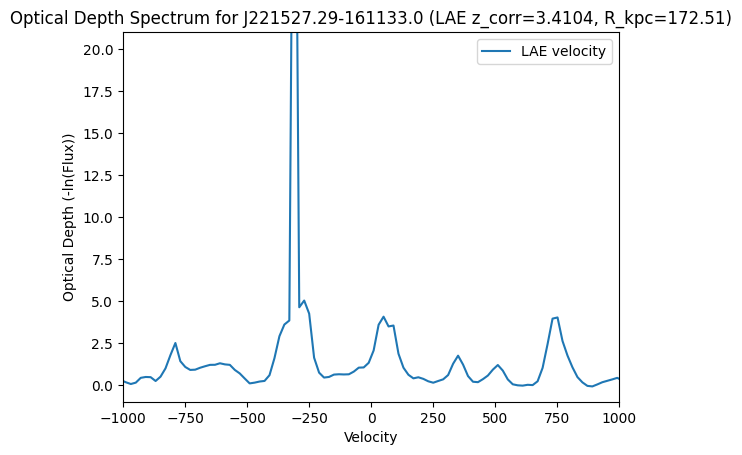

3.4599   | 6.3313 | 71.36


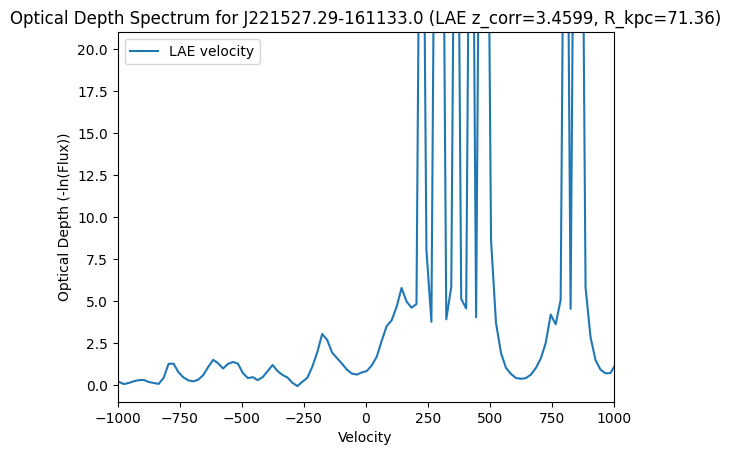

3.4648   | 6.3313 | 155.98


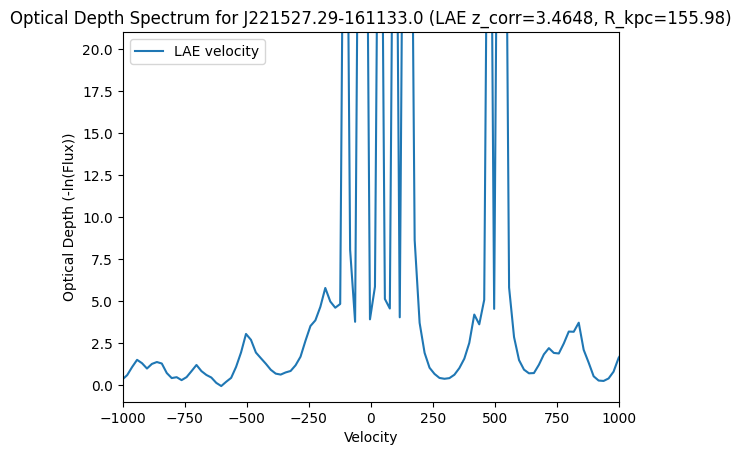

3.4705   | 6.3313 | 82.84


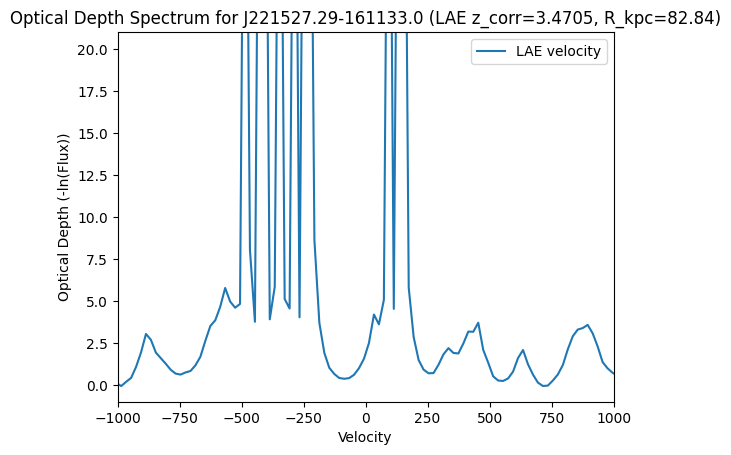


--- Quasar: J230301.45-093930.7 (z_QSO=3.4774) ---
LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc
---------------------------------------------------
2.9942   | No data in range | 152.29


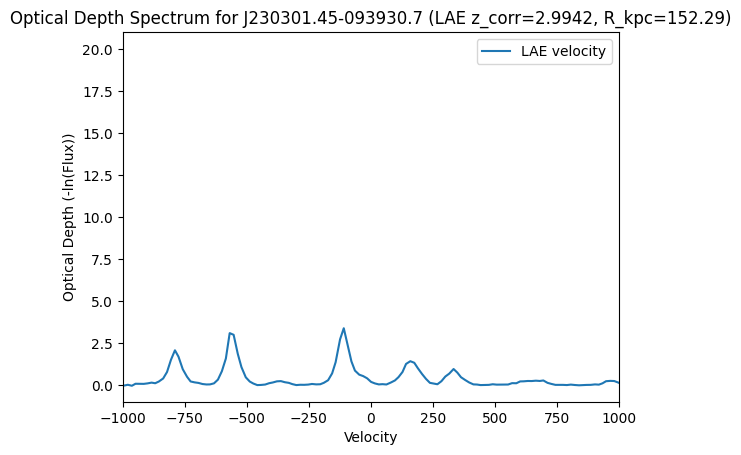

3.1021   | No data in range | 116.72


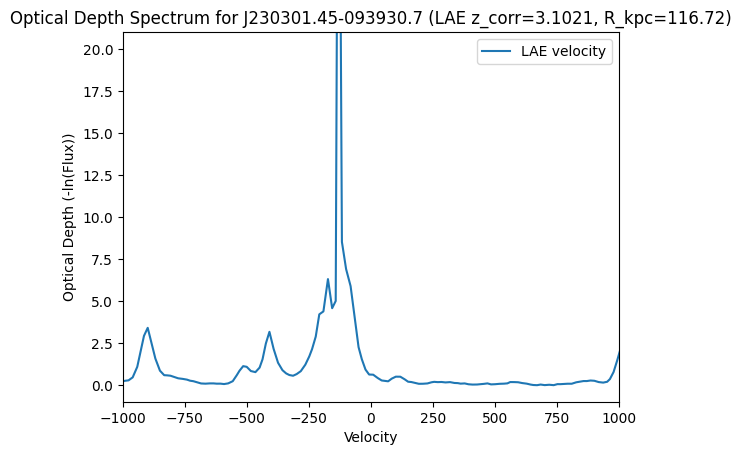

3.2467   | No data in range | 103.01


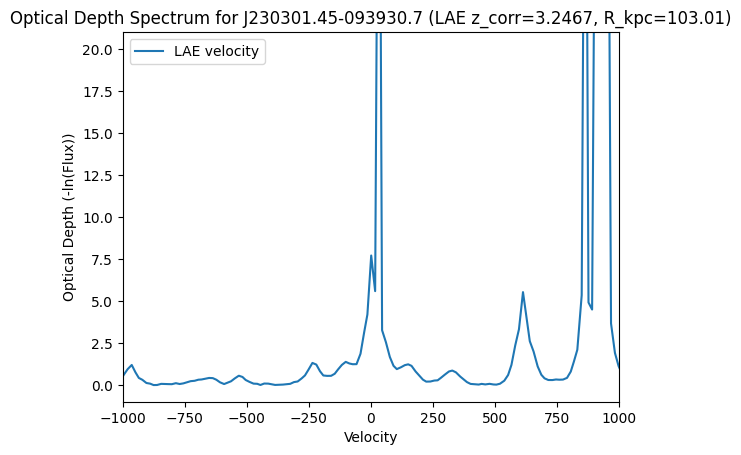

3.4094   | No data in range | 172.41


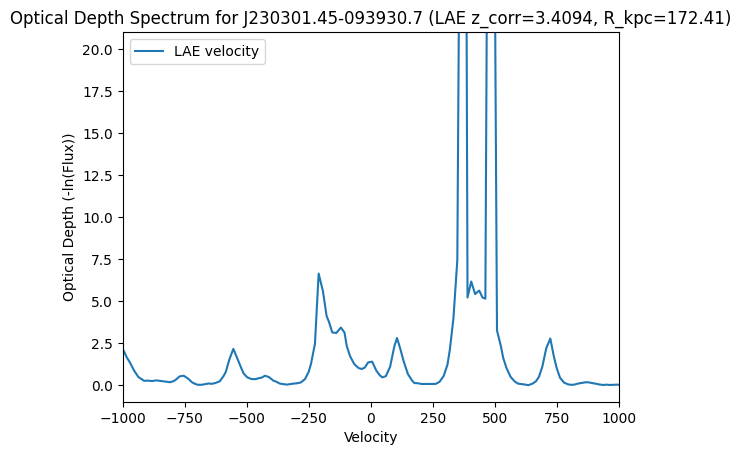

3.4135   | No data in range | 161.94


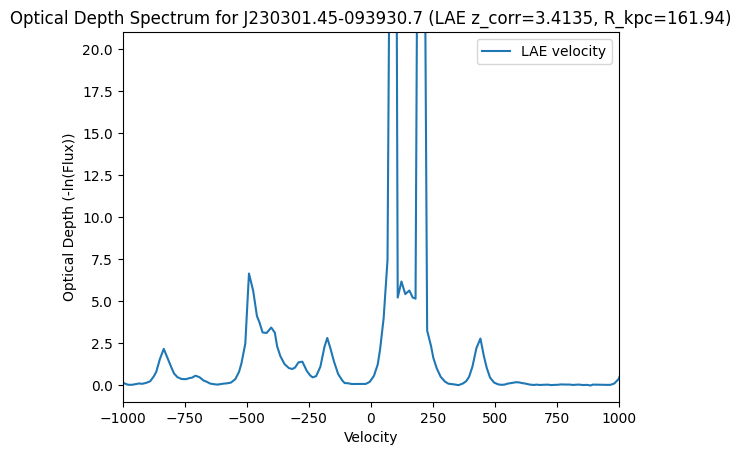

KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

In [21]:
lae_df['FIELD_str'] = lae_df['FIELD'].apply(lambda x: x.decode('utf-8'))
#BE CAREFUL TO RUN
for exx in range(1, num_qso + 1):
    # Retrieve redshift (z_QSO) for the current quasar
    z_qso = qsolist[exx].header['z_QSO']
    quasar_field = qsolist[exx].header['FIELD']

    # Calculate the Lyα cutoff wavelength
    lya_cutoff = 1215.67 * (1 + z_qso)

    # Convert lya_cutoff wavelength to redshift
    lya_cutoff_redshift = (lya_cutoff / 1215.67) - 1

    # Access 'wave' and 'flux' data
    wave_data = qsolist[exx].data['wave']
    flux_data = qsolist[exx].data['flux']

    # Create a boolean mask for wavelengths bluer than the cutoff
    mask_bluer = wave_data < lya_cutoff

    # Apply the mask to filter wave and flux data initially
    filtered_wave_pre = wave_data[mask_bluer]
    filtered_flux_pre = flux_data[mask_bluer]

    # Create a copy of filtered_flux_pre to modify
    modified_flux = np.copy(filtered_flux_pre)

    # Replace flux values <= 0 with 1e-20
    modified_flux[modified_flux <= 0] = 1e-20

    # Use these modified fluxes for calculation
    final_wave = filtered_wave_pre
    final_flux = modified_flux

    # Calculate optical depth (-ln(flux))
    # Ensure final_flux is not empty before attempting calculation
    if len(final_flux) > 0:
        optical_depth = -np.log(final_flux)

        # Convert filtered_wave to redshift for the x-axis
        redshift_x = (final_wave / 1215.67) - 1

        # Filter lae_df for galaxies corresponding to the current quasar's FIELD
        galaxies_in_field = lae_df[lae_df['FIELD_str'] == quasar_field]

        # Filter galaxies further to include only those within the redshift plotting range
        # and with z_corr less than lya_cutoff_redshift
        galaxies_in_field_filtered = galaxies_in_field[
            (galaxies_in_field['z_corr'] >= 2.8) &
            (galaxies_in_field['z_corr'] <= 3.8) &
            (galaxies_in_field['z_corr'] < lya_cutoff_redshift)
        ]

        # Print header for LAE optical depth calculations
        print(f"\n--- Quasar: {quasar_field} (z_QSO={z_qso:.4f}) ---")
        print("LAE z_corr | Mean Optical Depth (z +/- 0.05) | R_kpc")
        print("---------------------------------------------------")

        # Plot red 'x' markers for each filtered galaxy's redshift at y=10
        for i, galaxy in galaxies_in_field_filtered.iterrows():
            lae_z_corr = galaxy['z_corr']
            velocity = (3*10**5)*((redshift_x-lae_z_corr)/(lae_z_corr+1))
            r_kpc = galaxy['R_kpc']

            plt.figure() # Create a new figure for each LAE
            plt.plot(velocity, optical_depth, label='LAE velocity') # Only one label needed per plot

            # Calculate mean optical depth in a range of +-0.05 redshift around the LAE
            #redshift_min_lae = lae_z_corr - 0.05
            #redshift_max_lae = lae_z_corr + 0.05

            # Filter optical depth data for this LAE's redshift range
            mask_lae_redshift_range = (redshift_x >= redshift_min_lae) & (redshift_x <= redshift_max_lae)
            lae_optical_depth_segment = optical_depth[mask_lae_redshift_range]

            if len(lae_optical_depth_segment) > 0:
                #mean_tau = np.mean(lae_optical_depth_segment)
                print(f"{lae_z_corr:.4f}   | {mean_tau:.4f} | {r_kpc:.2f}")
            else:
                print(f"{lae_z_corr:.4f}   | No data in range | {r_kpc:.2f}")

            plt.ylim(-1, 21) # Set y-axis limits for optical depth
            plt.xlim(-1000, 1000) # Set x-axis limits for velocity
            plt.xlabel('Velocity')
            plt.ylabel('Optical Depth (-ln(Flux))')
            # Fix the title format: use specific LAE data, not the DataFrame
            plt.title(f"Optical Depth Spectrum for {quasar_field} (LAE z_corr={lae_z_corr:.4f}, R_kpc={r_kpc:.2f})")
            plt.legend()
            plt.show()
    else:
        print(f"No bluer wavelengths found for {quasar_field} after filtering. Skipping plot.")

[ 3.98175096e-01  2.86637947e-01  6.45224373e-01  5.39359849e-01
  2.30729060e-01  3.46794566e-01  3.72806090e-01  3.12197909e-01
  2.50243481e-01  1.52851418e-01 -5.28067740e-02 -8.88601627e-02
  1.08836959e-01  8.54363677e-02  1.56010543e-01  9.11490099e-02
  2.47123021e-01  1.36036970e-01 -5.63212669e-03  8.09389720e-02
  1.32430505e-01  2.97411077e-02  3.77185308e-03  1.07805398e-01
  1.38514543e-01  1.19599997e-01 -6.19558501e-02  9.15407131e-02
  2.44649769e-01  2.34960412e-01  2.31868192e-01  7.33811239e-02
  2.75940295e-02  1.47951560e-01  5.36500261e-02  1.40087687e-01
  1.60958618e-01  4.88003616e-01  5.00653216e-01  6.86803713e-01
  5.85606429e-01  3.22956838e-01  1.50179558e-01  2.08616772e-01
  6.34634182e-02  7.27974008e-02  2.72778872e-01  7.74712154e-02
 -2.40700649e-02  1.05443841e-02 -7.46805689e-04 -1.15752616e-01
 -3.72834495e-03  4.56196360e-02  8.21749363e-02  2.75142717e-01
  2.40781786e-01  4.67847504e-01  3.54526140e-01  4.65525109e-01
  5.80018825e-01  4.05125

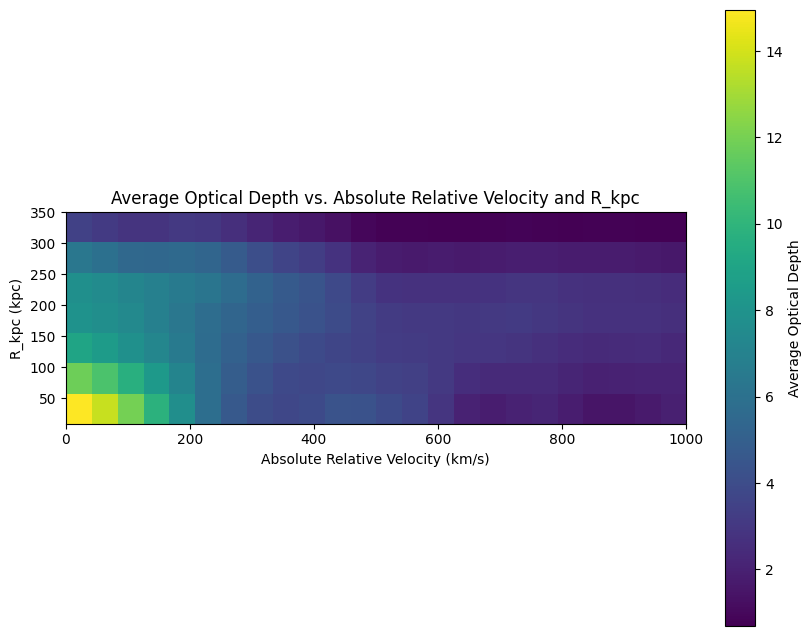

In [22]:
from scipy.ndimage import gaussian_filter
# Initialize lists to store data for the heatmap
all_r_kpc = []
all_abs_velocities = []
all_optical_depths = []

# Ensure lae_df is pre-processed with 'FIELD_str' as done in previous steps
lae_df['FIELD_str'] = lae_df['FIELD'].apply(lambda x: x.decode('utf-8'))

for exx in range(1, num_qso + 1):
    z_qso = qsolist[exx].header['z_QSO']
    quasar_field = qsolist[exx].header['FIELD']

    lya_cutoff = 1215.67 * (1 + z_qso)
    lya_cutoff_redshift = (lya_cutoff / 1215.67) - 1

    wave_data = qsolist[exx].data['wave']
    flux_data = qsolist[exx].data['flux']

    mask_bluer = wave_data < lya_cutoff
    filtered_wave_pre = wave_data[mask_bluer]
    filtered_flux_pre = flux_data[mask_bluer]

    modified_flux = np.copy(filtered_flux_pre)
    modified_flux[modified_flux <= 0] = 1e-20

    final_wave = filtered_wave_pre
    final_flux = modified_flux

    if len(final_flux) > 0:
        optical_depth = -np.log(final_flux)
        redshift_x = (final_wave / 1215.67) - 1

        galaxies_in_field = lae_df[lae_df['FIELD_str'] == quasar_field]
        galaxies_in_field_filtered = galaxies_in_field[
            (galaxies_in_field['z_corr'] >= 2.8) &
            (galaxies_in_field['z_corr'] <= 3.8) &
            (galaxies_in_field['z_corr'] < lya_cutoff_redshift)
        ]

        for _, galaxy in galaxies_in_field_filtered.iterrows():
            lae_z_corr = galaxy['z_corr']
            r_kpc = galaxy['R_kpc']

            # Define redshift window around the LAE for collecting data points
            redshift_min_lae = lae_z_corr - 0.05
            redshift_max_lae = lae_z_corr + 0.05

            # Filter quasar spectrum data within this LAE's redshift window
            mask_lae_redshift_range = (redshift_x >= redshift_min_lae) & (redshift_x <= redshift_max_lae)
            redshift_segment_x = redshift_x[mask_lae_redshift_range]
            lae_optical_depth_segment = optical_depth[mask_lae_redshift_range]

            if len(lae_optical_depth_segment) > 0:
                # Calculate relative velocity for each spectral point in the segment
                # Using the user's provided formula: velocity = 3*10**5*(asse_x-(lae_z_corr/(lae_z_corr+1)))
                # where asse_x is redshift_segment_x
                relative_velocities = 3 * 10**5 * ((redshift_segment_x -lae_z_corr) / (lae_z_corr + 1))

                abs_relative_velocities = np.abs(relative_velocities)

                # Filter for velocities up to 1000 km/s as requested for the x-axis range
                mask_velocity_range = abs_relative_velocities <= 1000
                filtered_abs_velocities = abs_relative_velocities[mask_velocity_range]
                filtered_optical_depths = lae_optical_depth_segment[mask_velocity_range]

                # Append data to global lists for heatmap
                all_abs_velocities.extend(filtered_abs_velocities)
                all_optical_depths.extend(filtered_optical_depths)
                # R_kpc is constant for this LAE, so extend by its length for each spectral point
                all_r_kpc.extend([r_kpc] * len(filtered_abs_velocities))
print(filtered_optical_depths)
# Convert to numpy arrays for easier manipulation
all_r_kpc = np.array(all_r_kpc)
all_abs_velocities = np.array(all_abs_velocities)
all_optical_depths = np.array(all_optical_depths)

# Create the 2D heatmap
plt.figure(figsize=(10, 8))

# Define bins for R_kpc and velocity
# Adjust binning as needed - using default 50 bins for now, but can be customized
r_kpc_bins = np.linspace(all_r_kpc.min() if all_r_kpc.size > 0 else 0, 350, 8) # Set max R_kpc to 400
velocity_bins = np.linspace(0, 1000, 25) # 0 to 1000 km/s

if all_abs_velocities.size > 0 and all_r_kpc.size > 0:
    # Use numpy.histogram2d to sum optical depths and count points in each bin
    sum_optical_depth, xedges, yedges = np.histogram2d(
        all_abs_velocities, all_r_kpc,
        bins=[velocity_bins, r_kpc_bins],
        weights=all_optical_depths
    )
    counts, _, _ = np.histogram2d(
        all_abs_velocities, all_r_kpc,
        bins=[velocity_bins, r_kpc_bins]
    )

    # Avoid division by zero
    # Only divide where counts are not zero to get the average optical depth
    average_optical_depth = np.divide(sum_optical_depth, counts, out=np.zeros_like(sum_optical_depth), where=counts!=0)
    smoothed_optical_depth = gaussian_filter(average_optical_depth, sigma=1)
    # Plotting the heatmap
    plt.imshow(smoothed_optical_depth.T, origin='lower',
               extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]],
               aspect='equal', cmap='viridis') # Using .T because imshow expects (rows, cols) and histogram2d returns (x_bins, y_bins)

    plt.colorbar(label='Average Optical Depth')
    plt.xlabel('Absolute Relative Velocity (km/s)')
    plt.ylabel('R_kpc (kpc)')
    plt.title('Average Optical Depth vs. Absolute Relative Velocity and R_kpc')
    plt.show()
else:
    print("No data available to generate the heatmap after all filtering steps.")

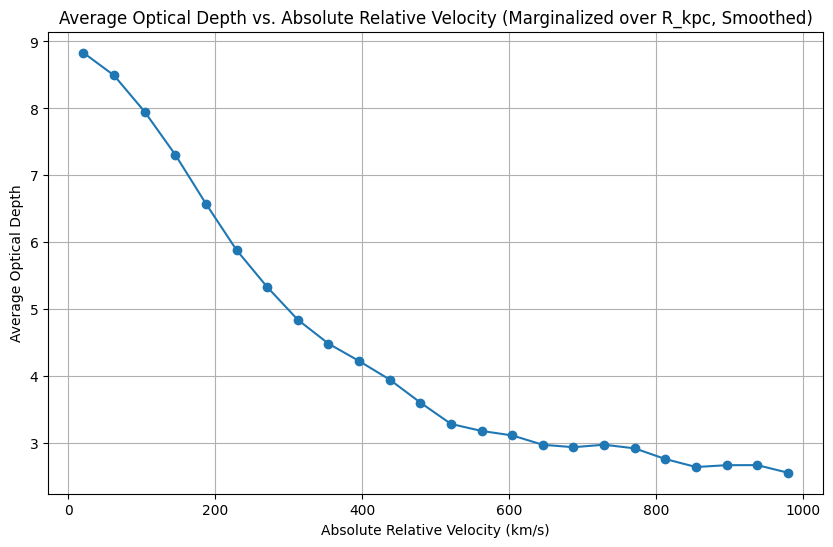

In [23]:
from scipy.stats import binned_statistic
from scipy.ndimage import gaussian_filter # Import gaussian_filter

# 1. Define velocity bins for the x-axis
velocity_bins_1d = np.linspace(0, 1000, 25)

# 2. Use binned_statistic to calculate the mean all_optical_depths for each velocity bin
mean_optical_depth_1d_raw, bin_edges, binnumber = binned_statistic(
    all_abs_velocities,
    all_optical_depths,
    statistic='mean',
    bins=velocity_bins_1d
)

# Apply Gaussian smoothing to the binned mean optical depth
mean_optical_depth_1d_smoothed = gaussian_filter(mean_optical_depth_1d_raw, sigma=1)

# 3. Calculate the center of each velocity bin
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# 4. Create a 1D plot
plt.figure(figsize=(10, 6))
plt.plot(bin_centers, mean_optical_depth_1d_smoothed, marker='o', linestyle='-')

# 5. Add appropriate labels and title
plt.xlabel('Absolute Relative Velocity (km/s)')
plt.ylabel('Average Optical Depth')
plt.title('Average Optical Depth vs. Absolute Relative Velocity (Marginalized over R_kpc, Smoothed)')
plt.grid(True)

# 6. Display the plot
plt.show()

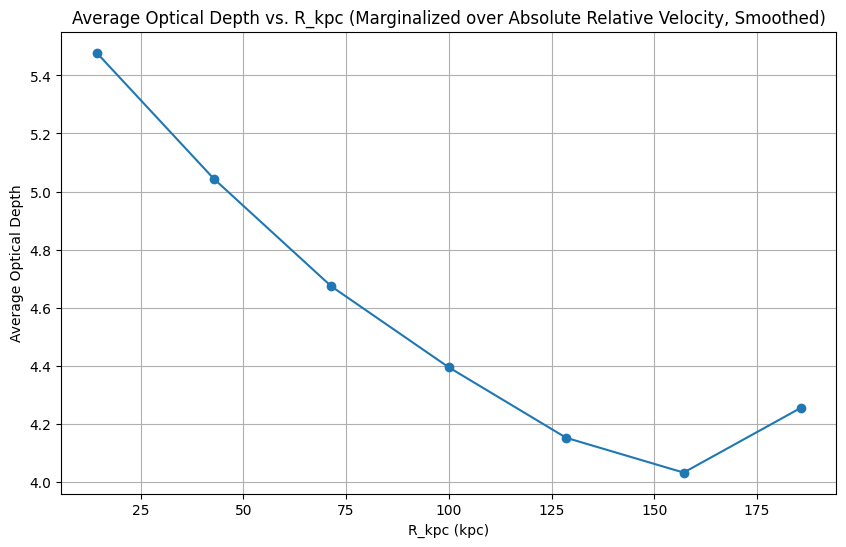

In [24]:
from scipy.stats import binned_statistic
from scipy.ndimage import gaussian_filter # Import gaussian_filter

# 1. Define R_kpc bins for the x-axis
R_kpc_bins_1d = np.linspace(0, 400, 15) # R_kpc from 0 to 400 kpc

# 2. Use binned_statistic to calculate the mean all_optical_depths for each R_kpc bin
mean_optical_depth_r_kpc_1d_raw, bin_edges_r_kpc, binnumber_r_kpc = binned_statistic(
    all_r_kpc,
    all_optical_depths,
    statistic='mean',
    bins=R_kpc_bins_1d
)

# Apply Gaussian smoothing to the binned mean optical depth
mean_optical_depth_r_kpc_1d_smoothed = gaussian_filter(mean_optical_depth_r_kpc_1d_raw, sigma=1)

# 3. Calculate the center of each R_kpc bin
bin_centers_r_kpc = (bin_edges_r_kpc[:-1] + bin_edges_r_kpc[1:]) / 2

# 4. Create a 1D plot
plt.figure(figsize=(10, 6))
plt.plot(bin_centers_r_kpc, mean_optical_depth_r_kpc_1d_smoothed, marker='o', linestyle='-')

# 5. Add appropriate labels and title
plt.xlabel('R_kpc (kpc)')
plt.ylabel('Average Optical Depth')
plt.title('Average Optical Depth vs. R_kpc (Marginalized over Absolute Relative Velocity, Smoothed)')
plt.grid(True)

# 6. Display the plot
plt.show()